# scRNASeq, CITE-Seq, scBCR-Seq pipeline analysis using scanpy
This scRNA-Seq pipeline is adapted from the pipeline here https://github.com/theislab/single-cell-tutorial. Focusing more on technical details of each step. <br/>

## Prepare pipeline environment
To run this pipline, we recommend to use the docker contianer (https://hub.docker.com/r/leanderd/single-cell-analysis) built by the scanpy developer. That page describes how to run the pipeline using docker. If you are using HPC, then it's recommended to run this pipeline using singularity. You can download the docker image using singularity with the command: <br/> 
> **singularity pull docker://leanderd/single-cell-analysis**. <br/>

Singularity image file is not writable, you can transfer it to a sandbox and then you will be able to install packages inside it without administrator role. The commands are:
> singularity build --sandbox sc_pipeline/ single-cell-analysis.sif <br/>
> singularity run -w sc_pipeline jupyter-lab --no-browser --port 8887

In the end, you can open jupyter-lab by copying and pasting the url shown in terminal.

# Project Summary
This project use MACS to enrich IgA+ B cells from 2 patients with IgAN and also include 2 age/sex matched control samples. Each patient/control pair was separately hash tagged, then combined for totalseq+scRNAseq+BCRseq. Each IgAN/control pair have done two replicates, so we have 4 datasets after the run.

# 0. Load the packages

In [1]:
import scanpy as sc
import scanpy.external as sce
import numpy as np
import scipy as sp
import pandas as pd
import matplotlib
import matplotlib.pyplot as plt
from matplotlib import rcParams
from matplotlib import colors
import seaborn as sb
sc.set_figure_params(dpi=100, figsize=(8,8))
plt.style.use('ggplot')
import muon as mu
from muon import prot as pt
from gprofiler import GProfiler
import rpy2.rinterface_lib.callbacks
from rpy2.robjects import pandas2ri
import anndata2ri
import scirpy as ir
from cycler import cycler
import anndata
import seaborn as sns

from functools import reduce
import logging
import gseapy as gp
import glob
import os
import sys
import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)
warnings.simplefilter(action='ignore', category=UserWarning)
sys.path.insert(1, os.path.join(sys.path[0], '..'))

/usr/local/lib/python3.10/dist-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [2]:
import importlib
import scanpy_utils.scanpy_utils as sctool
importlib.reload(sctool)

<module 'scanpy_utils.scanpy_utils' from '/media/hpc/grid/wip_drm_targetsciences/users/erguna02/MIGIS/github/scRNASeq_spatial/scRNASeq_pipeline/projects/../scanpy_utils/scanpy_utils.py'>

In [3]:
# Ignore R warning messages
#Note: this can be commented out to get more verbose R output
rpy2.rinterface_lib.callbacks.logger.setLevel(logging.ERROR)

# Automatically convert rpy2 outputs to pandas dataframes
pandas2ri.activate()
anndata2ri.activate()
%load_ext rpy2.ipython

sc.set_figure_params(dpi=90)
plt.rcParams['figure.figsize']=(6,6) #rescale figures
sc.settings.verbosity = 3
sc.logging.print_versions()
plt.style.use('ggplot')

-----
anndata     0.8.0
scanpy      1.9.3
-----
Levenshtein                 0.21.0
PIL                         9.5.0
adjustText                  0.8
airr                        1.4.1
anndata2ri                  1.1
anyio                       NA
arrow                       1.2.3
asciitree                   NA
asttokens                   NA
attr                        23.1.0
babel                       2.12.1
backcall                    0.2.0
bioinfokit                  2.1.0
certifi                     2023.05.07
cffi                        1.15.1
charset_normalizer          3.1.0
cloudpickle                 2.2.1
comm                        0.1.3
cycler                      0.10.0
cython_runtime              NA
dask                        2023.5.1
dateutil                    2.8.2
debugpy                     1.6.7
decorator                   5.1.1
defusedxml                  0.7.1
entrypoints                 0.4
executing                   1.2.0
fasteners                   0.18
fastjs

In [4]:
%%R
# Load libraries from correct lib Paths for my environment - ignore this!
.libPaths(.libPaths()[c(3,2,1)])

# Load all the R libraries we will be using in the notebook
library(scran)
library(RColorBrewer)
library(slingshot)
library(monocle)
library(gam)
library(clusterExperiment)
library(ggplot2)
library(plyr)
library(MAST)

# scRNASeq part
# 1. Read in the data
For 10X genomics data, it has 3 files for each sample, 10X genomics has two version of files. </br>

For version 2, please make sure the files are unzipped and file names end with **_matrix.mtx, _barcodes.tsv.gz, _genes.tsv**. </br>
For version 3, please make sure the files are gzipped and file names end with **_matrix.mtx.gz, _barcodes.tsv.gz, _features.tsv.gz**. </br>

There two ways of putting files in the folder and you need to define a parameter called **file_tree**: <br/>
1. Put all the files from different samples in the same folder, in this case just make sure the files end with the ones mentioned above.
2. Each sample's files are put in a spearate folder, in this case you need to make sure the file names are exactly **matrix.mtx, barcodes.tsv, genes.tsv** or **matrix.mtx.gz, barcodes.tsv.gz, genes.tsv.gz** </br>

If file is in h5 format, please put all h5 files in one folder and use sctool.read_1-x_h5_files to read files

In [5]:
work_dir = '/media/hpc/grid/wip_drm_targetsciences/projects/p062_MIGIS_IGAN/data_2nd_batch2'
h5_fns = glob.glob(f'{work_dir}/raw_h5/*.h5')
cc_genes_file = '/media/hpc/grid/wip_drm_targetsciences/projects/p062_MIGIS_IGAN/Macosko_cell_cycle_genes.txt'

In [6]:
# read in data
adata = sctool.read_10x_h5_files(h5_fns)

reading /media/hpc/grid/wip_drm_targetsciences/projects/p062_MIGIS_IGAN/data_2nd_batch2/raw_h5/B2.h5
 (0:00:00)
reading /media/hpc/grid/wip_drm_targetsciences/projects/p062_MIGIS_IGAN/data_2nd_batch2/raw_h5/A2.h5
 (0:00:00)
reading /media/hpc/grid/wip_drm_targetsciences/projects/p062_MIGIS_IGAN/data_2nd_batch2/raw_h5/A1.h5
 (0:00:00)


In [7]:
adata.var['feature_types'].value_counts()

Gene Expression     58302
Antibody Capture      139
Name: feature_types, dtype: int64

In [8]:
print(adata.obs['sample'].value_counts())

A1    11547
A2    11190
B2    10269
Name: sample, dtype: int64


In [9]:
adata

AnnData object with n_obs × n_vars = 33006 × 58441
    obs: 'sample'
    var: 'gene_ids', 'feature_types', 'genome'

In [10]:
adata.var.query('feature_types == "Gene Expression"').index

Index(['DDX11L1', 'WASH7P', 'MIR6859-1', 'MIR1302-2HG', 'MIR1302-2', 'FAM138A',
       'OR4G4P', 'OR4G11P', 'OR4F5', 'AL627309.1',
       ...
       'H19_1-1', 'H19_2-1', 'H19_3-1', 'AC233755.2', 'AC233755.1',
       'AC240274.1', 'U1-14', 'U1-15', 'AC213203.1', 'FAM231D'],
      dtype='object', length=58302)

In [59]:
gex_adata = adata[:,adata.var.query('feature_types == "Gene Expression"').index]
sc.pp.calculate_qc_metrics(gex_adata,inplace=True)

In [12]:
gex_adata

AnnData object with n_obs × n_vars = 33006 × 58302
    obs: 'sample', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts'

In [60]:
median(gex_adata.obs.n_genes_by_counts)

1283.0

# 2. Preprocessing
## 2.1 QC
Plot distribution of gene_number, read_count, mitochondria percentage.
Sample quality plots of n_counts and mt_frac. Typical plots are: <br/>
* violin plots to show the n_counts, mt_frac, scatter plot 
* scatter plots of n_genes VS n_counts colored by mt_frac
* histogram showing distribution of n_genes and n_counts <br/>

If you want to change figuer size run: **plt.rcParams['figure.figsize']=(7,5)**.

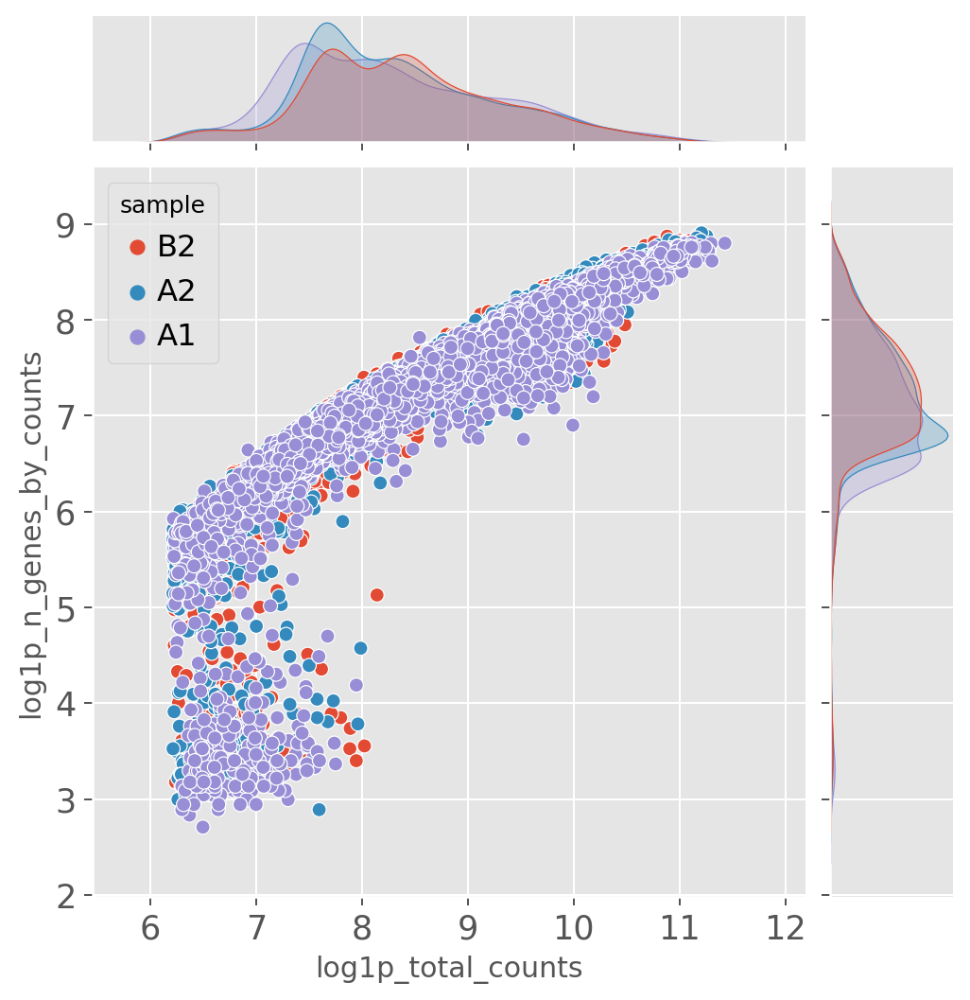

In [61]:
sns.jointplot(
    data=gex_adata.obs,
    x="log1p_total_counts",
    y="log1p_n_genes_by_counts",hue="sample"
)

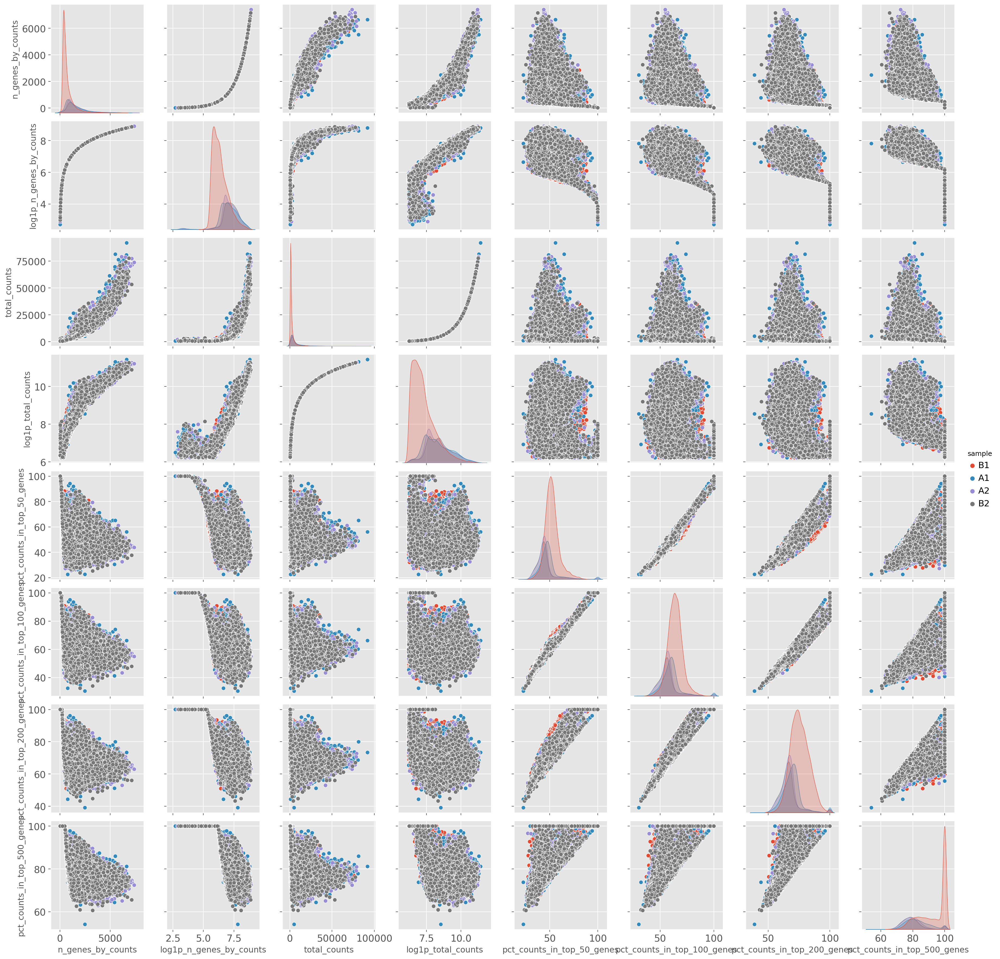

In [19]:
sns.pairplot(data=gex_adata.obs, hue="sample")

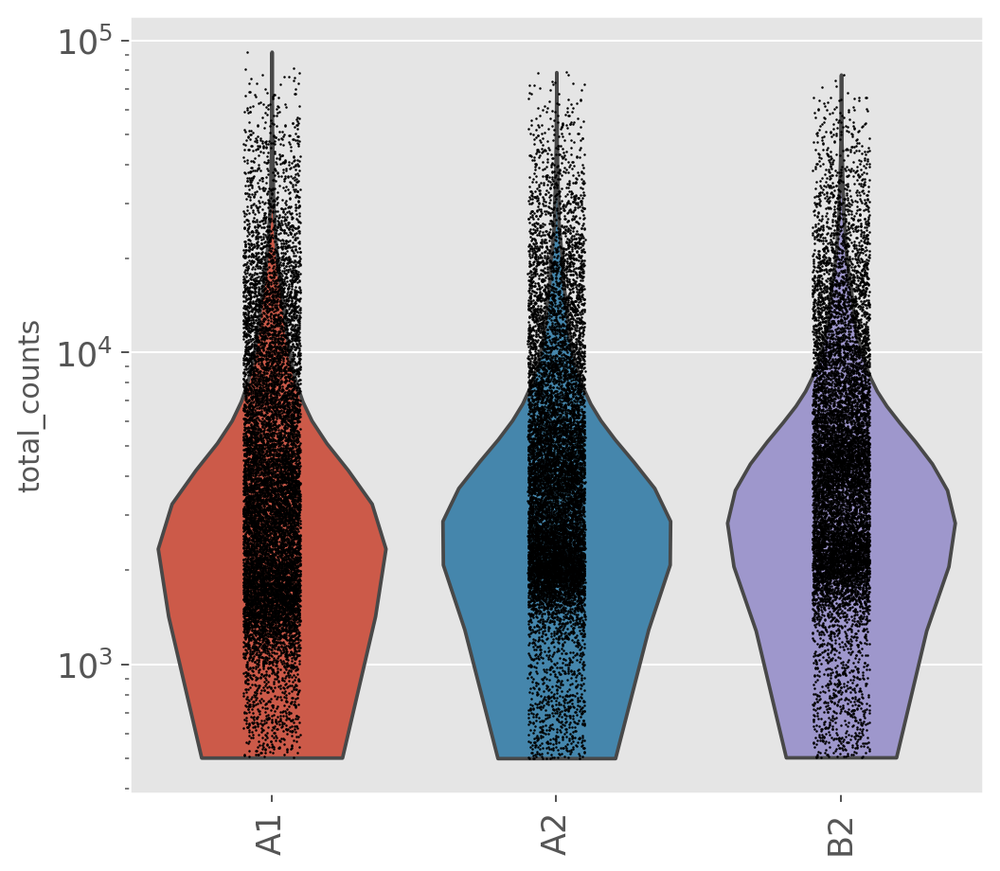

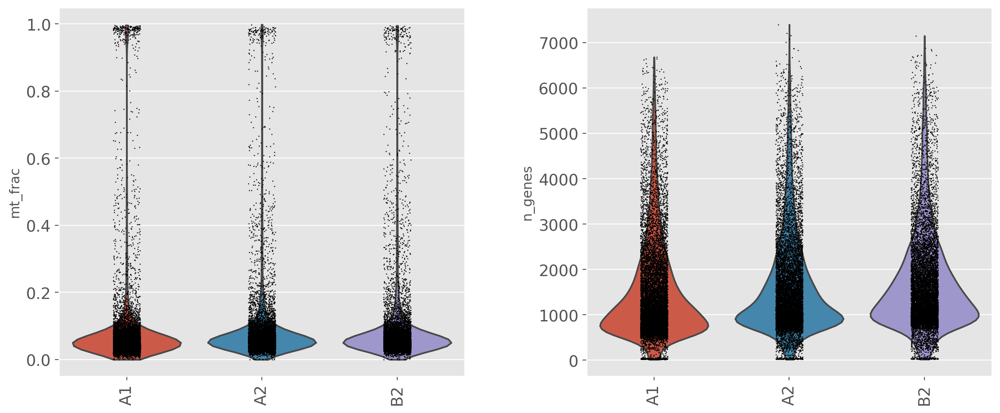

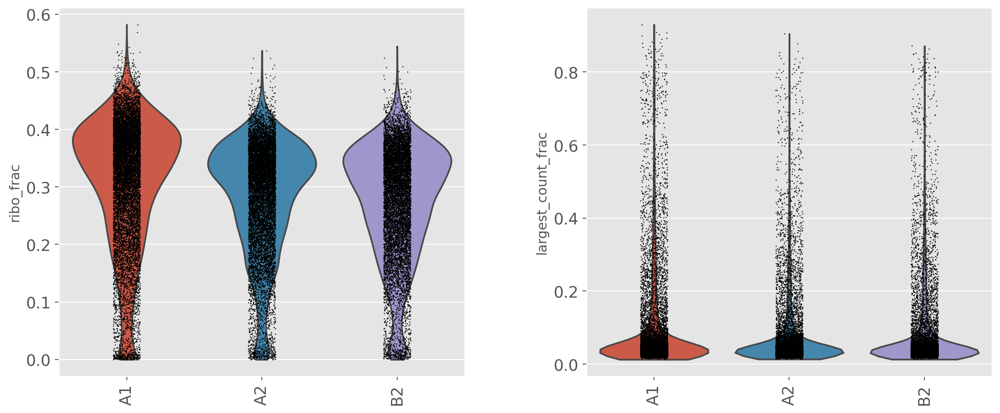

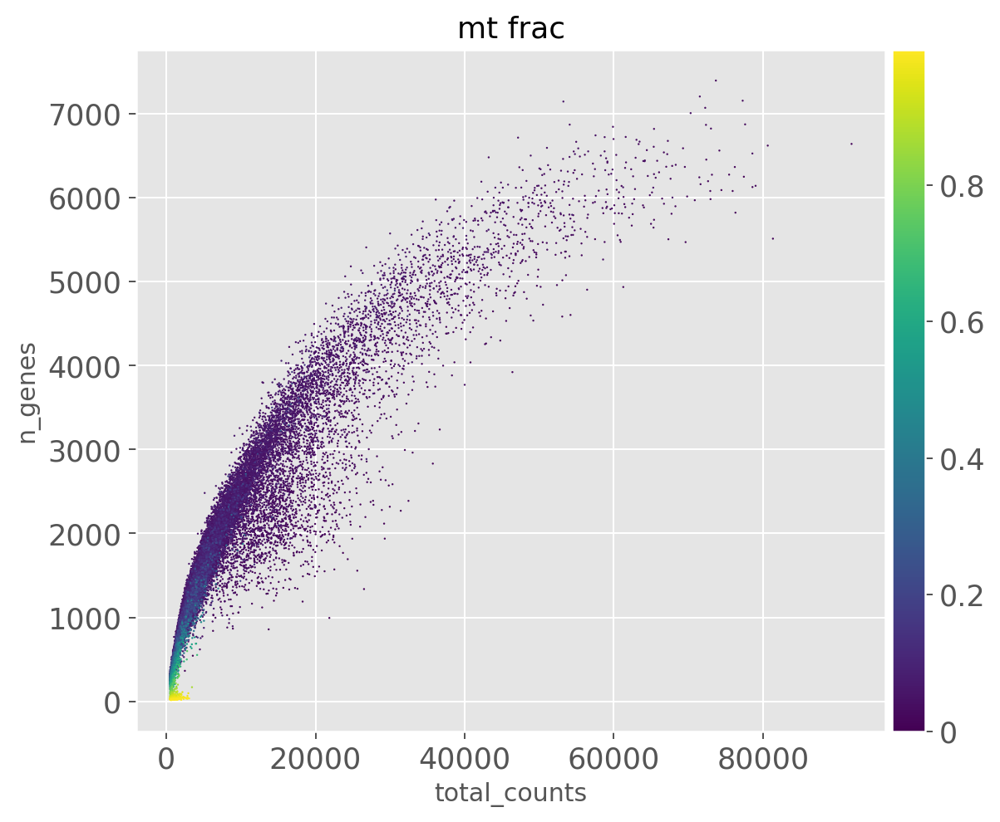

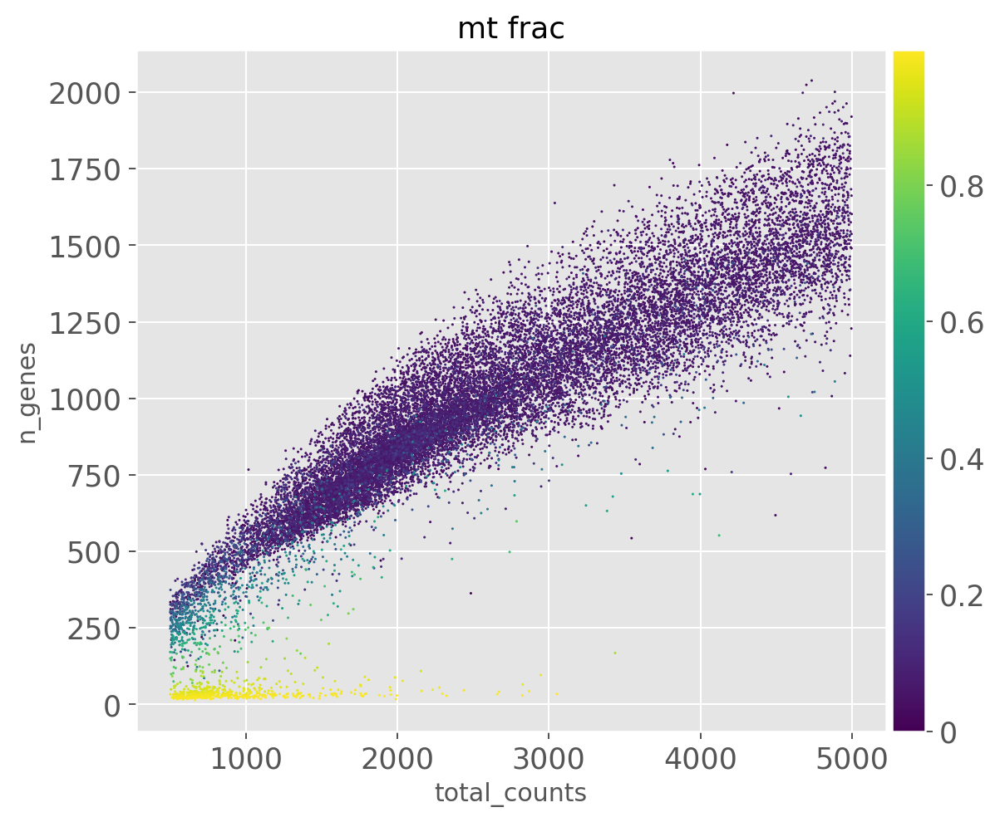

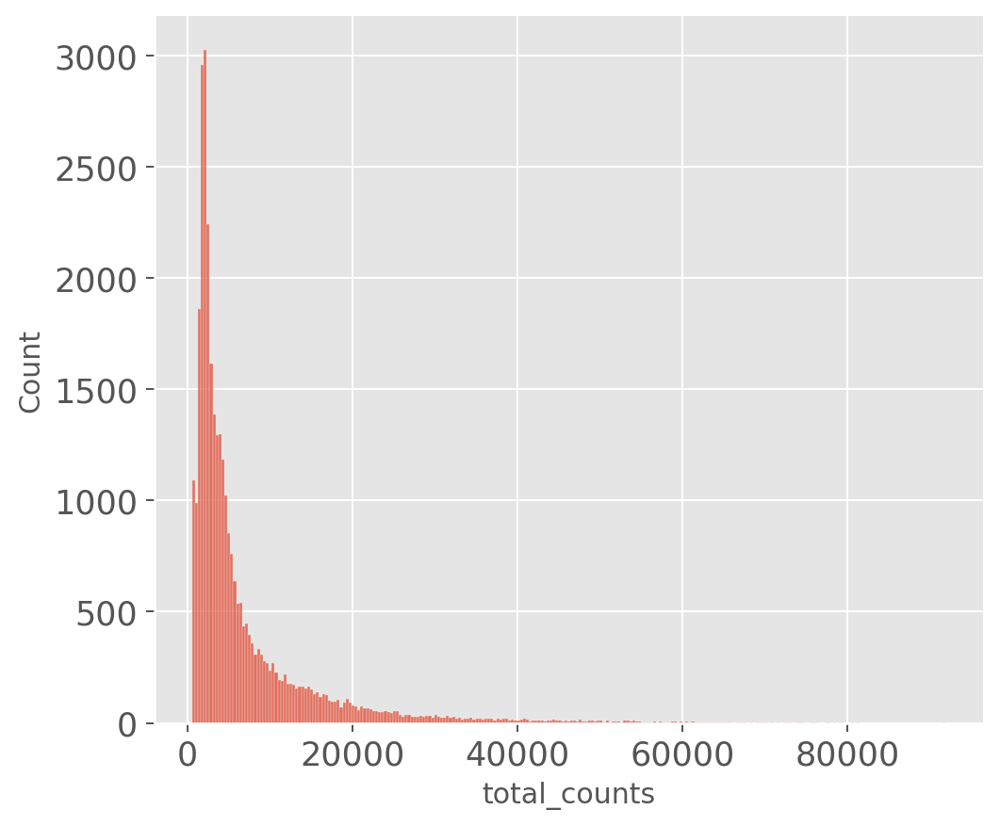

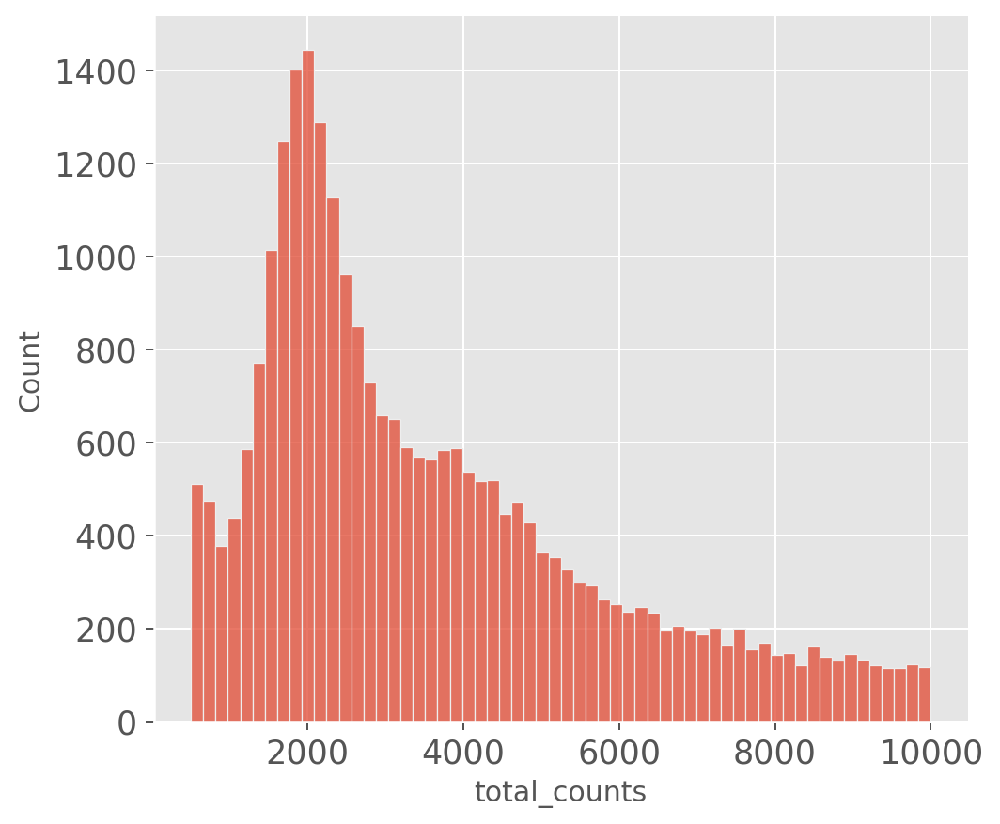

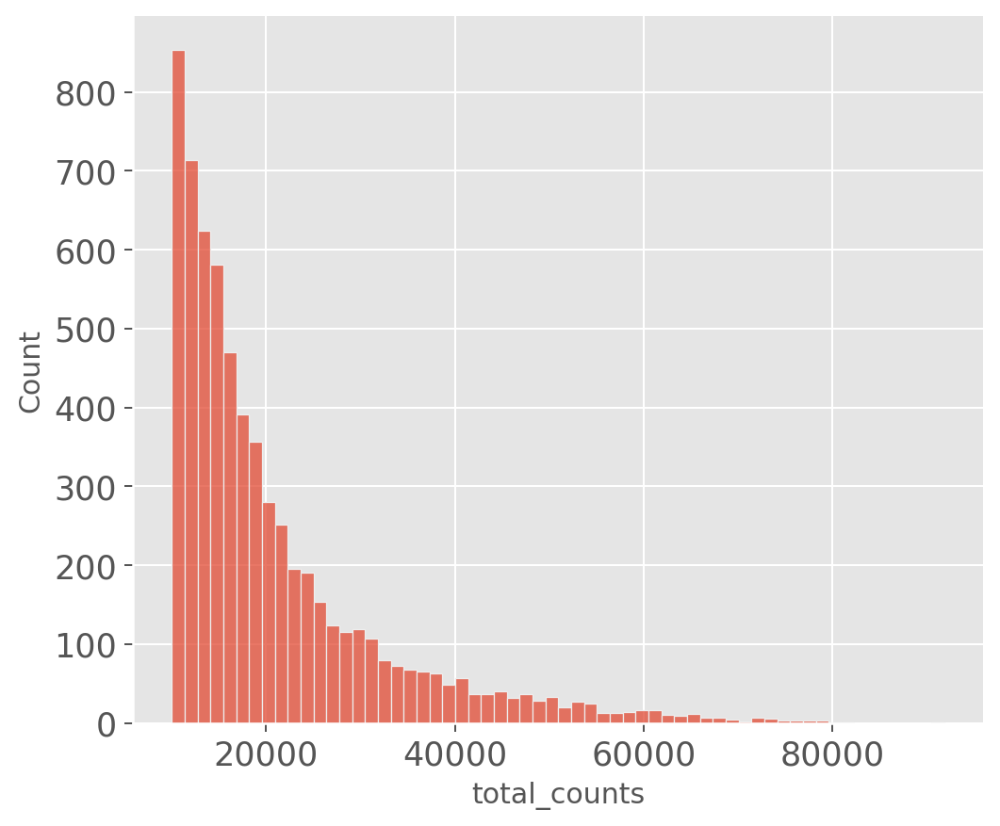

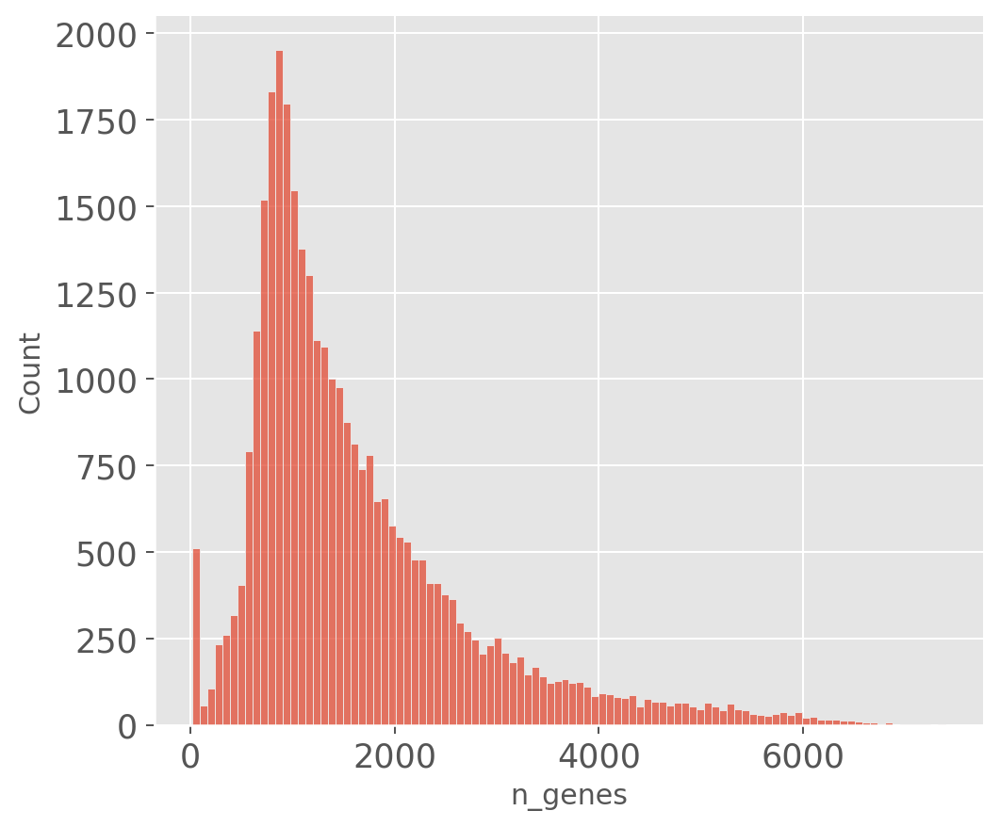

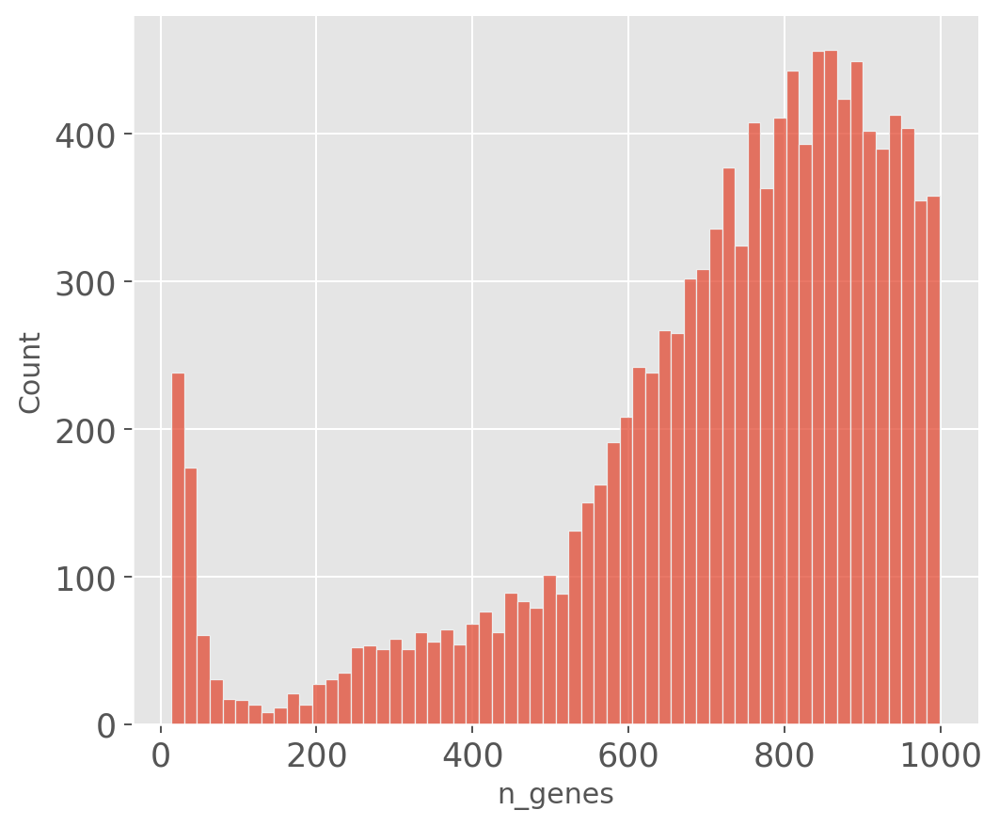

In [62]:
sctool.qc_metrics_and_plots(gex_adata)

From the above QC plots, you can determine the threshold for filtering n_genes, n_counts, mt_fraction

<Axes: xlabel='total_counts', ylabel='n_genes_by_counts'>

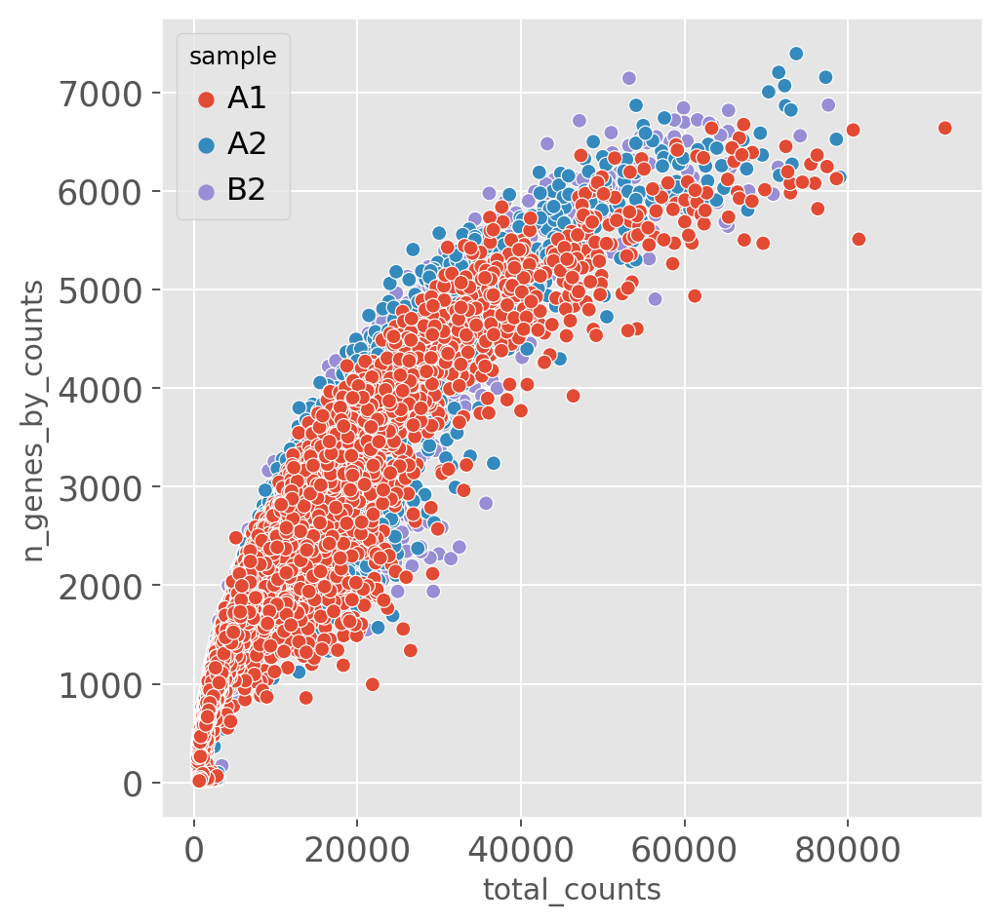

In [63]:
sns.scatterplot(data=gex_adata.obs,y='n_genes_by_counts',x='total_counts',hue='sample')

<Axes: xlabel='sample', ylabel='n_genes_by_counts'>

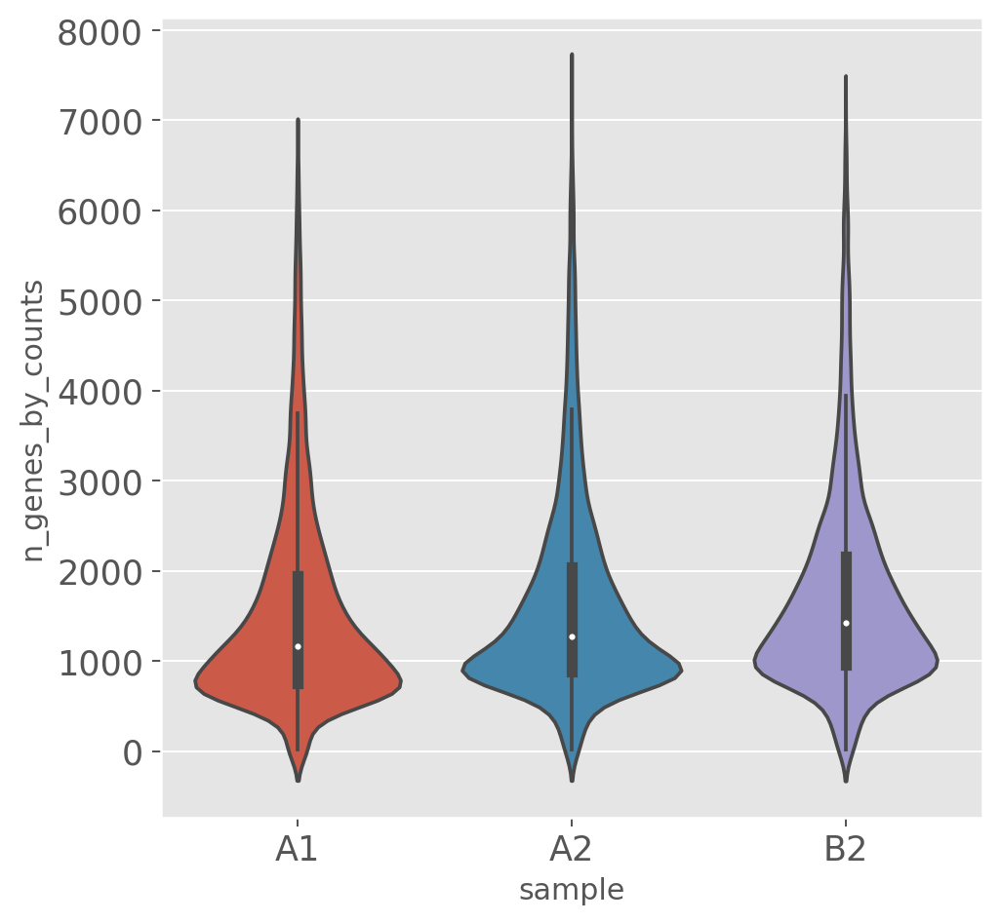

In [66]:
sns.violinplot(data=gex_adata.obs,y='n_genes_by_counts',x='sample')

In [67]:
gex_adata

AnnData object with n_obs × n_vars = 33006 × 58302
    obs: 'sample', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'n_genes', 'mt_frac', 'ribo_frac', 'largest_gene', 'largest_count_frac'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts'
    uns: 'sample_colors'

In [68]:
A1_gex_adata=gex_adata[gex_adata.obs.query('sample =="A1"').index,]
A2_gex_adata=gex_adata[gex_adata.obs.query('sample =="A2"').index,]
B2_gex_adata=gex_adata[gex_adata.obs.query('sample =="B2"').index,]

In [69]:
from statistics import median

In [70]:
median(gex_adata.obs.n_genes),median(A1_gex_adata.obs.n_genes),median(A2_gex_adata.obs.n_genes),median(B2_gex_adata.obs.n_genes)

(1283.0, 1159, 1276.0, 1421)

In [71]:
gex_adata

AnnData object with n_obs × n_vars = 33006 × 58302
    obs: 'sample', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'n_genes', 'mt_frac', 'ribo_frac', 'largest_gene', 'largest_count_frac'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts'
    uns: 'sample_colors'

In [72]:
median(gex_adata.obs.total_counts),median(A1_gex_adata.obs.total_counts),median(A2_gex_adata.obs.total_counts),median(B2_gex_adata.obs.total_counts)

(3737.0, 3397.0, 3620.5, 4202.0)

In [73]:
# Filter cells according to identified QC thresholds:
print('Total number of cells: {:d}'.format(gex_adata.n_obs))

sc.pp.filter_cells(gex_adata, min_counts = 1200)
print('Number of cells after min count filter: {:d}'.format(gex_adata.n_obs))

sc.pp.filter_cells(gex_adata, max_counts = 4e4)
print('Number of cells after max count filter: {:d}'.format(gex_adata.n_obs))

gex_adata = gex_adata[gex_adata.obs['mt_frac'] < 0.15]
print('Number of cells after MT filter: {:d}'.format(gex_adata.n_obs))

sc.pp.filter_cells(gex_adata, min_genes = 400)
print('Number of cells after gene filter: {:d}'.format(gex_adata.n_obs))

Total number of cells: 33006
filtered out 2008 cells that have less than 1200 counts
Number of cells after min count filter: 30998
filtered out 522 cells that have more than 40000.0 counts
Number of cells after max count filter: 30476
Number of cells after MT filter: 29285
filtered out 3 cells that have less than 400 genes expressed
Number of cells after gene filter: 29282


In [51]:
gex_adata[gex_adata.obs.query('sample =="B2"').index,]

View of AnnData object with n_obs × n_vars = 7447 × 20513
    obs: 'sample', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'n_genes', 'mt_frac', 'ribo_frac', 'largest_gene', 'largest_count_frac', 'n_counts', 'size_factors'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'sample_colors', 'log1p', 'hvg', 'pca', 'scanorama', 'umap', 'hmny'
    obsm: 'X_pca', 'X_scanorama', 'X_pca_harmony', 'X_umap'
    varm: 'PCs'
    layers: 'counts'
    obsp: 'scanorama_distances', 'scanorama_connectivities', 'hmny_distances', 'hmny_connectivities'

In [74]:
# Filter genes
print('Total number of genes: {:d}'.format(gex_adata.n_vars))

# Min 10 cells - filters out 0 count genes
sc.pp.filter_genes(gex_adata, min_cells=10)
print('Number of genes after cell filter: {:d}'.format(gex_adata.n_vars))

Total number of genes: 58302
filtered out 37755 genes that are detected in less than 10 cells
Number of genes after cell filter: 20547


In [75]:
[g for g in gex_adata.var.index if g[:4] in ['IGLV','IGLJ']]

['IGLVI-70',
 'IGLV4-69',
 'IGLV10-54',
 'IGLV8-61',
 'IGLV4-60',
 'IGLV6-57',
 'IGLV5-52',
 'IGLV1-51',
 'IGLV1-50',
 'IGLV9-49',
 'IGLV5-48',
 'IGLV1-47',
 'IGLV7-46',
 'IGLV5-45',
 'IGLV1-44',
 'IGLV7-43',
 'IGLV1-41',
 'IGLV1-40',
 'IGLV5-37',
 'IGLV1-36',
 'IGLV7-35',
 'IGLV2-34',
 'IGLV2-33',
 'IGLV2-28',
 'IGLV3-27',
 'IGLV3-25',
 'IGLV3-24',
 'IGLV2-23',
 'IGLV3-22',
 'IGLV3-21',
 'IGLVI-20',
 'IGLV3-19',
 'IGLV2-18',
 'IGLV3-16',
 'IGLV2-14',
 'IGLV3-13',
 'IGLV3-12',
 'IGLV2-11',
 'IGLV3-10',
 'IGLV3-9',
 'IGLV2-8',
 'IGLV3-6',
 'IGLV2-5',
 'IGLV4-3',
 'IGLV3-1',
 'IGLJ1',
 'IGLJ2',
 'IGLJ3']

In [76]:
# get IG variable gene names
rm_genes = [g for g in gex_adata.var.index if g[:4] in ['IGLV','IGLJ']] +  \
           [g for g in gex_adata.var.index if g[:4] in ['IGKV','IGKJ']] + \
           [g for g in gex_adata.var.index if g[:4] in ['IGHV','IGHJ','IGHD']]
rm_genes.remove('IGHD') # IGHD is the constant reion, so don't remove this gene
sub_genes =[g for g in gex_adata.var.index if g not in rm_genes]
gex_adata = gex_adata[:,sub_genes]

In [54]:
gex_adata[gex_adata.obs['largest_gene'].map(lambda x: x.startswith('MT')),:].obs['sample'].value_counts()

B2    3669
A2    3626
A1    2778
Name: sample, dtype: int64

In [77]:
print(gex_adata.obs['sample'].value_counts())

A1    10114
A2    10022
B2     9146
Name: sample, dtype: int64


In [57]:
format(gex_adata.n_obs)

'21675'

## 2.2 Normalization
This step creates a copy of adata and run clustering to generate a pre-clusters which will be used for downstream normalization using scran package. The main goal of using scran is to calculate size factor for each cell and then normalize the raw count.

In [82]:
#Perform a clustering for scran normalization in clusters
adata_pp = gex_adata.copy()
sc.pp.normalize_total(adata_pp, target_sum=1e4)
sc.pp.log1p(adata_pp)
sc.pp.pca(adata_pp, n_comps=15)
sc.pp.neighbors(adata_pp)
sc.tl.leiden(adata_pp, key_added='groups', resolution=0.5)

normalizing counts per cell
    finished (0:00:00)
computing PCA
    with n_comps=15
    finished (0:00:12)
computing neighbors
    using 'X_pca' with n_pcs = 15
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:03)
running Leiden clustering
    finished: found 18 clusters and added
    'groups', the cluster labels (adata.obs, categorical) (0:00:04)


In [83]:
#Preprocess variables for scran normalization
input_groups = adata_pp.obs['groups']
data_mat = gex_adata.X.T
#Delete adata_pp
del adata_pp

Calculating size factors using scrun is a little memory intensive and also takes a lot of time. The input has to be in sparse matrix. This step will take some time to run.

In [84]:
%%R -i data_mat -i input_groups -o size_factors

size_factors = sizeFactors(computeSumFactors(SingleCellExperiment(list(counts=data_mat)), clusters=input_groups, min.mean=0.1))

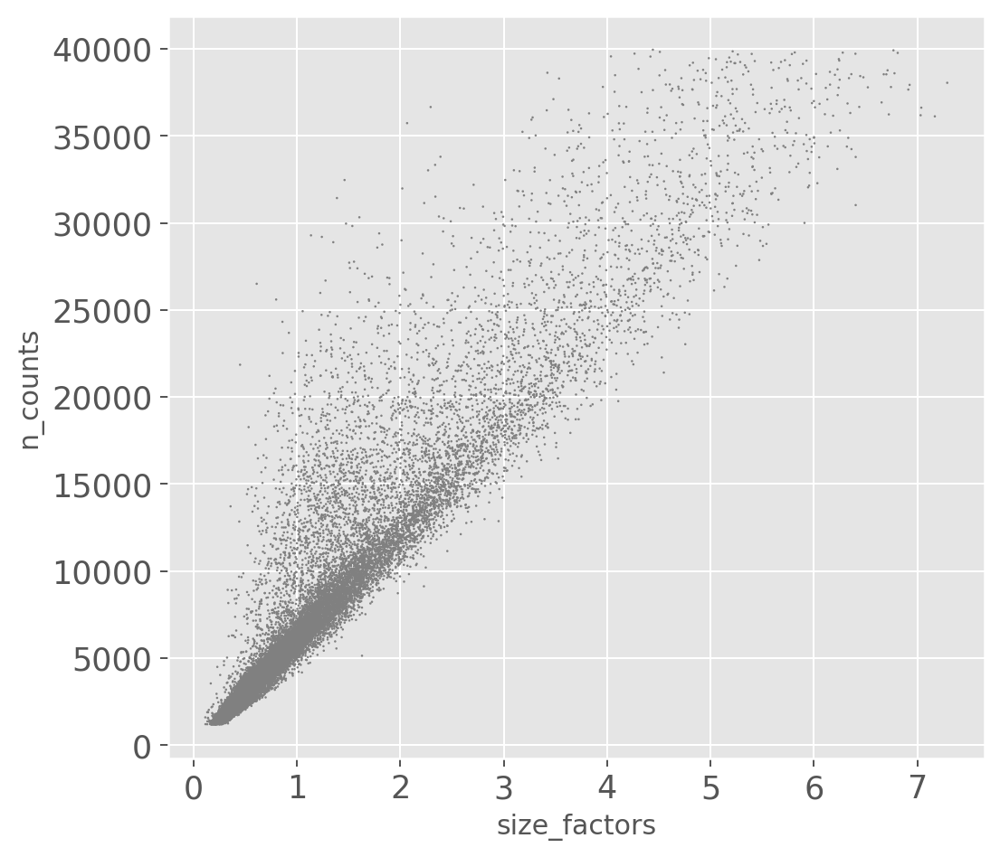

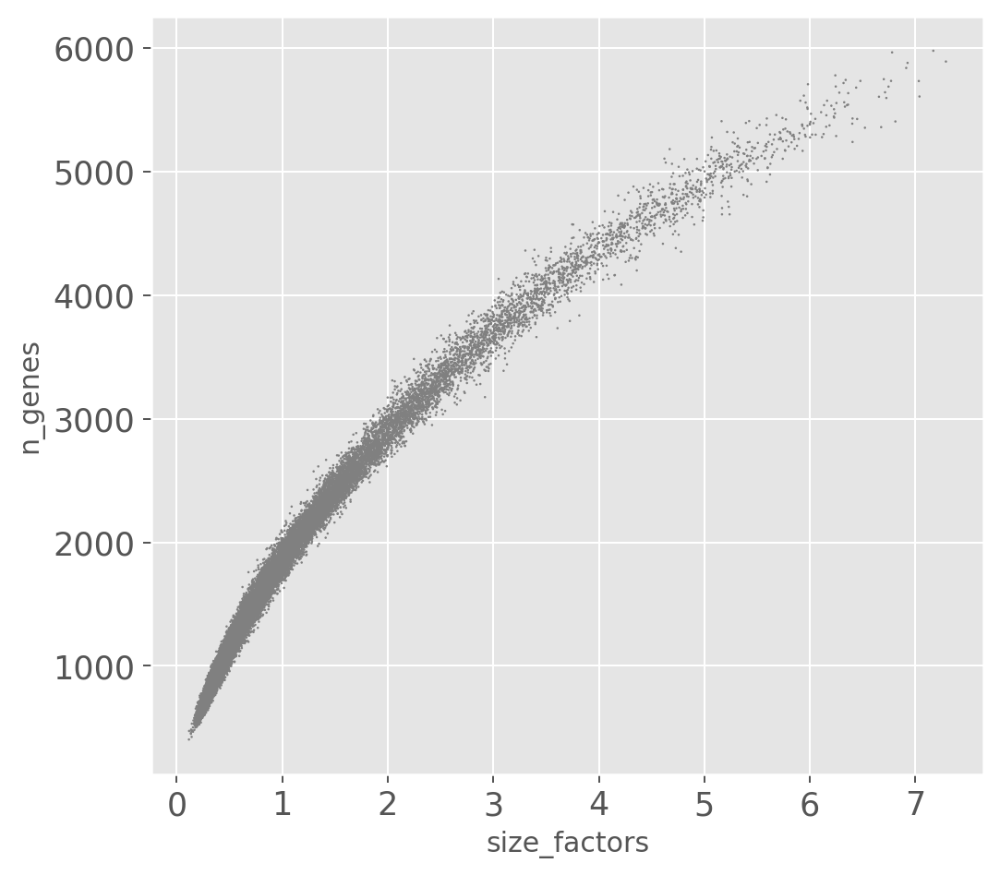

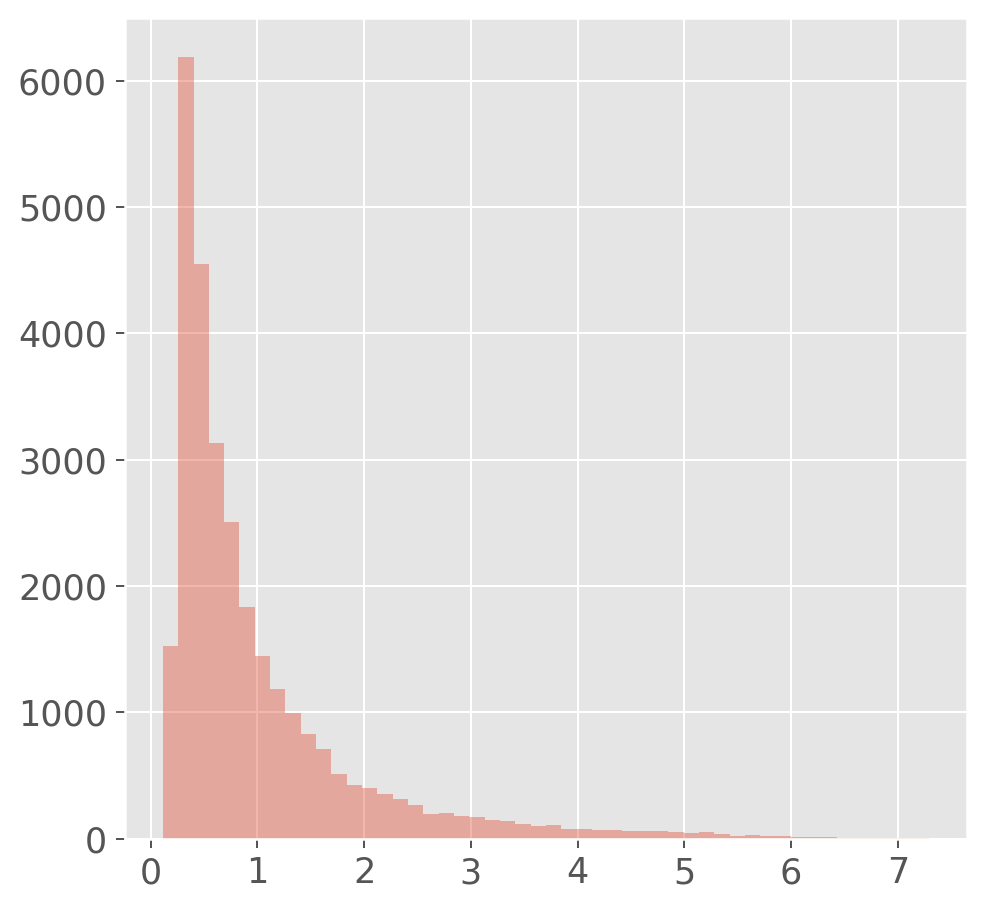

In [85]:
# Visualize the estimated size factors
gex_adata.obs['size_factors'] = size_factors

sc.pl.scatter(gex_adata, 'size_factors', 'n_counts')
sc.pl.scatter(gex_adata, 'size_factors', 'n_genes')

sb.distplot(size_factors, bins=50, kde=False)
plt.show()

In [86]:
# Keep the count data in a counts layer
gex_adata.layers["counts"] = gex_adata.X.copy()

In [87]:
#Normalize adata 
gex_adata.X = gex_adata.X.multiply(sp.sparse.csr_matrix(1/gex_adata.obs['size_factors'].values[:,None]))
sc.pp.log1p(gex_adata)

In [88]:
# Store the full data set in 'raw' as log-normalised data for statistical testing
gex_adata.raw = gex_adata

## 2.3 Highly Variable Genes
Typically between 1000 and 5000 genes are selected. Here, we extract the top 4000 most variable genes for further processing. If particular genes of importance are known, one could assess how many highly variable genes are necessary to include all, or the majority, of these. <br/>
Highly variable gene information is stored automatically in the adata.var['highly_variable'] field.

Note: raw code of scanpy may get error if the bin edges are duplicated. The error message is ** Bin edges must be unique, You can drop duplicate edges by setting the 'duplicates' kwarg**. To makesure the error would not occur for all cases, you can change the source code in line 244 of the file https://github.com/scverse/scanpy/blob/master/scanpy/preprocessing/_highly_variable_genes.py#L295-L564.  add a parameter duplicates='drop'

In [89]:
sc.pp.highly_variable_genes(gex_adata, flavor='seurat', n_top_genes=4000,n_bins=50)
print('\n','Number of highly variable genes: {:d}'.format(np.sum(gex_adata.var['highly_variable'])))

If you pass `n_top_genes`, all cutoffs are ignored.
extracting highly variable genes
    finished (0:00:02)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)

 Number of highly variable genes: 4000


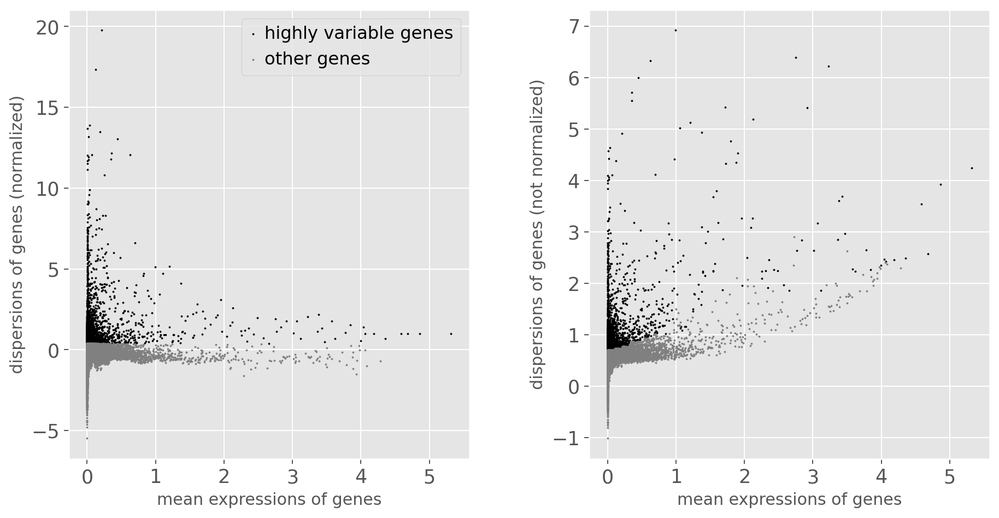

In [90]:
sc.pl.highly_variable_genes(gex_adata)

The plots show how the data was normalized to select highly variable genes irrespective of the mean expression of the genes. This is achieved by using the index of dispersion which divides by mean expression, and subsequently binning the data by mean expression and selecting the most variable genes within each bin.

## 2.4 Batch correction
Origianl pipeline uses combat, usually correct based on sample. 
There are some other popular batch correction method like BBKNN tutorial or ingest here for integrating datasets.https://scanpy-tutorials.readthedocs.io/en/latest/integrating-data-using-ingest.html. Note ComBat batch correction can produce negative expression values. One can either set all negative values to 0 or force zeros pre-batch-correction to remain zero post-batch-correction. <br/>

Based on the benchmark of batch effect removal methods [here](https://www.nature.com/articles/s41592-021-01336-8). Scanorama was one of the top recommended algorithms. Harmany was metioned to perform well for easy cases. So here we test scanorama and harmany and pick the best of the two in this pipeline.

computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:00:07)


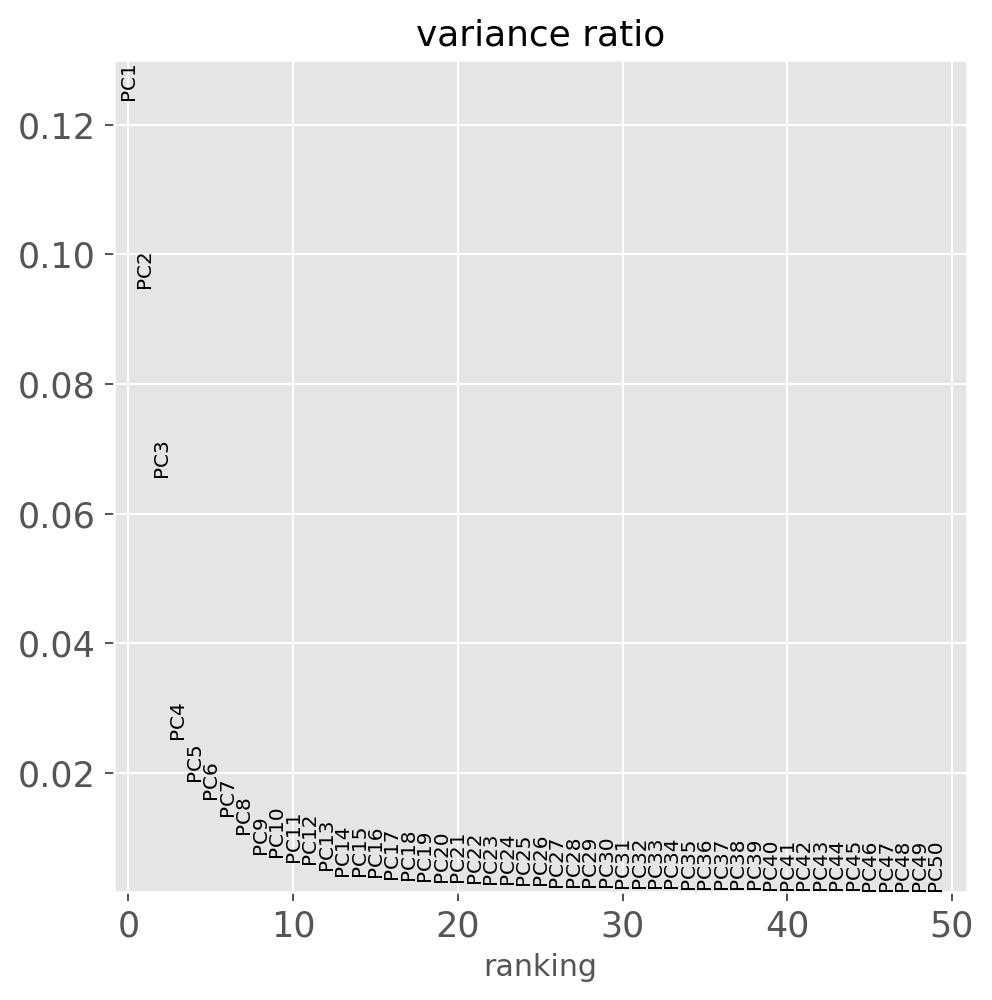

In [91]:
n_pc = 50
sc.tl.pca(gex_adata, n_comps=n_pc, use_highly_variable=True, svd_solver='arpack')
sc.pl.pca_variance_ratio(gex_adata, n_pcs=n_pc)

In [92]:
sce.pp.scanorama_integrate(gex_adata, 'sample')
sce.pp.harmony_integrate(gex_adata, 'sample', max_iter_harmony = 15)

[[0.         0.94751804 0.40923472]
 [0.         0.         0.64947116]
 [0.         0.         0.        ]]
Processing datasets B2 <=> A2
Processing datasets A2 <=> A1
Processing datasets B2 <=> A1


2023-07-14 02:01:01,550 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2023-07-14 02:01:25,063 - harmonypy - INFO - sklearn.KMeans initialization complete.
2023-07-14 02:01:25,194 - harmonypy - INFO - Iteration 1 of 15
2023-07-14 02:01:32,995 - harmonypy - INFO - Iteration 2 of 15
2023-07-14 02:01:40,549 - harmonypy - INFO - Iteration 3 of 15
2023-07-14 02:01:48,355 - harmonypy - INFO - Converged after 3 iterations


## 2.5 UMAP visualize to choose batch effect methods and compute neighbors
This step aims to test which batch effect removal method works better. Currently we applied two methods: scanorama and harmony.

In [305]:
# load the stored data for replication, if you are running a new datasets, don't run this chunk of data
gex_adata_fn = f'{work_dir}/inter_h5ad/gex_adata.h5ad'
if os.path.exists(gex_adata_fn):
    gex_adata = sc.read_h5ad(f'{work_dir}/inter_h5ad/gex_adata.h5ad')
    gex_adata.uns['log1p']["base"] = None

computing neighbors
    finished: added to `.uns['scanorama']`
    `.obsp['scanorama_distances']`, distances for each pair of neighbors
    `.obsp['scanorama_connectivities']`, weighted adjacency matrix (0:00:04)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:17)


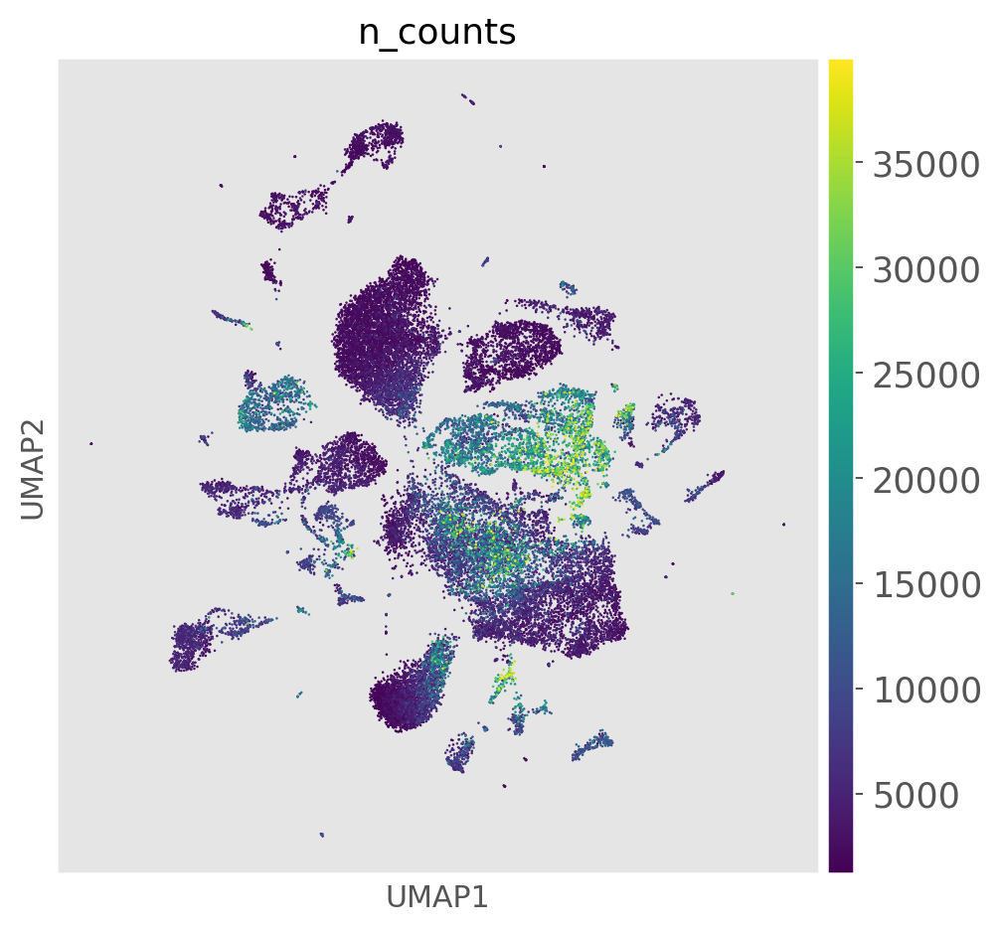

In [93]:
# Calculate the UMAP using scanorama
sc.pp.neighbors(gex_adata, use_rep = 'X_scanorama', key_added='scanorama')
sc.tl.umap(gex_adata, neighbors_key='scanorama')
sc.pl.umap(gex_adata, color='n_counts')

computing neighbors
    finished: added to `.uns['hmny']`
    `.obsp['hmny_distances']`, distances for each pair of neighbors
    `.obsp['hmny_connectivities']`, weighted adjacency matrix (0:00:04)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:17)


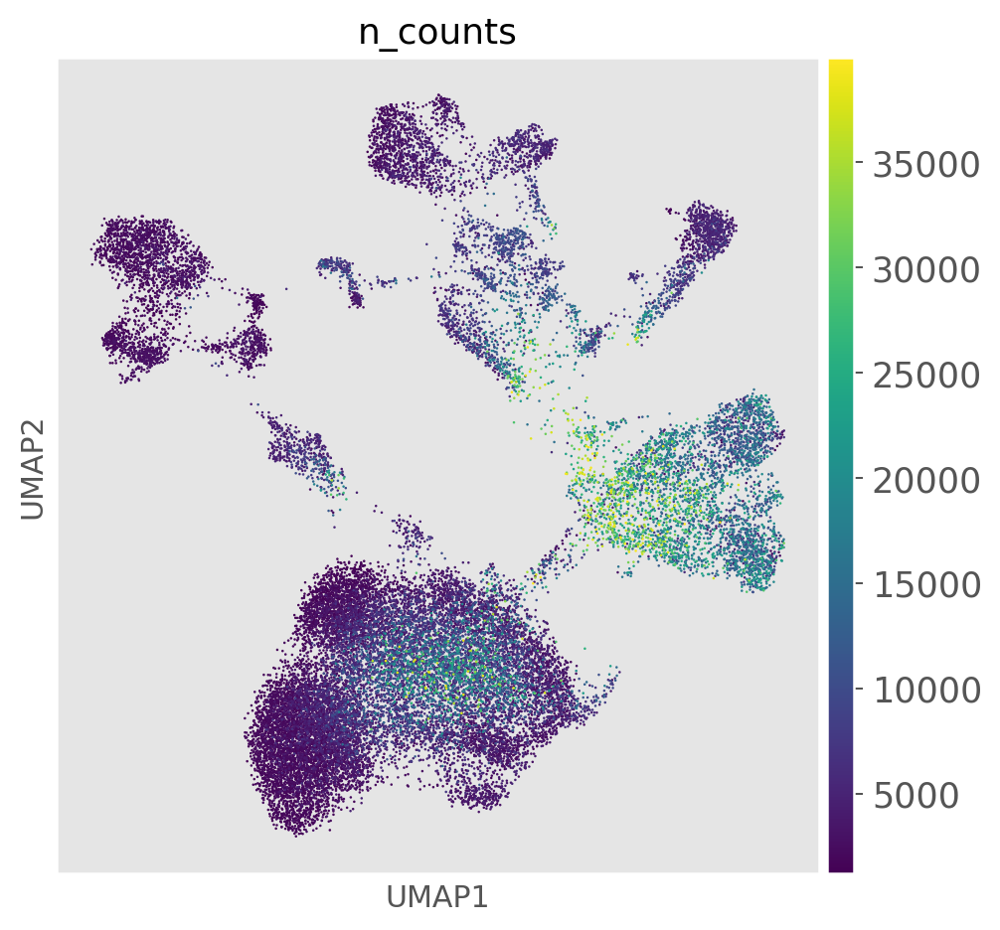

In [94]:
# Calculate the UMAP using harmany
sc.pp.neighbors(gex_adata, use_rep = 'X_pca_harmony',key_added='hmny')
sc.tl.umap(gex_adata, neighbors_key='hmny')
sc.pl.umap(gex_adata, color='n_counts')

Based on the UMAP plot, scanorama, has generates many tiny clusters which looks like norise when removing batch effect. While harmony performs better with more continuouse clusters

## 2.6 Cell cycle scoring
Annotate cell state in cell cycle. States are S, G2.M, 

In [95]:
#Score cell cycle and visualize the effect:
cc_genes = pd.read_table(cc_genes_file, delimiter='\t')
s_genes = cc_genes['S'].dropna()
g2m_genes = cc_genes['G2.M'].dropna()

s_genes_ens = gex_adata.var_names[np.in1d(gex_adata.var_names, s_genes)]
g2m_genes_ens = gex_adata.var_names[np.in1d(gex_adata.var_names, g2m_genes)]
sc.tl.score_genes_cell_cycle(gex_adata, s_genes=s_genes_ens, g2m_genes=g2m_genes_ens)

calculating cell cycle phase
computing score 'S_score'
    finished: added
    'S_score', score of gene set (adata.obs).
    2208 total control genes are used. (0:00:01)
computing score 'G2M_score'
    finished: added
    'G2M_score', score of gene set (adata.obs).
    2216 total control genes are used. (0:00:01)
-->     'phase', cell cycle phase (adata.obs)


The dataset now contains:
- a 'counts' layer with count data
- log-normalized data in adata.X
- batch corrected data in adata.obsm['X_scanorama'] or adata.obsm['']
- highly variable gene annotations in adata.var['highly_variable']

The HVG labels will be used to subselect genes for clustering and trajectory analysis.

# 3. Cluster and annotation
## 3.1 Clustering
First calculate PCA, then use the PCA to get K nearest neighbor, and then use louvian method to do clustering.
You can set random_state to make sure the results is reproducible.

In [96]:
sc.tl.leiden(gex_adata, key_added='leiden_r0.5', resolution=0.5, neighbors_key='hmny')

running Leiden clustering
    finished: found 12 clusters and added
    'leiden_r0.5', the cluster labels (adata.obs, categorical) (0:00:03)


In [97]:
gex_adata.obs['leiden_r0.5'].value_counts()

0     8087
1     6513
2     4025
3     2819
4     2195
5     1588
6     1193
7     1012
8      591
9      526
10     455
11     278
Name: leiden_r0.5, dtype: int64

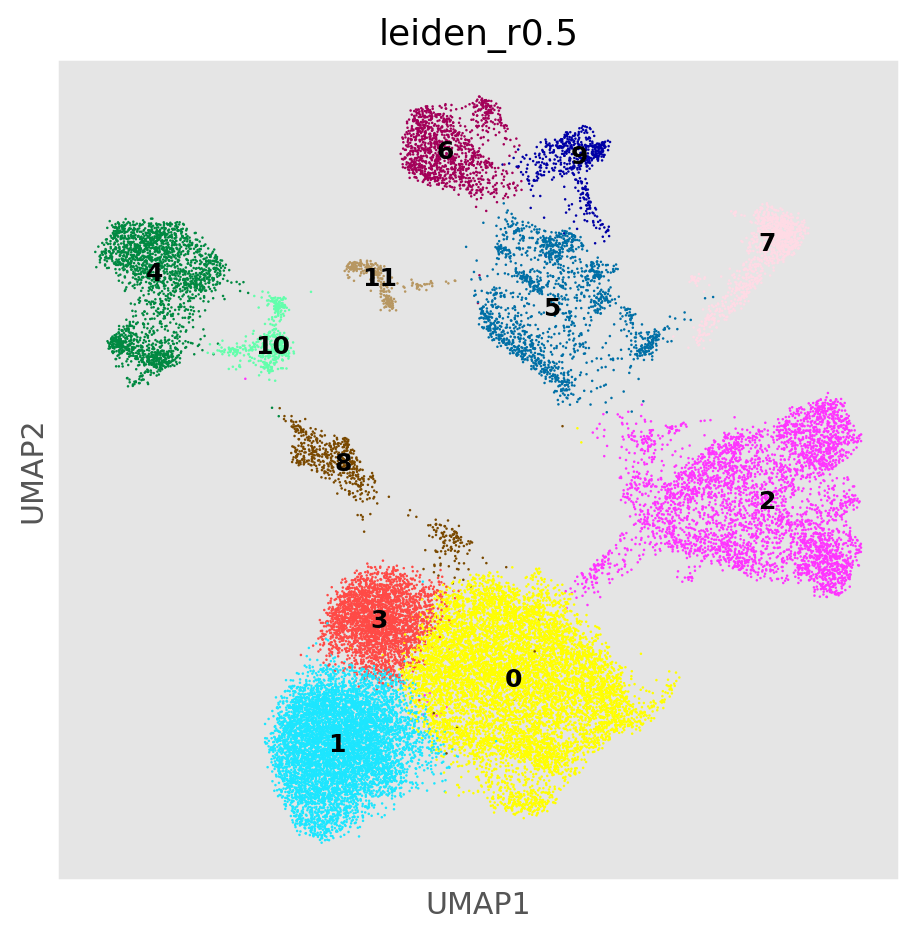

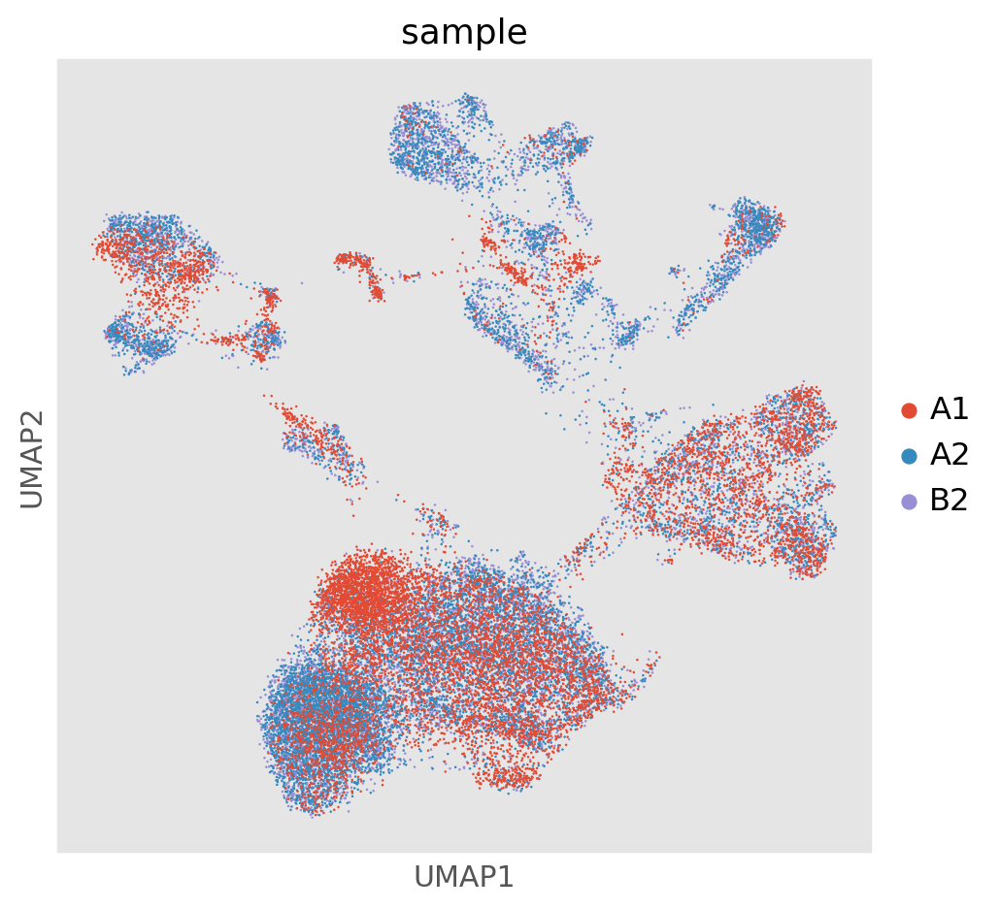

In [98]:
# Visualize the clustering and how this is reflected by different technical covariates
sc.pl.umap(gex_adata, color=['leiden_r0.5'], palette=sc.pl.palettes.default_102, legend_loc='on data')
sc.pl.umap(gex_adata, color=['sample'])

## 3.2 Marker genes & cluster annotation
This differential expression test is performed by a Welch t-test with overestimated variance to be conservative. This is the default in scanpy. The test is automatically performed on the .raw data set, which is uncorrected and contains all genes. All genes are taken into account, as any gene may be an informative marker.

In [99]:
# Calculate marker genes
sc.tl.rank_genes_groups(gex_adata, groupby='leiden_r0.5', key_added='rank_genes_r0.5')

ranking genes
    finished: added to `.uns['rank_genes_r0.5']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:07)


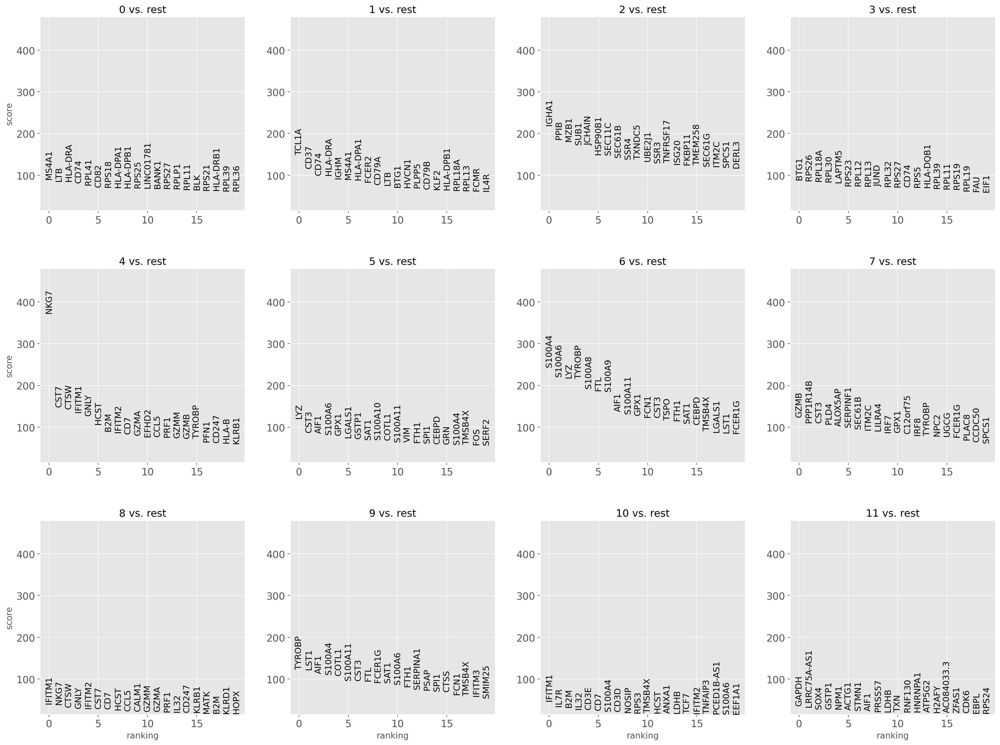

In [100]:
#Plot marker genes, need to change groups based on how many clusters you get
sc.pl.rank_genes_groups(gex_adata, key='rank_genes_r0.5', fontsize=12)

### 3.2.1 Annotate using SCSA
Tools is available here https://github.com/bioinfo-ibms-pumc/SCSA.

In [101]:
# list all tissues that is available in the database
!python3 /opt/SCSA/SCSA.py -d /opt/SCSA/whole.db -i test -l

Version V1.1 [2020/07/03]
DB load: 47347 3 3 48257 37440
########################################################################################################################
------------------------------------------------------------------------------------------------------------------------
Species:Human      Num:159       
------------------------------------------------------------------------------------------------------------------------
  1: Abdominal adipose tissue             2: Adipose tissue                       3: Adrenal gland                      
  4: Adventitia                           5: Airway epithelium                    6: Alveolus                           
  7: Amniotic fluid                       8: Amniotic membrane                    9: Antecubital vein                   
 10: Anterior cruciate ligament          11: Artery                              12: Ascites                            
 13: Bladder                             14: Blood            

In [102]:
init_celltype = sctool.scsa_cell_anno(gex_adata, rank_key='rank_genes_r0.5', clust_col='leiden_r0.5', species='Human',tissue='Blood', tmp_dir='/tmp')

/opt/SCSA/SCSA.py:228: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_outs = all_outs.append(outs)
/opt/SCSA/SCSA.py:228: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_outs = all_outs.append(outs)
/opt/SCSA/SCSA.py:228: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_outs = all_outs.append(outs)
/opt/SCSA/SCSA.py:228: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_outs = all_outs.append(outs)
/opt/SCSA/SCSA.py:228: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_outs = all_outs.append(outs)
/opt/SCSA/SCSA.py:228: FutureWarning: The fra

Version V1.1 [2020/07/03]
DB load: 47347 3 3 48257 37440
Namespace(input='/tmp/rank_genes_r0.5.tsv', output='/tmp/scsa_anno_rank_genes_r0.5.txt', db='/opt/SCSA/whole.db', source='scanpy', cluster='all', MarkerDB=None, foldchange=1.5, pvalue=0.01, weight=100.0, species='Human', tissue='Blood', outfmt='txt', celltype='normal', target='cellmarker', Gensymbol=True, norefdb=False, noprint=True, list_tissue=False)
Version V1.1 [2020/07/03]
DB load: 47347 3 3 48257 37440
load markers: 1449
Cluster 0 Gene number: 316
Other Gene number: 736
Cluster 1 Gene number: 185
Other Gene number: 733
Cluster 10 Gene number: 352
Other Gene number: 742
Cluster 11 Gene number: 940
Other Gene number: 728
Cluster 2 Gene number: 1583
Other Gene number: 705
Cluster 3 Gene number: 91
Other Gene number: 740
Cluster 4 Gene number: 780
Other Gene number: 730
Cluster 5 Gene number: 1383
Other Gene number: 718
Cluster 6 Gene number: 1520
Other Gene number: 735
Cluster 7 Gene number: 1140
Other Gene number: 622
Cluster

Before run SCSA you can run the following command to check what tissue is available in SCSA:
python /opt/SCSA/SCSA.py -d /opt/SCSA/whole.db -i test -l

### 3.2.2 Manual curation of the initial annotation
This step requires users to check the details of the inital cell type annotation and then refine the annotation.

In [103]:
# manual curation of the predicted cell types
init_celltype['0'] = 'B cell'
init_celltype['1'] = 'B cell'
init_celltype['2'] = 'Plasma' 
init_celltype['3'] = 'DC' #this is annotated as a B cell in batch1 ### # CD1C-CD141- dendritic cell
init_celltype['4'] = 'NK'  
init_celltype['5'] = 'DC' 
init_celltype['6'] = 'DC' # 'Ighv3'
init_celltype['7'] = 'DC' # 'Ighv3'
init_celltype['8'] = 'NK'
init_celltype['9'] = 'DC'
init_celltype['10'] = 'T'
init_celltype['11'] = 'Endo'


gex_adata.obs['cell_type'] = gex_adata.obs['leiden_r0.5'].map(lambda x: init_celltype[x])
gex_adata.obs['cell_type'].value_counts()

B cell    14600
DC         7138
Plasma     4025
NK         2786
T           455
Endo        278
Name: cell_type, dtype: int64

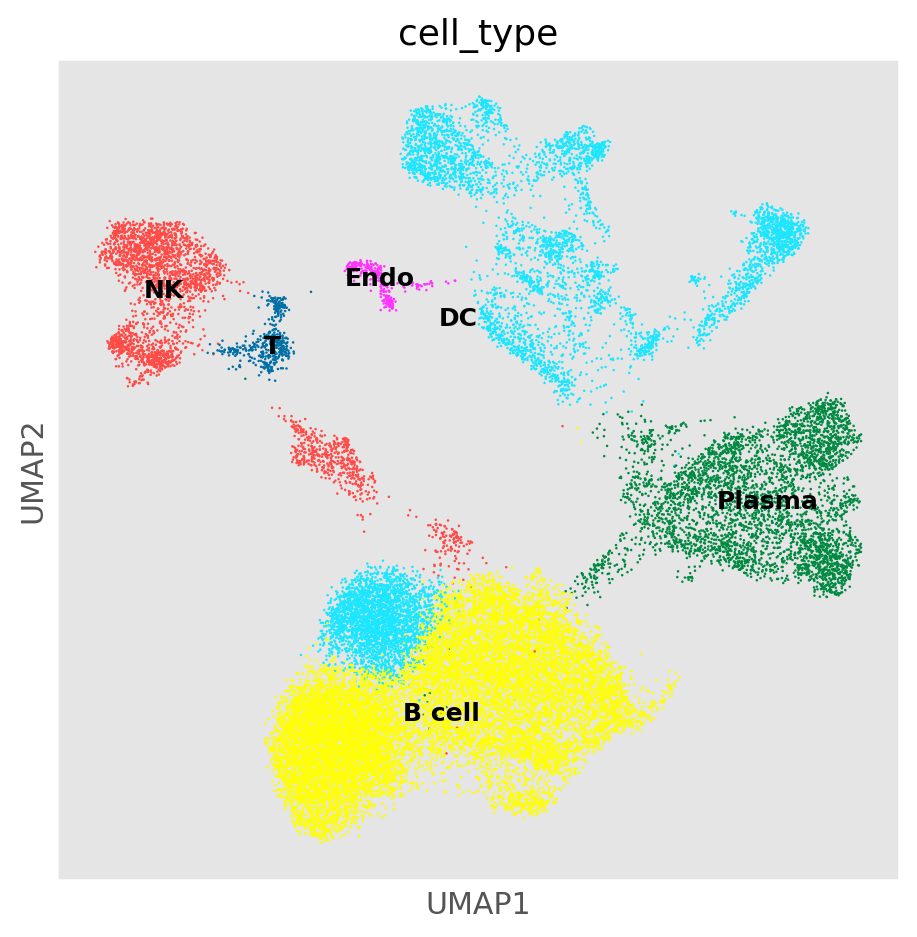

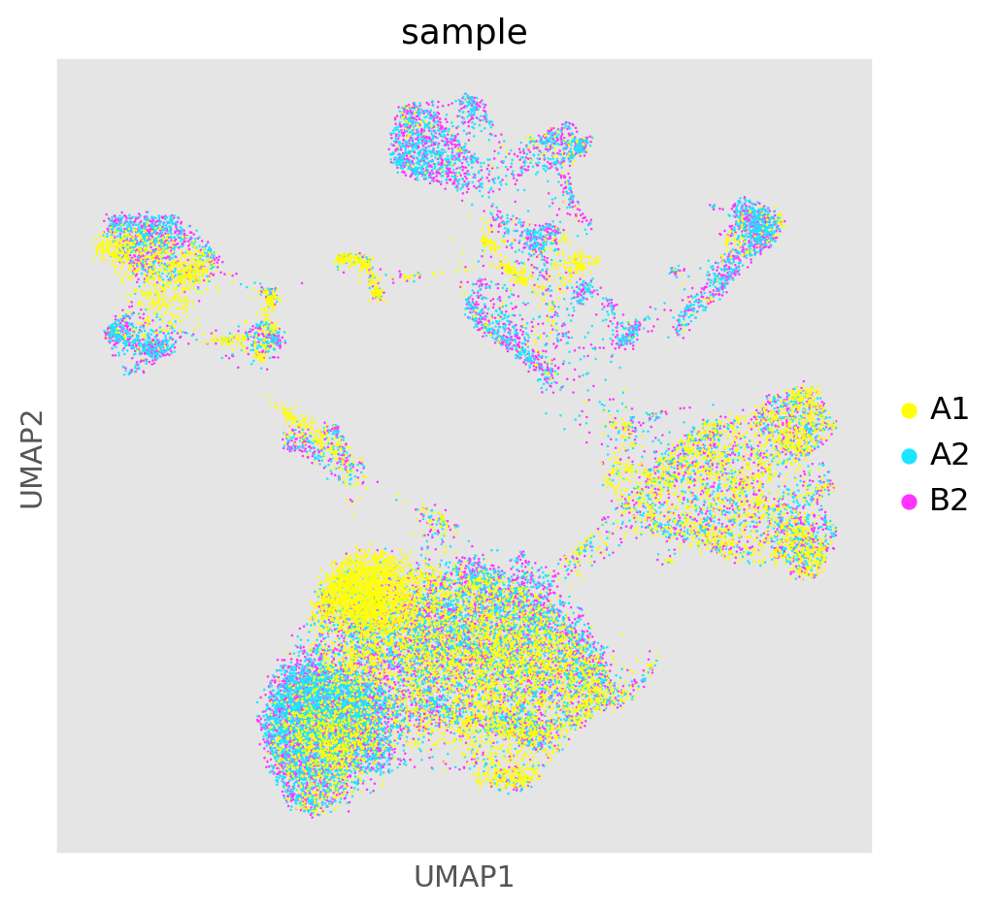

In [104]:
sc.pl.umap(gex_adata, color=['cell_type'], palette=sc.pl.palettes.default_102, legend_loc='on data')
sc.pl.umap(gex_adata, color=['sample'], palette=sc.pl.palettes.default_102)

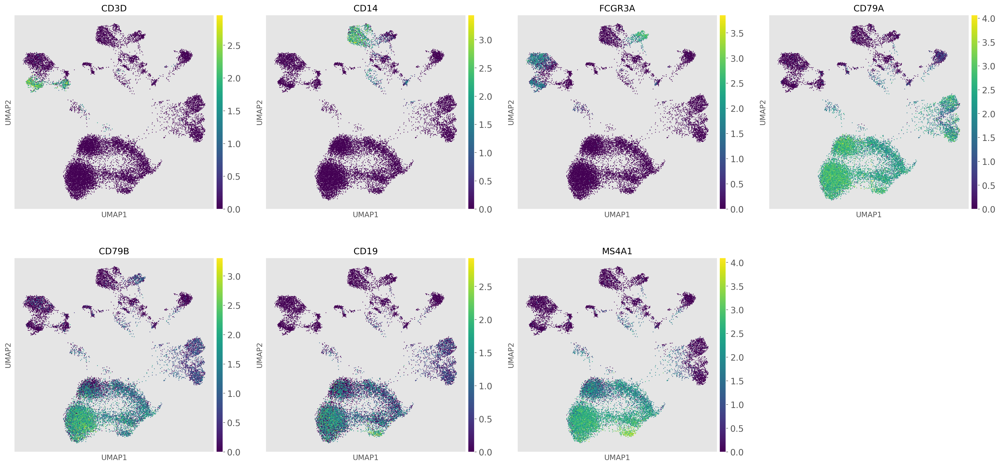

In [148]:
# check biomarker expression
sc.pl.umap(gex_adata, color=['CD3D','CD14','FCGR3A','CD79A','CD79B','CD19','MS4A1'], palette=sc.pl.palettes.default_102)

In [149]:
# get marker genes for broad cell types
sc.tl.rank_genes_groups(gex_adata, groupby='cell_type', key_added='rank_genes_cell_type')

ranking genes
    finished: added to `.uns['rank_genes_cell_type']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:02)


    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns['dendrogram_cell_type']`


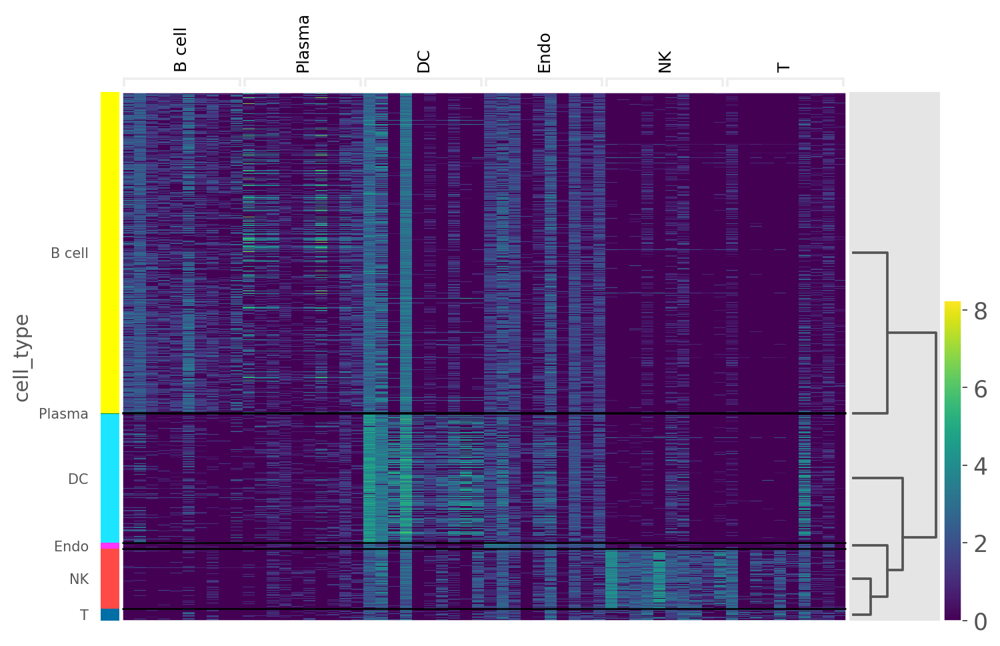

In [150]:
sc.pl.rank_genes_groups_heatmap(gex_adata, n_genes=10, min_logfoldchange=1.0, key='rank_genes_cell_type')

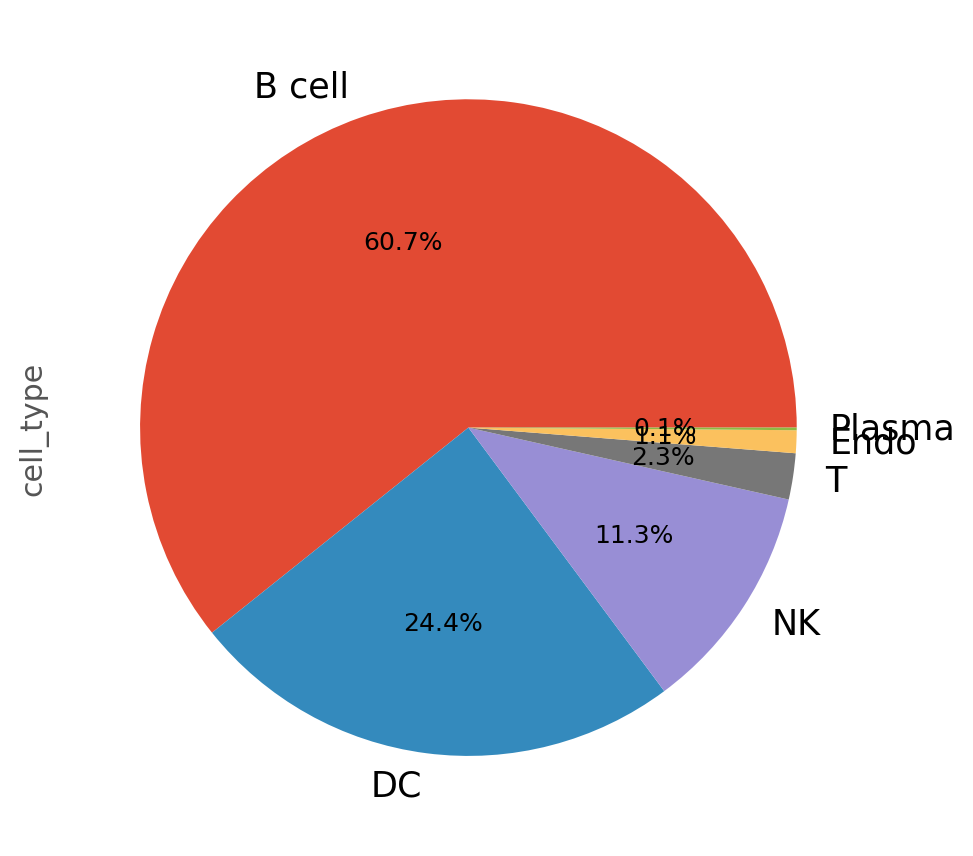

In [151]:
ax = gex_adata.obs['cell_type'].value_counts().plot(kind='pie', autopct='%1.1f%%')

<Axes: xlabel='cell_type'>

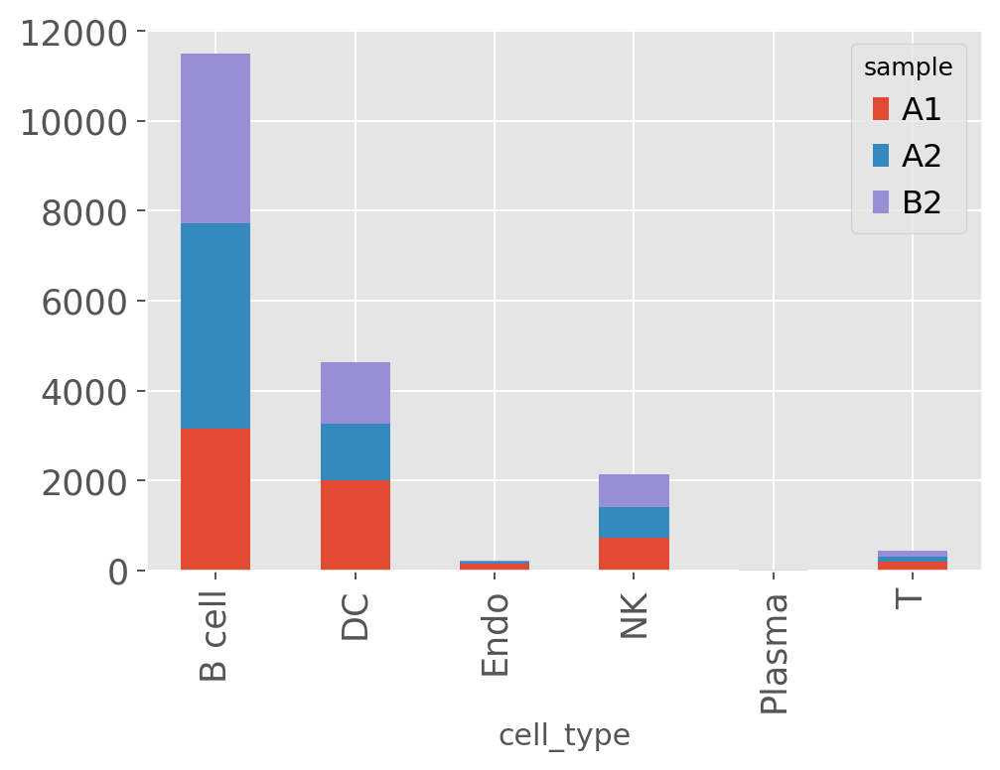

In [152]:
gex_adata.obs.groupby(['cell_type','sample']).size().unstack().plot(kind='bar',stacked=True, figsize=(6,4))

!!! It's highly recommended to save the object into a h5ad when you finish most of the analysis. This is to make sure you can reproduce the plots

In [173]:
os.makedirs(f'{work_dir}/inter_h5ad', exist_ok=True)
gex_adata_h5ad_fn = f'{work_dir}/inter_h5ad/gex_adata.h5ad'
if not os.path.exists(gex_adata_h5ad_fn):
    gex_adata.write(gex_adata_h5ad_fn)
else:
    # load the stored data for replication
    gex_adata = sc.read_h5ad(f'{work_dir}/inter_h5ad/gex_adata.h5ad')
    gex_adata.uns['log1p']["base"] = None

In [174]:
work_dir

'/media/hpc/grid/wip_drm_targetsciences/projects/p062_MIGIS_IGAN/data_2nd_batch'

#### Define the threshold for the expression
Single cells are very spares, so usually people would consdier genes expressed if they have non zero values in certain amount of cells. Some people chose 5% of all cells as cut-offs. Here we check distribution of gene average expressions to determine what percentage to use for our data sets. We also use expression of house keeping genes as reference (house keeping genes can be found here https://www.genomics-online.com/resources/16/5049/housekeeping-genes/).

In [304]:
def get_mean_expr(gex_adata, pct=0.1, genes=[]):
    '''
    this function get mean expression for each gene.
    * gex_adat: input ann data.
    '''
    hk_adata = gex_adata.copy()
    hk_adata.X = hk_adata.layers['counts'].copy()
    sc.pp.normalize_total(hk_adata, target_sum=1e4)
    sc.pp.log1p(hk_adata)
    sc.pp.filter_genes(hk_adata, min_cells=hk_adata.shape[0] * pct)
    if genes != []:
        genes = list(set(genes).intersection(hk_adata.var.index))
        hk_adata = hk_adata[:,genes]
    mean_vals = hk_adata.X.A.mean(0)
    return mean_vals, hk_adata.var.index

In [305]:
pct0, _ = get_mean_expr(gex_adata, pct=0)
pct10, expr_10genes = get_mean_expr(gex_adata, pct=0.1)
pct5, _ = get_mean_expr(gex_adata, pct=0.05)
hk_genes = ['ACTB','GAPDH','PGK1', 'PPIA','RPL13A','RPLP0', 'ARBP', 'B2M', 'YWHAZ', 'SDHA', 'TFRC', 'GUSB', 'HMBS','HPRT1','TBP']
hk, _ = get_mean_expr(gex_adata, pct=0, genes=hk_genes)

normalizing counts per cell
    finished (0:00:00)
normalizing counts per cell
    finished (0:00:00)
filtered out 16349 genes that are detected in less than 3910.9 cells
normalizing counts per cell
    finished (0:00:00)
filtered out 13788 genes that are detected in less than 1955.45 cells
normalizing counts per cell
    finished (0:00:00)


Text(0.5, 0, 'expression')

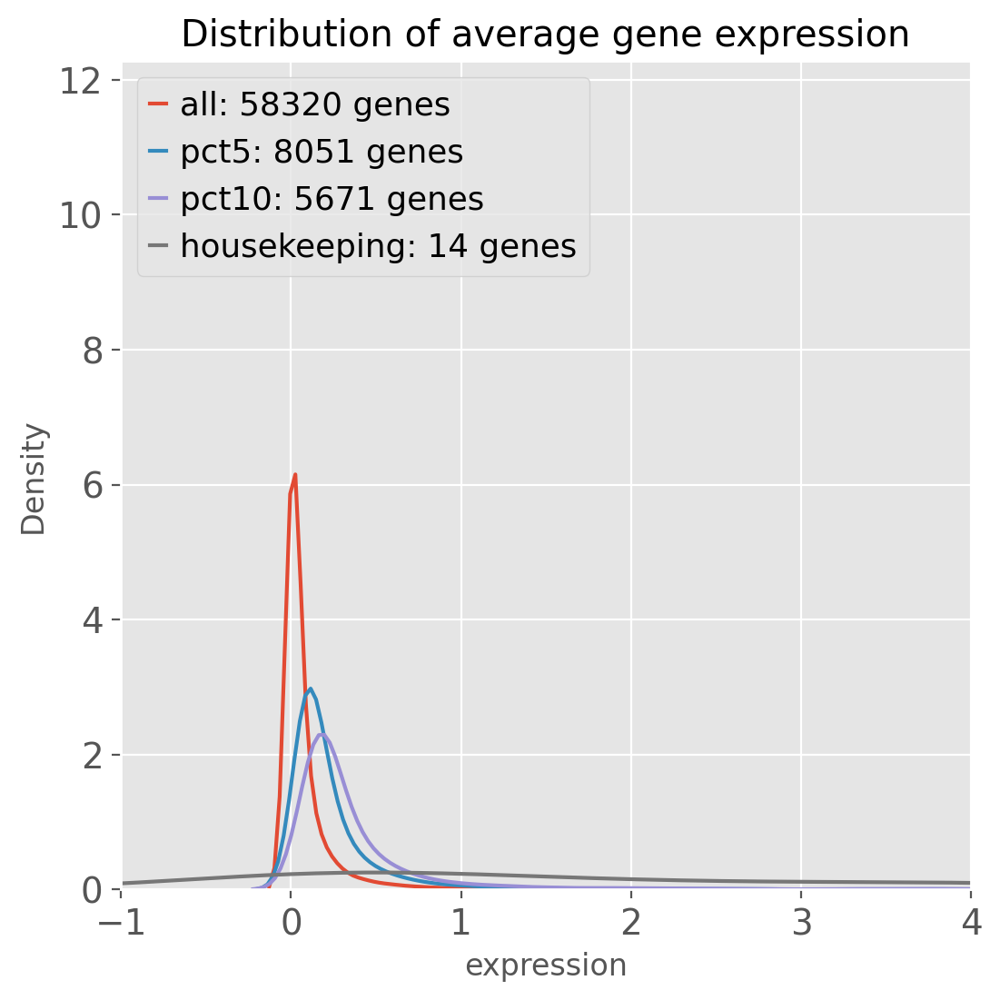

In [306]:
# filter 10 percent
fig, ax = plt.subplots(dpi=100)
_ = sb.distplot(pct0, kde=True, bins=100, hist=True, ax=ax,hist_kws=dict(alpha=0))
_ = sb.distplot(pct5, kde=True, bins=100, hist=True, ax=ax,hist_kws=dict(alpha=0))
_ = sb.distplot(pct10, kde=True, bins=100, hist=True, ax=ax,hist_kws=dict(alpha=0))
_ = sb.distplot(hk, kde=True, bins=100, hist=True, ax=ax,hist_kws=dict(alpha=0))
ax.set_xlim([-1,4])
ax.legend(['all: 58320 genes','pct5: 8051 genes','pct10: 5671 genes','housekeeping: 14 genes'],loc='upper left')
ax.set_title('Distribution of average gene expression')
ax.set_xlabel('expression')

# Antobody part
## 1. QC
### 1.1 Plot n_counts, n_proteins

In [198]:
adata

AnnData object with n_obs × n_vars = 66432 × 58441
    obs: 'sample'
    var: 'gene_ids', 'feature_types', 'genome'

In [105]:
ab_adata = adata[:,adata.var.query('feature_types == "Antibody Capture"').index]
ab_adata.obs['n_counts'] = ab_adata.X.sum(1)
ab_adata.obs['log_counts'] = np.log(ab_adata.obs['n_counts'])
ab_adata.obs['n_proteins'] = (ab_adata.X > 0).sum(1)
ab_adata.obs = pd.merge(ab_adata.obs, pd.DataFrame(gex_adata.obs['cell_type']), how='left', left_index=True, right_index=True)
ab_adata.layers['counts'] = ab_adata.X.copy()

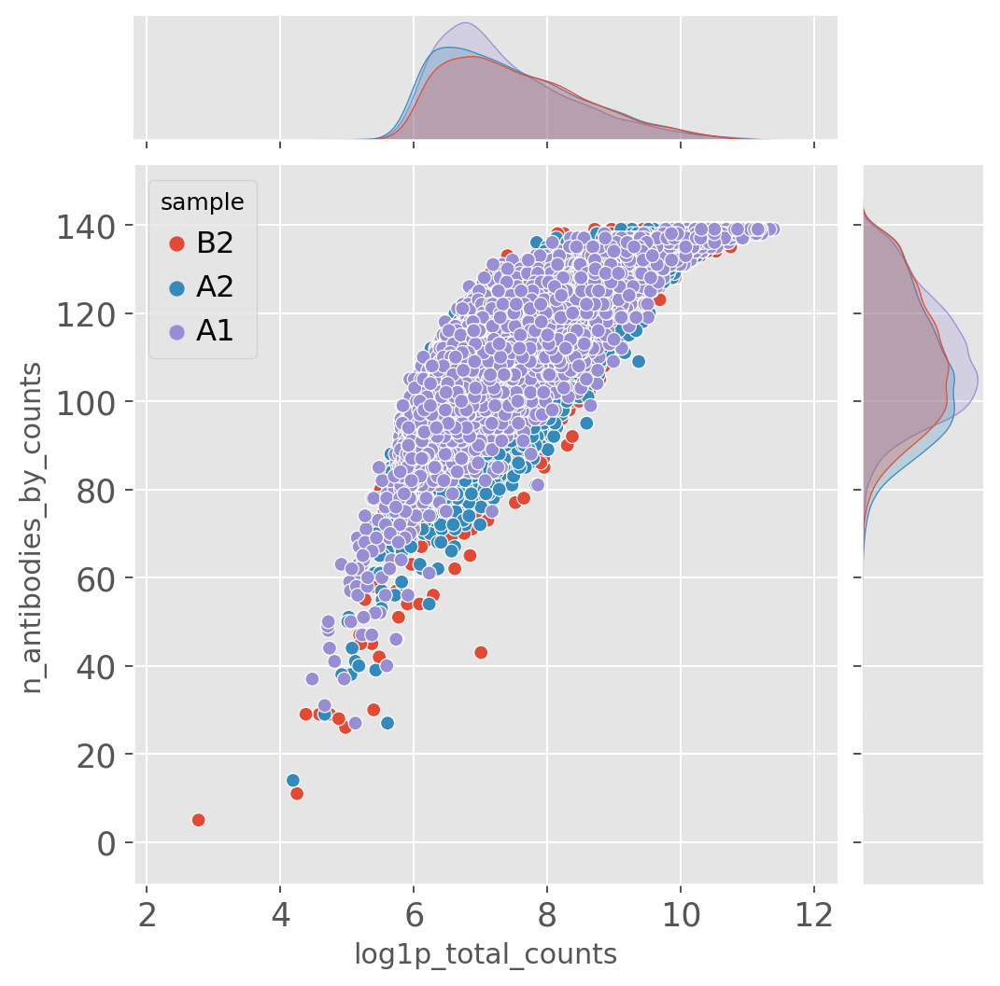

In [106]:
protein=adata[:,adata.var.query('feature_types == "Antibody Capture"').index].copy()
sc.pp.calculate_qc_metrics( protein,percent_top=(5, 10, 15),var_type="antibodies",inplace=True,)
sns.jointplot( data=protein.obs,x="log1p_total_counts", y="n_antibodies_by_counts",hue="sample")

In [107]:
protein

AnnData object with n_obs × n_vars = 33006 × 139
    obs: 'sample', 'n_antibodies_by_counts', 'log1p_n_antibodies_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_5_antibodies', 'pct_counts_in_top_10_antibodies', 'pct_counts_in_top_15_antibodies'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts'

In [108]:
ab_adata.shape

(33006, 139)

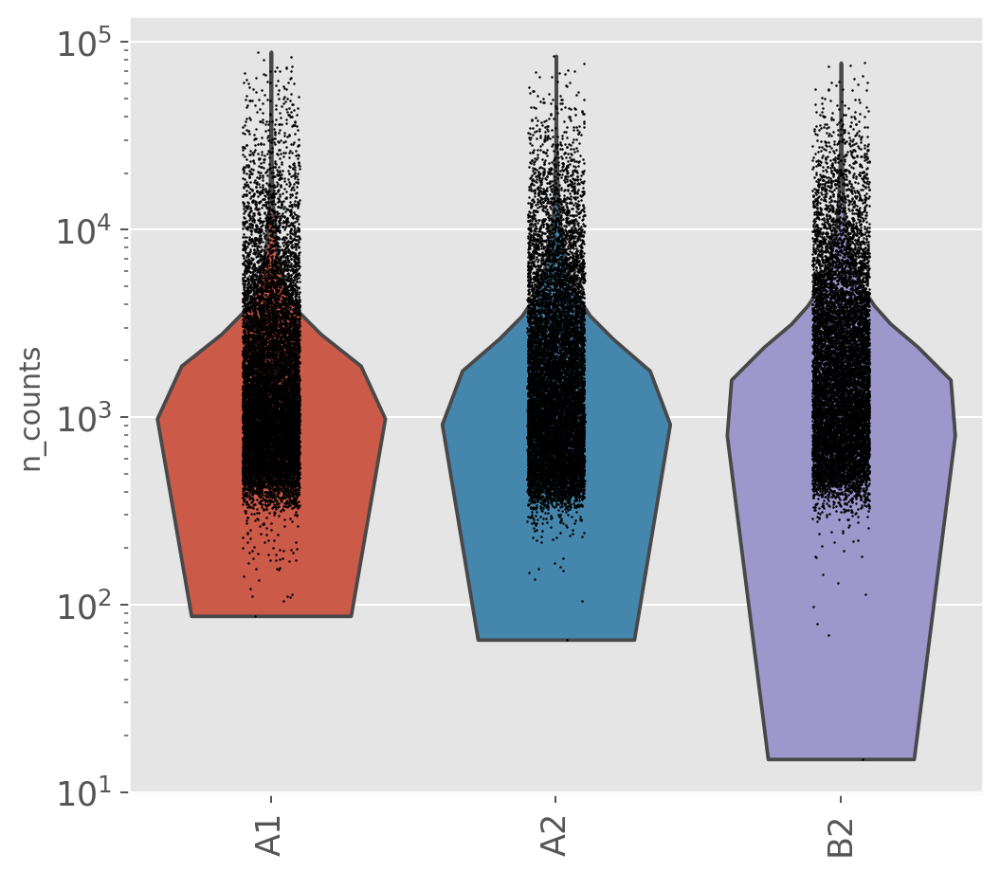

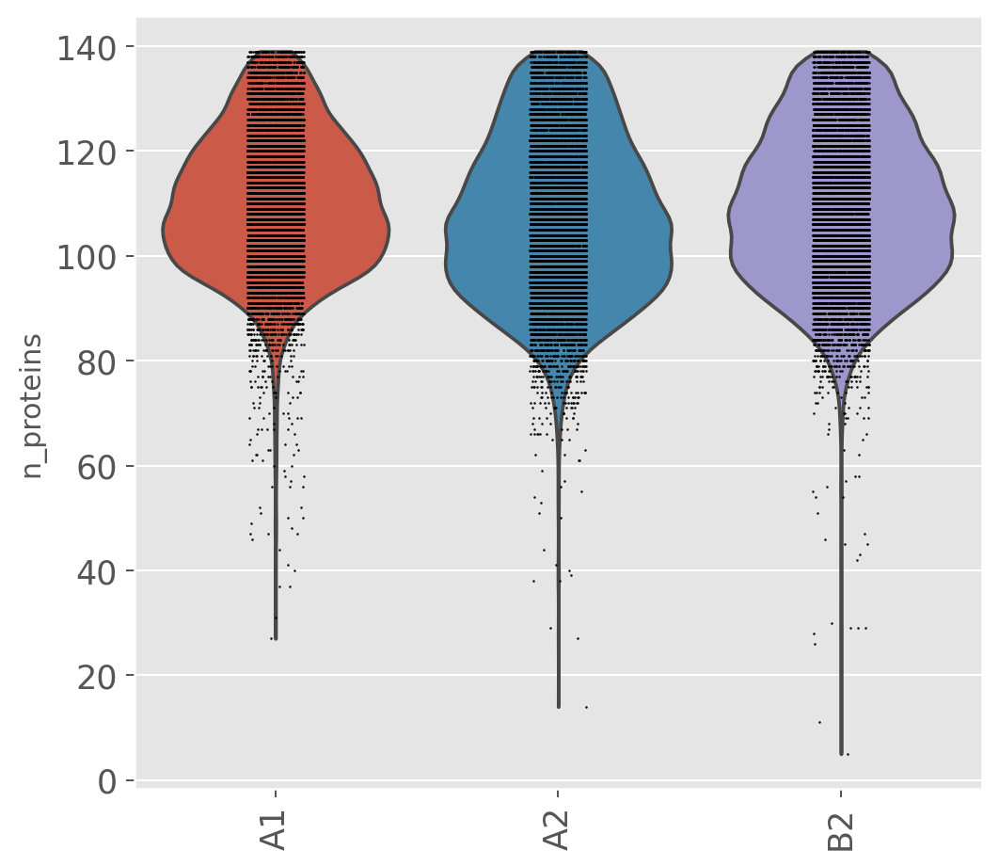

In [109]:
sc.pl.violin(ab_adata, 'n_counts', groupby='sample', size=1, log=True,cut=0,rotation=90, figsize=(2,2))
sc.pl.violin(ab_adata, 'n_proteins', groupby='sample',rotation=90)

Text(0, 0.5, 'n_proteins')

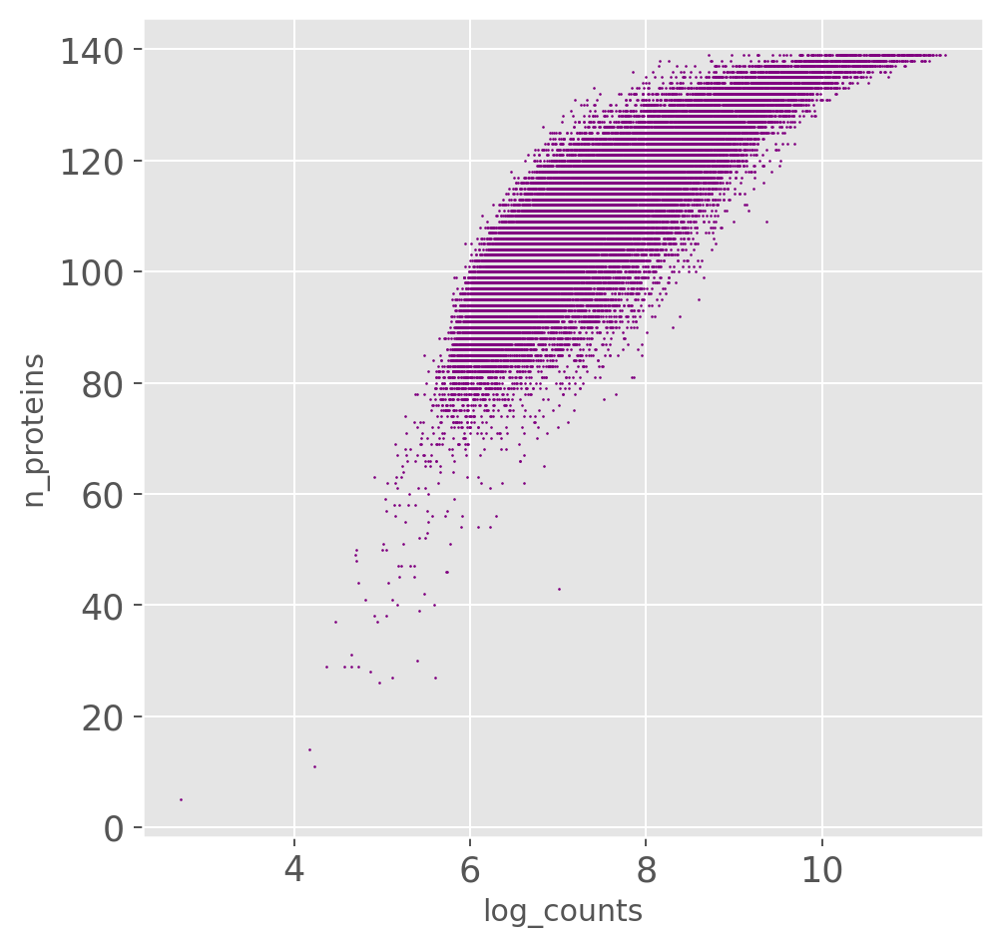

In [110]:
_ = plt.scatter(ab_adata.obs['log_counts'], ab_adata.obs['n_proteins'], color='purple', s=0.3)
plt.xlabel('log_counts')
plt.ylabel('n_proteins')

In [216]:
ab_adata.obs

,sample,n_counts,log_counts,n_proteins,cell_type
AAACCTGAGAGGGATA-B1,B1,366.0,5.902633,77,NaN
AAACCTGAGATCCGAG-B1,B1,330.0,5.799093,76,B cell
AAACCTGAGCGCTTAT-B1,B1,459.0,6.129050,91,NaN
AAACCTGAGCGGATCA-B1,B1,1236.0,7.119636,114,NaN
AAACCTGAGCTGCCCA-B1,B1,637.0,6.456769,87,NaN
...,...,...,...,...,...
TTTGTCATCAGTCAGT-B2,B2,481.0,6.175867,89,B cell
TTTGTCATCAGTGCAT-B2,B2,510.0,6.234411,98,B cell
TTTGTCATCATTGCCC-B2,B2,744.0,6.612041,90,NaN
TTTGTCATCCGTTGCT-B2,B2,1005.0,6.912743,94,NK


In [311]:
median(ab_adata.obs.n_proteins),median(A1_ab_adata.obs.n_proteins),median(A2_ab_adata.obs.n_proteins),median(B1_ab_adata.obs.n_proteins),median(B2_ab_adata.obs.n_proteins)

(105.0, 110, 106.0, 102.0, 109)

### 1.2 Filter cells
Since we have filtered some cells in the scRNAseq part, so here we will filter based on that data

In [111]:
A1_ab_adata=ab_adata[ab_adata.obs.query('sample =="A1"').index,]
A2_ab_adata=ab_adata[ab_adata.obs.query('sample =="A2"').index,]
B1_ab_adata=ab_adata[ab_adata.obs.query('sample =="B1"').index,]
B2_ab_adata=ab_adata[ab_adata.obs.query('sample =="B2"').index,]

In [112]:
sc.pp.filter_cells(ab_adata, min_genes=50)
print('Number of cells after min genes filter: {:d}'.format(ab_adata.n_obs))

filtered out 36 cells that have less than 50 genes expressed
Number of cells after min genes filter: 32970


## 2 Demultiplex control and IgAN sample
Collaborater used hash tag to multiplex IgAN/control samples in a single run. So we need to use HTO sequence to demultiplex the samples. Based on their experience, manual demultiplexing performs much better than automatic methods.
First need to normalize CITE-Seq data, the method is CLR (centered log ratio).  log(HTO count / genometric_mean(all feature counts))

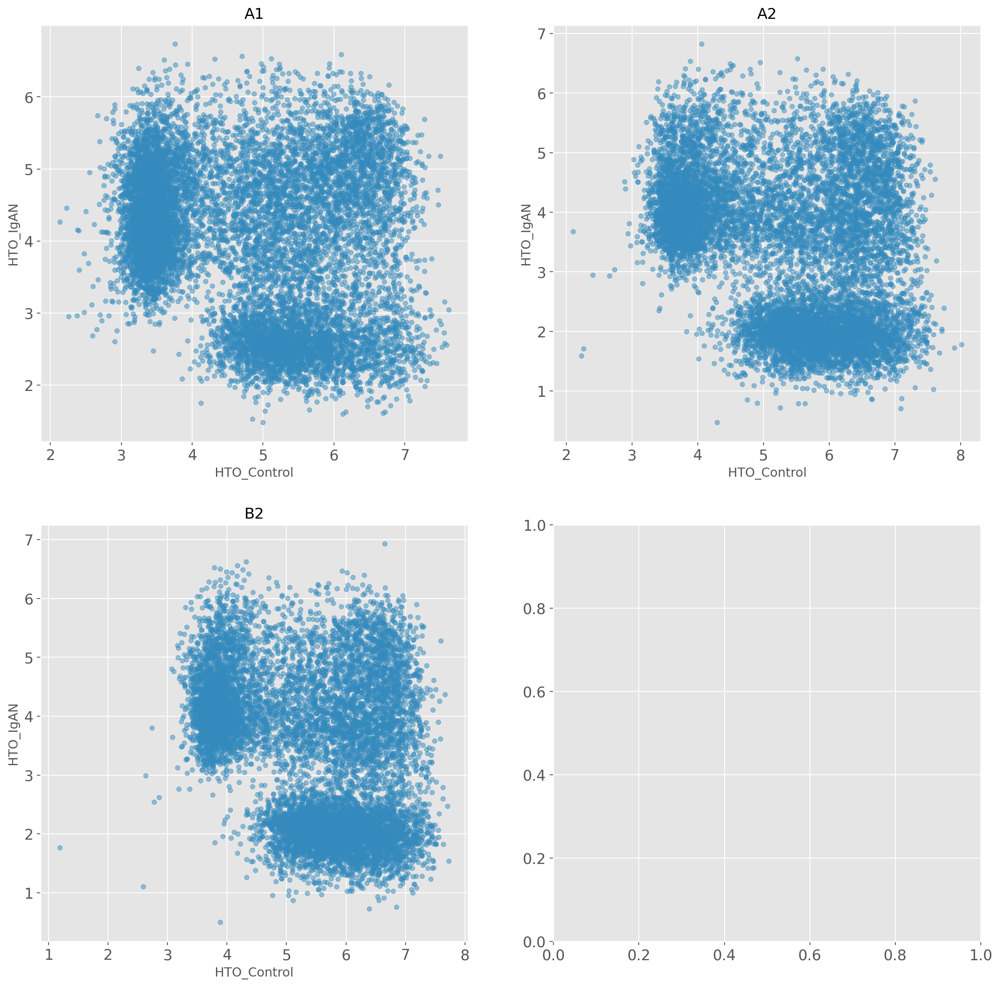

In [113]:
# scatter plot show normalized count of sample hash tags
fig, axs = plt.subplots(2, 2, figsize=(16,16),sharex=False,sharey=False)
ab_adata_list = []
hto_list = []
sps = sorted(ab_adata.obs['sample'].unique())
for i,sp in enumerate(sps):
    row = i // 2
    col = i % 2
    ad = ab_adata[ab_adata.obs['sample']==sp]
    pt.pp.clr(ad, inplace=True, axis=1)
    ab_adata_list.append(ad)
    hto_df = ad[:,['HTO_IgAN', 'HTO_Control']].to_df()
    hto_df['sample'] = sp
    hto_list.append(hto_df)
    hto_df.plot.scatter('HTO_Control', 'HTO_IgAN' ,title=sp,alpha=0.5,ax=axs[row, col])

Based on the plots, we manually determine the threshold for each sample <br/>
A1: <br/>
&nbsp;&nbsp;&nbsp;&nbsp;control: HTO_Control > 4 and HTO_IgAN < 3.2 <br/>
&nbsp;&nbsp;&nbsp;&nbsp;IgAN:    HTO_Control < 4 and HTO_IgAN > 3 <br/>
A2: <br/>
&nbsp;&nbsp;&nbsp;&nbsp;control: HTO_Control > 4.5 and HTO_IgAN < 2.8 <br/>
&nbsp;&nbsp;&nbsp;&nbsp;IgAN:    HTO_Control < 4.5 and HTO_IgAN > 3 <br/>
B1: <br/>
&nbsp;&nbsp;&nbsp;&nbsp;control: HTO_Control > 4 and HTO_IgAN < 3 <br/>
&nbsp;&nbsp;&nbsp;&nbsp;IgAN:    HTO_Control < 4 and HTO_IgAN > 2.5 <br/>
B2: <br/>
&nbsp;&nbsp;&nbsp;&nbsp;control: HTO_Control > 4.5 and HTO_IgAN < 3 <br/>
&nbsp;&nbsp;&nbsp;&nbsp;IgAN:    HTO_Control < 4.5 and HTO_IgAN > 3 <br/>

In [114]:
# add sample annotation based on the threshold
def demulti(row):
    '''
    demultiplex samples using manual defined thresholds
    '''
    if row['sample'] == 'A1': 
        if row['HTO_Control'] > 4 and row['HTO_IgAN'] < 3.2:
            return 'control'
        elif row['HTO_Control'] < 4 and row['HTO_IgAN'] > 3:
            return 'IgAN'
        else:
            return 'doublet'
    if row['sample'] == 'A2': 
        if row['HTO_Control'] > 4.5 and row['HTO_IgAN'] < 2.8:
            return 'control'
        elif row['HTO_Control'] < 4.5 and row['HTO_IgAN'] > 3:
            return 'IgAN'
        else:
            return 'doublet'
    if row['sample'] == 'B1': 
        if row['HTO_Control'] > 4 and row['HTO_IgAN'] < 3:
            return 'control'
        elif row['HTO_Control'] < 4 and row['HTO_IgAN'] > 2.5:
            return 'IgAN'
        else:
            return 'doublet'
    if row['sample'] == 'B2': 
        if row['HTO_Control'] > 4.5 and row['HTO_IgAN'] < 3:
            return 'control'
        elif row['HTO_Control'] < 4.5 and row['HTO_IgAN'] > 3:
            return 'IgAN'
        else:
            return 'doublet'

In [115]:
# add demultiplex information into the main antibody adata object
hto_df = pd.concat(hto_list) 
hto_df['condition'] = hto_df.apply(lambda x: demulti(x), axis=1)

ab_adata.obs = pd.merge(ab_adata.obs, hto_df[['condition','HTO_IgAN','HTO_Control']], how='left', left_index=True, right_index=True)
ab_adata.obs['condition'].value_counts()

doublet    11412
control    11255
IgAN       10303
Name: condition, dtype: int64

In [116]:
# get detailed portion of cells in each run
ab_adata.obs.groupby(['sample','condition']).size().unstack().apply(lambda x: x/sum(x), axis=1).round(2)

condition,IgAN,control,doublet
sample,,,
A1,0.36,0.26,0.37
A2,0.30,0.37,0.33
B2,0.27,0.40,0.33


<Axes: xlabel='sample'>

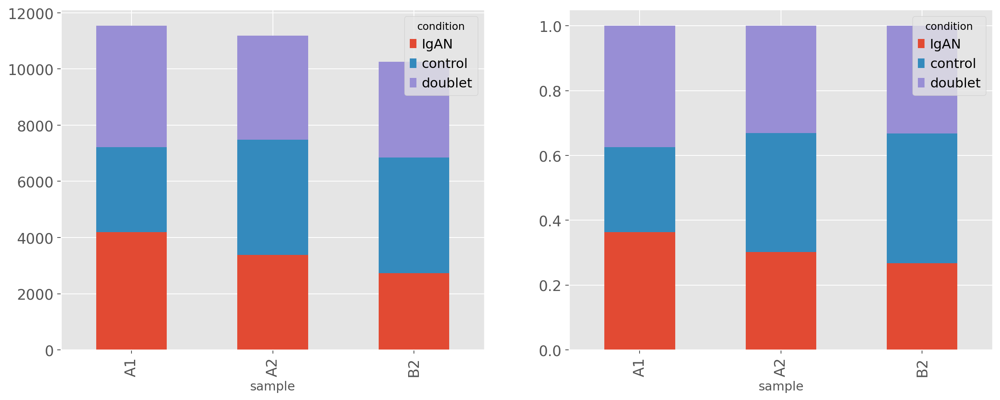

In [117]:
# plot the distribution of demultiplex condition in different runs
fig, axes = plt.subplots(1,2, figsize=(16,6))
hto_df.groupby(['sample','condition']).size().unstack().plot(kind='bar',stacked=True, ax=axes[0])
hto_df.groupby(['sample','condition']).size().unstack().apply(lambda x: x/sum(x), axis=1).plot(kind='bar',stacked=True, ax=axes[1])

In [118]:
# remove doublet
ab_adata = ab_adata[ab_adata.obs['condition'] != 'doublet']
ab_adata = ab_adata[:, [g for g in ab_adata.var.index if g not in ['HTO_IgAN','HTO_Control']]]

<Axes: xlabel='sample'>

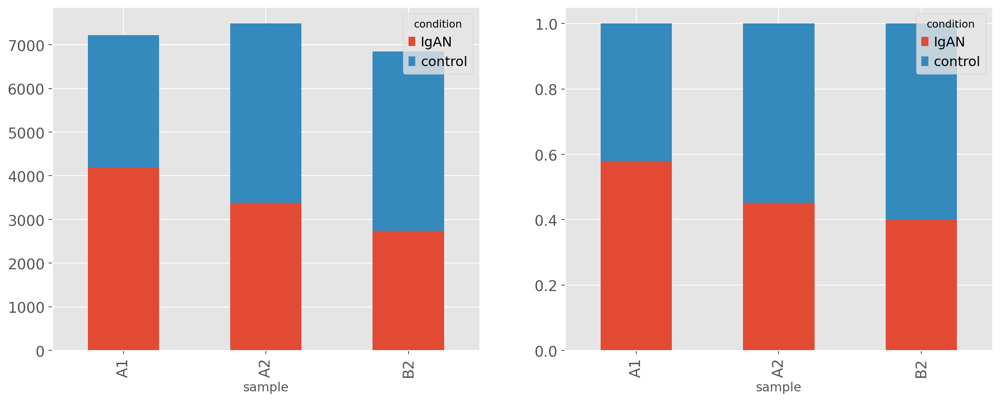

In [119]:
# cell distribution after removal of doublet
fig, axes = plt.subplots(1,2, figsize=(16,6))
ab_adata.obs.groupby(['sample','condition']).size().unstack().plot(kind='bar',stacked=True, ax=axes[0])
ab_adata.obs.groupby(['sample','condition']).size().unstack().apply(lambda x: x/sum(x), axis=1).plot(kind='bar',stacked=True, ax=axes[1])

The above figure shows in A2 most cells are from control samples.

In [120]:
# get detailed portion of cells in each run
ab_adata.obs.groupby(['sample','condition']).size().unstack().apply(lambda x: x/sum(x), axis=1).round(2)

condition,IgAN,control
sample,,
A1,0.58,0.42
A2,0.45,0.55
B2,0.40,0.60


### select proteins that are expressed in at least 10% of the cells

In [121]:
def get_pr_mean_expr(ab_adata, pct=0.1, genes=[]):
    '''
    this function get mean expression for each gene.
    * ab_adata: input ann data.
    '''
    hk_adata = ab_adata.copy()
    sc.pp.filter_genes(hk_adata, min_cells=hk_adata.shape[0] * pct)
    if genes != []:
        genes = list(set(genes).intersection(hk_adata.var.index))
        hk_adata = hk_adata[:,genes]
    mean_vals = hk_adata.X.A.mean(0)
    return mean_vals, hk_adata.var.index

In [122]:
# get proteins expressed in at least 10 
ab_pct10, ab_pct10_pr = get_pr_mean_expr(ab_adata, pct=0.1)

The above results shows all proteins are expressed in at least 10% of the cells

## 3 PCA

In [123]:
sc.tl.pca(ab_adata)
sc.pp.neighbors(ab_adata)
sc.tl.umap(ab_adata, random_state=1)

computing PCA
    with n_comps=50
    finished (0:00:02)
computing neighbors
    using 'X_pca' with n_pcs = 50
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:03)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:12)


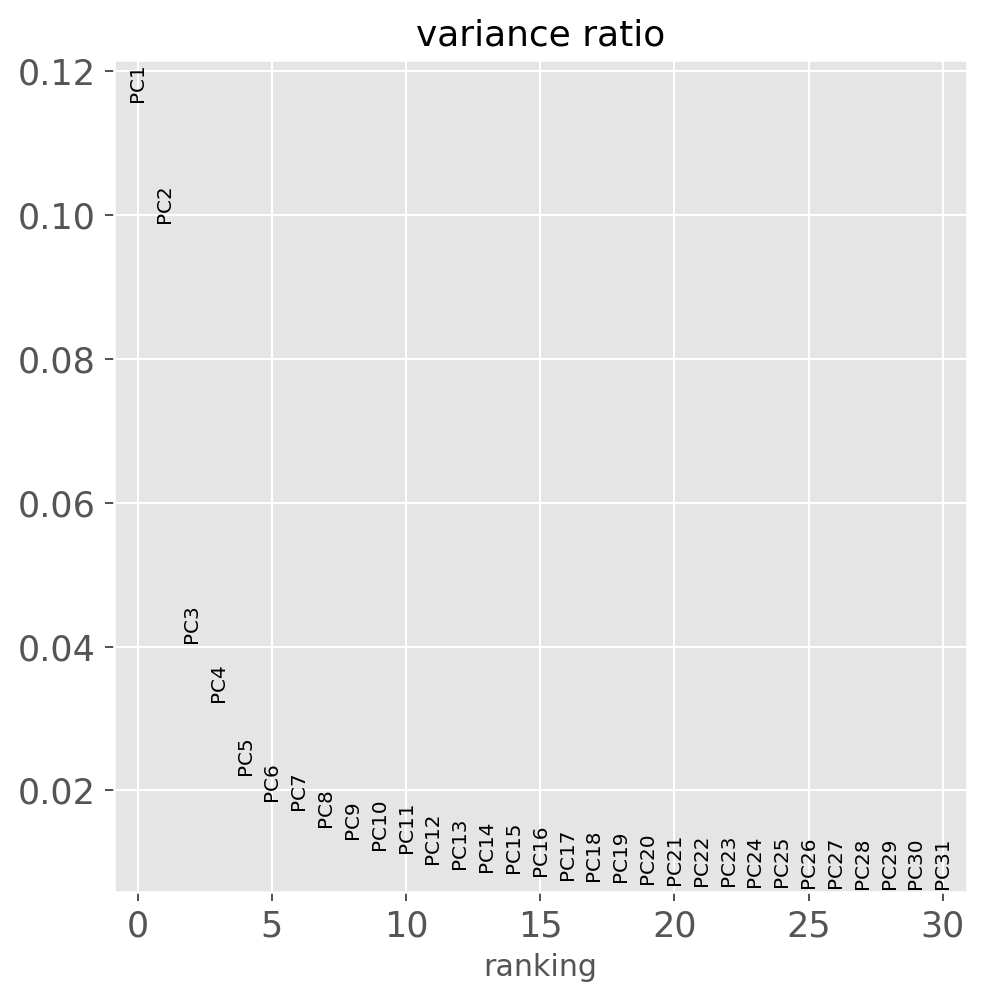

In [326]:
sc.pl.pca_variance_ratio(ab_adata)

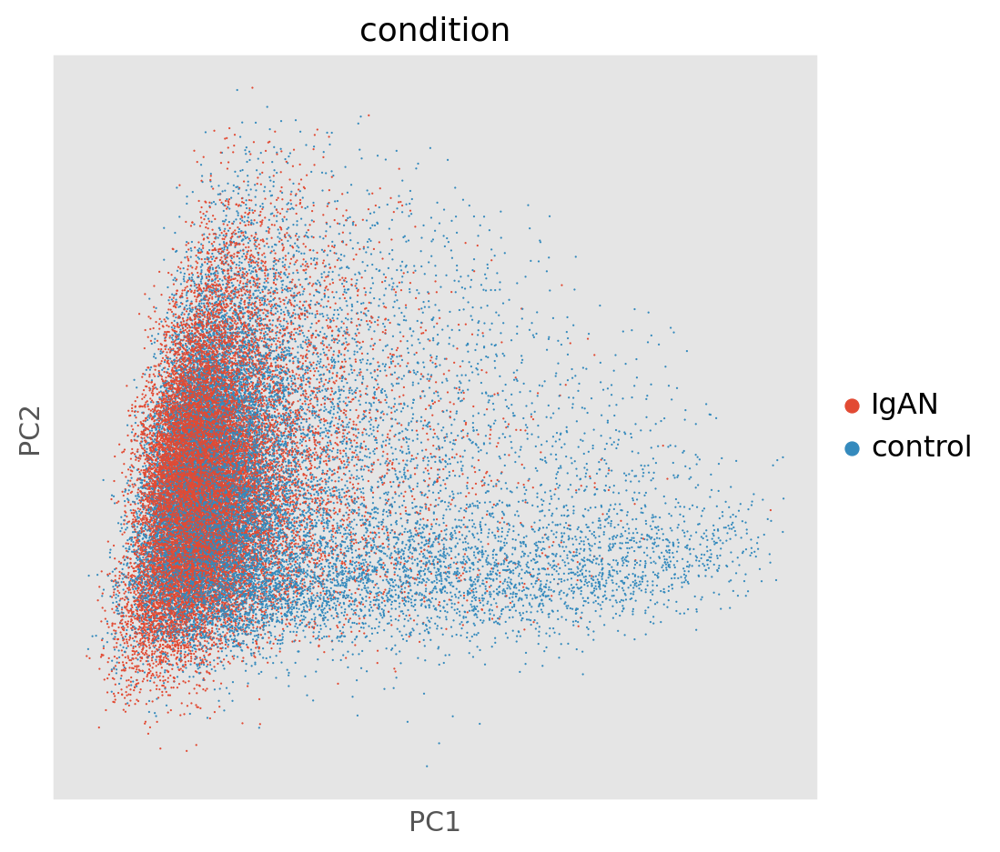

In [327]:
sc.pl.pca(ab_adata, color='condition')

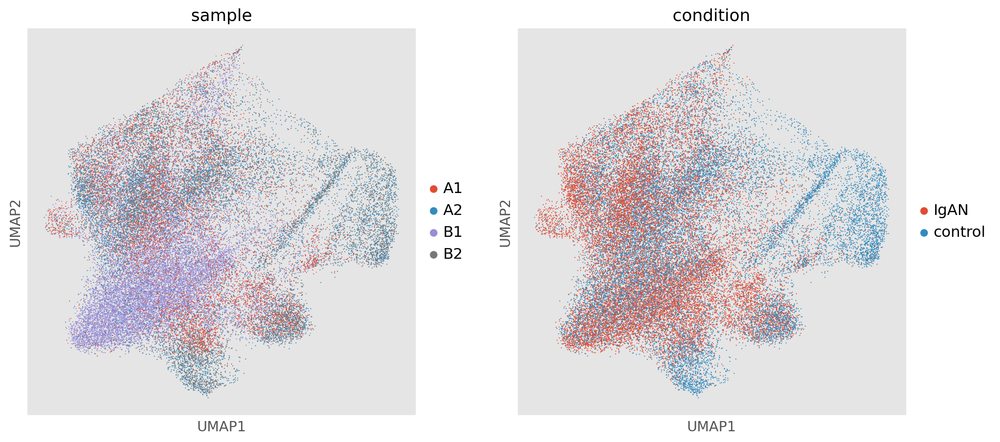

In [328]:
sc.pl.umap(ab_adata, color=['sample','condition'])

In [357]:
ab_adata_fn = f'{work_dir}/inter_h5ad/ab_adata.h5ad'
if not os.path.exists(ab_adata_fn):
    ab_adata.write(ab_adata_fn)
else:
    ab_adata = sc.read_h5ad(ab_adata_fn)

# Multiomic Integration
The following anlaysis follows the tutorial here https://muon-tutorials.readthedocs.io/en/latest/cite-seq/1-CITE-seq-PBMC-5k.html
## 1. Intersect gene names

In [124]:
#gex_adata = sc.read_h5ad(f'{work_dir}/inter_h5ad/gex_adata.h5ad')
gex_adata.uns['log1p'] = {'base':None}
#ab_adata = sc.read_h5ad(f'{work_dir}/inter_h5ad/ab_adata.h5ad')
mdata = mu.MuData({'rna': gex_adata, 'prot': ab_adata})
mu.pp.intersect_obs(mdata)

In [125]:
# Calculate the UMAP using harmany
sc.pp.neighbors(mdata['rna'], use_rep = 'X_pca_harmony')

computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:03)


In [126]:
mu.tl.leiden(mdata, resolution=[1.5, .1], random_state=1)

In [127]:
ab_adata.var["highly_variable"] = True
mdata.update()

In [365]:
mdata.write(f'{work_dir}/inter_h5ad/mdata.h5mu')

/usr/local/lib/python3.10/dist-packages/anndata/_core/anndata.py:1235: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[key] = c
/usr/local/lib/python3.10/dist-packages/anndata/_core/anndata.py:1235: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[key] = c


# Check BCR sequence
We also have sequenced BCR for the cells. This dataset could tell us which cells express B cvell IgA receptor and we can use this information to correct cell type annotation for B cells that are annotated as other cell types

## 1. read the data

In [333]:
# readin the data stored in previous steps
mdata = mu.read_h5mu(f'{work_dir}/inter_h5ad/mdata.h5mu')
gex_adata = mdata['rna']
gex_adata.uns['log1p']["base"] = None

In [128]:
mdata

MuData object with n_obs × n_vars = 18937 × 20482
  obs:	'leiden'
  var:	'gene_ids', 'feature_types', 'genome', 'highly_variable'
  uns:	'leiden'
  2 modalities
    rna:	18937 x 20345
      obs:	'sample', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'n_genes', 'mt_frac', 'ribo_frac', 'largest_gene', 'largest_count_frac', 'n_counts', 'size_factors', 'S_score', 'G2M_score', 'phase', 'leiden_r0.5', 'cell_type'
      var:	'gene_ids', 'feature_types', 'genome', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
      uns:	'sample_colors', 'log1p', 'hvg', 'pca', 'scanorama', 'umap', 'hmny', 'leiden', 'leiden_r0.5_colors', 'rank_genes_r0.5', 'cell_type_colors', 'neighbors'
      obsm:	'X_pca', 'X_scanorama', 'X_pca_harmony', 'X_umap'
      varm:	'PCs'
      layers:	'counts'
      obsp:	'scanorama_distances', 'scanorama_connectivities', 'hmny_distances', 'hmny_connectivities', 'distances', 'connectivities'
    prot:	18937 x 137
      obs:	'sample', 'n_counts', 'log_counts', 'n_proteins', 'cell_type', 'n_genes', 'condition', 'HTO_IgAN', 'HTO_Control'
      var:	'gene_ids', 'feature_types', 'genome', 'highly_variable'
      uns:	'sample_colors', 'pca', 'neighbors', 'umap'
      obsm:	'X_pca', 'X_umap'
      varm:	'PCs'
      layers:	'counts'
      obsp:	'distances', 'connectivities'

In [129]:
bcd_condi_dict =  mdata.obs['prot:condition'].to_dict() # {cell barcode: IgAN/control}
gex_adata.obs['condition'] = gex_adata.obs.index.map(lambda x: bcd_condi_dict[x])

In [130]:
gex_adata.obs['condition'].value_counts()

control    9695
IgAN       9242
Name: condition, dtype: int64

In [131]:
# get immune receptor information from BCR-Seq
contig_anno_fns = sorted(glob.glob(f'{work_dir}/bcr/*_filtered_contig_annotations.csv'))
bcr_list = []
for contig in contig_anno_fns:
    sample = ''.join(contig.split('/')[-1].split('_')[:2])
    bcr_tmp = ir.io.read_10x_vdj(contig)
    bcr_tmp.obs.index = bcr_tmp.obs.index.map(lambda x: x.split('-')[0] + '-' + sample)
    bcr_list.append(bcr_tmp)
bcr = sc.concat(bcr_list)
gex_adata.obs = pd.merge(gex_adata.obs, bcr.obs, how='left', left_index=True, right_index=True)
ir.tl.chain_qc(gex_adata)

In [390]:
bcr.obs

,is_cell,high_confidence,multi_chain,extra_chains,IR_VJ_1_c_call,IR_VJ_2_c_call,IR_VDJ_1_c_call,IR_VDJ_2_c_call,IR_VJ_1_consensus_count,IR_VJ_2_consensus_count,...,IR_VDJ_2_locus,IR_VJ_1_productive,IR_VJ_2_productive,IR_VDJ_1_productive,IR_VDJ_2_productive,IR_VJ_1_v_call,IR_VJ_2_v_call,IR_VDJ_1_v_call,IR_VDJ_2_v_call,has_ir
cell_id,,,,,,,,,,,,,,,,,,,,,
AAACCTGAGACCACGA-A1,True,True,False,[],IGKC,NaN,NaN,NaN,458.0,NaN,...,NaN,True,None,None,None,IGKV3-20,NaN,NaN,NaN,True
AAACCTGAGATACACA-A1,True,True,False,[],IGLC2,NaN,IGHA1,NaN,227.0,NaN,...,NaN,True,None,True,None,IGLV2-18,NaN,IGHV5-10-1,NaN,True
AAACCTGAGCTAGTTC-A1,True,True,False,[],IGKC,NaN,IGHA1,NaN,296.0,NaN,...,NaN,True,None,True,None,IGKV3-20,NaN,IGHV1-2,NaN,True
AAACCTGAGGCTCAGA-A1,True,True,False,[],IGKC,NaN,NaN,NaN,486.0,NaN,...,NaN,True,None,None,None,IGKV2-30,NaN,NaN,NaN,True
AAACCTGAGGGTCTCC-A1,True,True,False,[],IGKC,NaN,IGHM,NaN,141.0,NaN,...,NaN,True,None,True,None,IGKV1D-39,NaN,IGHV4-34,NaN,True
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTTGTCACACTTACGA-B2,True,True,False,[],IGKC,NaN,IGHA1,NaN,62827.0,NaN,...,NaN,True,None,True,None,IGKV1-9,NaN,IGHV4-59,NaN,True
TTTGTCACAGTACACT-B2,True,True,False,[],IGLC2,NaN,IGHM,NaN,321.0,NaN,...,NaN,True,None,True,None,IGLV2-23,NaN,IGHV1-69D,NaN,True
TTTGTCAGTCTCAACA-B2,True,True,False,[],IGLC2,NaN,IGHM,NaN,376.0,NaN,...,NaN,True,None,True,None,IGLV7-43,NaN,IGHV1-18,NaN,True


In [391]:
gex_adata.obs

,sample,n_genes_by_counts,log1p_n_genes_by_counts,total_counts,log1p_total_counts,pct_counts_in_top_50_genes,pct_counts_in_top_100_genes,pct_counts_in_top_200_genes,pct_counts_in_top_500_genes,n_genes,...,IR_VJ_2_v_call,IR_VDJ_1_v_call,IR_VDJ_2_v_call,has_ir,receptor_type,receptor_subtype,chain_pairing,IgA,init_cell_type,b_cell_bcr
AAACCTGAGATCCGAG-B1,B1,652,6.481577,3186.0,8.066835,72.159448,79.127433,85.812932,95.229127,652,...,NaN,IGHV4-34,NaN,True,BCR,IGH+IGK,single pair,IgA+,B cell,B cell and BCR
AAACCTGAGGGAAACA-B1,B1,944,6.851185,3197.0,8.070281,54.488583,65.905536,74.476071,86.111980,944,...,NaN,NaN,NaN,NaN,no IR,no IR,no IR,IgA-,B cell,B cell and no BCR
AAACCTGAGGTAAACT-B1,B1,933,6.839476,2915.0,7.977968,50.120069,63.259005,72.452830,85.145798,933,...,NaN,NaN,NaN,NaN,no IR,no IR,no IR,IgA-,B cell,B cell and no BCR
AAACCTGAGTAGGCCA-B1,B1,824,6.715383,2226.0,7.708411,47.888589,61.185984,71.473495,85.444744,824,...,NaN,NaN,NaN,True,BCR,IGH+IGK,orphan VJ,IgA-,B cell,B cell and BCR
AAACCTGGTCATATCG-B1,B1,894,6.796824,2465.0,7.810353,47.586207,60.567951,70.466531,84.016227,894,...,NaN,NaN,NaN,NaN,no IR,no IR,no IR,IgA-,B cell,B cell and no BCR
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTTGTCAGTTAGTGGG-B2,B2,2271,7.728416,9183.0,9.125218,39.649352,53.914843,64.401612,76.576282,2271,...,NaN,NaN,NaN,NaN,no IR,no IR,no IR,IgA-,DC,other cell and no BCR
TTTGTCATCAAGGTAA-B2,B2,989,6.897705,2194.0,7.693937,38.103920,50.729262,62.534184,77.711942,989,...,NaN,NaN,NaN,NaN,no IR,no IR,no IR,IgA-,NK,other cell and no BCR
TTTGTCATCAGTCAGT-B2,B2,1177,7.071573,2939.0,7.986165,41.714869,53.181354,63.082681,76.964954,1177,...,NaN,IGHV2-70,NaN,True,BCR,IGH+IGK,single pair,IgA-,B cell,B cell and BCR
TTTGTCATCAGTGCAT-B2,B2,908,6.812345,2294.0,7.738488,43.374019,55.579773,66.870096,82.214473,908,...,NaN,NaN,NaN,NaN,no IR,no IR,no IR,IgA-,B cell,B cell and no BCR


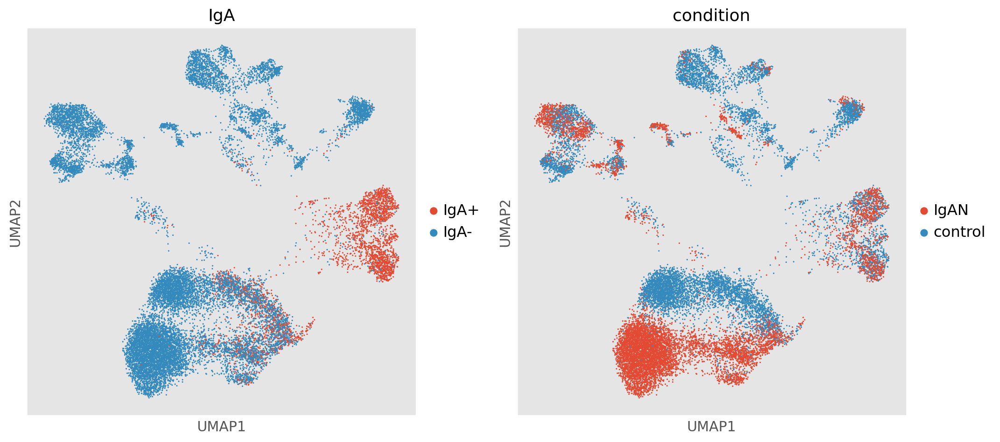

In [132]:
# add column to annotate if the cell is IgA+ or IgA-
iga_genes = ['IGHA1', 'IGHA2']
gex_adata.obs['IgA'] = gex_adata.obs.apply(lambda row: 'IgA+' if ( (row['IR_VDJ_1_c_call'] in iga_genes) or (row['IR_VDJ_2_c_call'] in iga_genes)) else 'IgA-' , axis=1)
sc.pl.umap(gex_adata, color=['IgA','condition'])

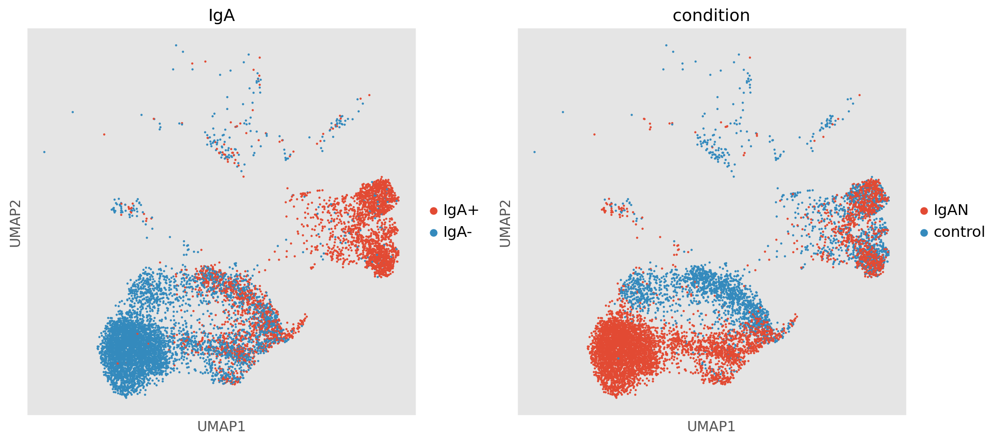

In [133]:
# extract cells that have bcr 
bcr_adata = gex_adata[gex_adata.obs['receptor_type']=='BCR',:]
sc.pl.umap(bcr_adata, color=['IgA','condition'])

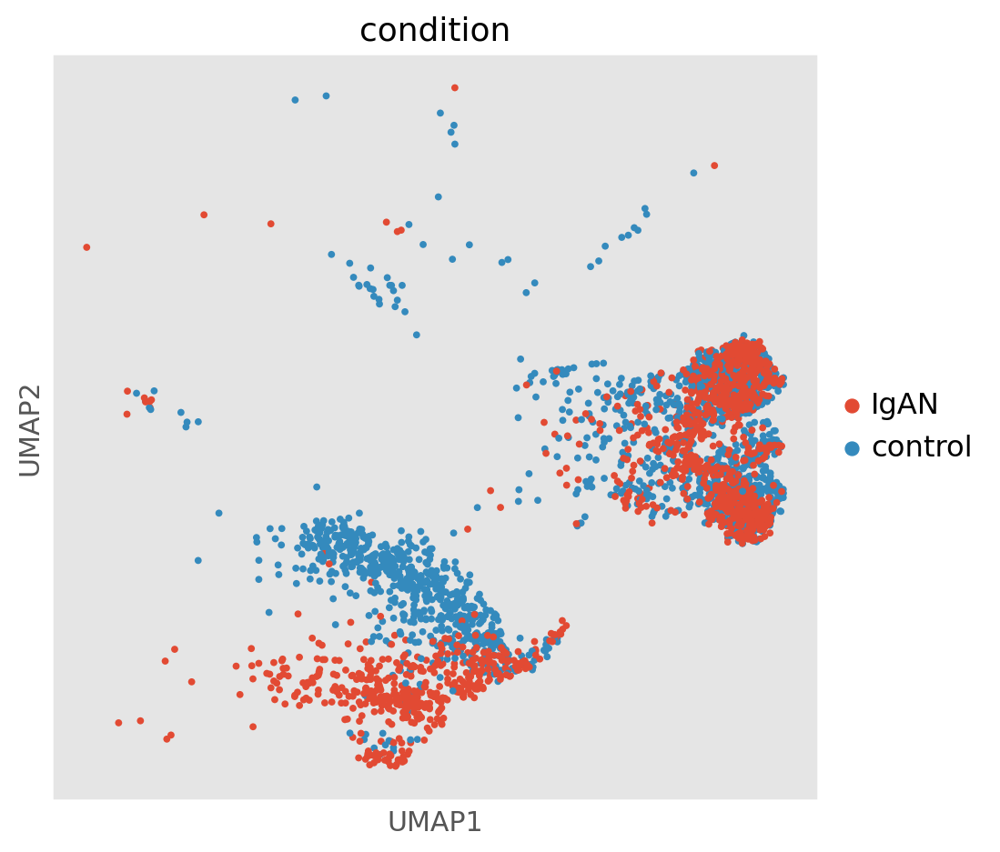

In [134]:
# umap for IgA+ B cells
sc.pl.umap(bcr_adata[bcr_adata.obs.query('IgA == "IgA+"').index,:], color=['condition'])

In [135]:
gex_adata.obs[['sample', 'condition']].value_counts()

sample  condition
A2      control      3455
B2      control      3448
A1      IgAN         3439
A2      IgAN         3219
A1      control      2792
B2      IgAN         2584
dtype: int64

In [139]:
gex_adata.obs['IgA'].value_counts()

IgA-    15824
IgA+     3113
Name: IgA, dtype: int64

Next we correct annotation of non-B cells with IgA to B cells, in the chain_pairing column, if the value is 'no IR', it means BCR was not detected in the cells.

In [140]:
print('number of corrected B cells annotation using BCR seq', )
miss_class_cells = gex_adata.obs.query('chain_pairing != "no IR" and cell_type != "B cell"').index
print(miss_class_cells.shape[0])
print(gex_adata.obs.query('chain_pairing != "no IR" and cell_type != "B cell"')['cell_type'].value_counts())

number of corrected B cells annotation using BCR seq
2646
Plasma    1996
DC         559
NK          81
Endo         9
T            1
B cell       0
Name: cell_type, dtype: int64


<Axes: xlabel='cell_type'>

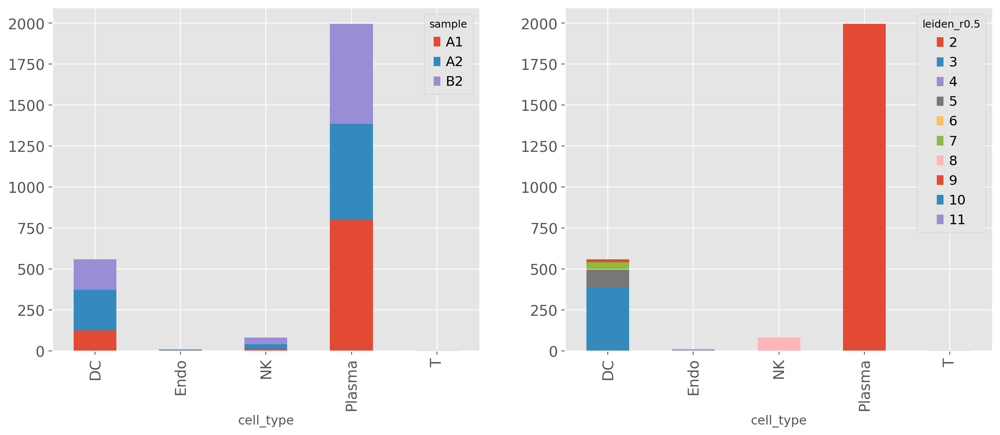

In [141]:
fig, axes = plt.subplots(1,2, figsize=(16,6))
miss_adata = gex_adata[miss_class_cells,:]
miss_adata.obs.groupby(['cell_type','sample']).size().unstack().plot(kind='bar', stacked=True, ax=axes[0])
miss_adata.obs.groupby(['cell_type','leiden_r0.5']).size().unstack().plot(kind='bar', stacked=True, ax=axes[1])

In [344]:
gex_adata.obs['chain_pairing'].value_counts()

no IR              11719
single pair         7803
orphan VJ           1871
ambiguous            437
extra VJ             386
extra VDJ             68
two full chains       48
orphan VDJ            35
Name: chain_pairing, dtype: int64

In [142]:
# keep the initial cell type in column "init_cell_type", BCR-Seq corected cell types is in column "cell_type"
gex_adata.obs['init_cell_type'] = gex_adata.obs['cell_type']
gex_adata.obs['cell_type'] = gex_adata.obs.apply(lambda x: 'B cell' if (x['chain_pairing']!="no IR" and x['cell_type']!='B cell') else x['cell_type'], axis=1)

In [143]:
gex_adata.obs[['sample','condition','IgA']].value_counts().sort_index()

sample  condition  IgA 
A1      IgAN       IgA+     896
                   IgA-    2543
        control    IgA+      52
                   IgA-    2740
A2      IgAN       IgA+     237
                   IgA-    2982
        control    IgA+     857
                   IgA-    2598
B2      IgAN       IgA+     233
                   IgA-    2351
        control    IgA+     838
                   IgA-    2610
dtype: int64

In [144]:
# add annotation for cells categories ['B cell and BCR', 'other cell and BCR', 'B cell and no BCR']
def add_bcell_cate(row):
    if row['init_cell_type'] == 'B cell' and row['receptor_type'] == 'BCR':
        return 'B cell and BCR'
    if row['init_cell_type'] != 'B cell' and row['receptor_type'] == 'BCR':
        return 'other cell and BCR'
    if row['init_cell_type'] == 'B cell' and row['receptor_type'] != 'BCR':
        return 'B cell and no BCR'
    if row['init_cell_type'] != 'B cell' and row['receptor_type'] != 'BCR':
        return 'other cell and no BCR'
gex_adata.obs['b_cell_bcr'] = gex_adata.obs.apply(lambda row: add_bcell_cate(row), axis=1)

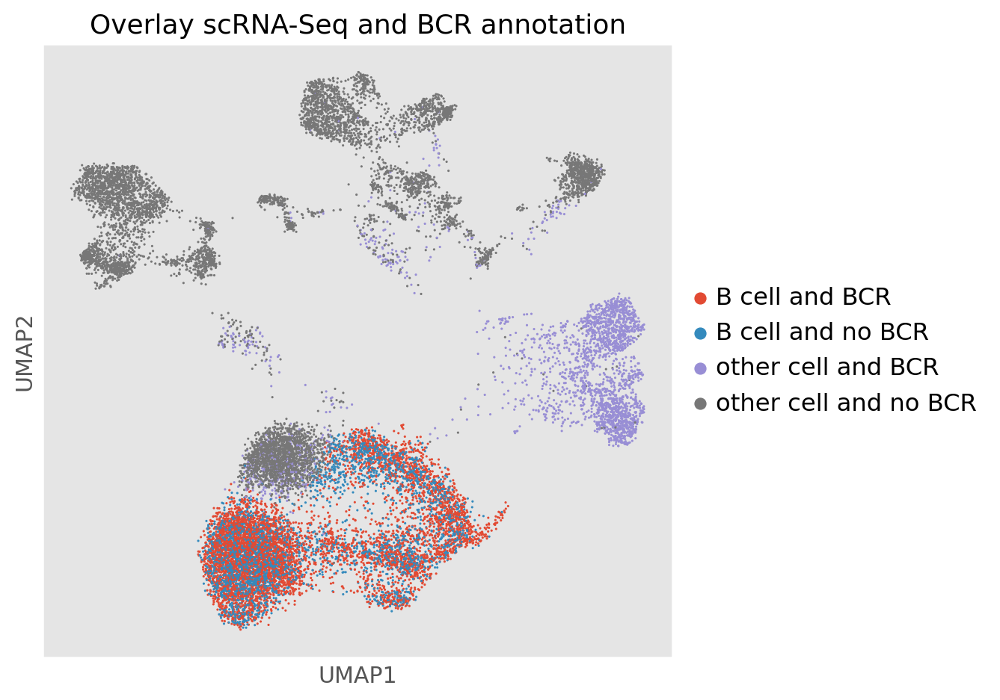

In [145]:
sc.pl.umap(gex_adata, color='b_cell_bcr', title='Overlay scRNA-Seq and BCR annotation')

In [146]:
gex_adata.obs['b_cell_bcr'].value_counts().sort_index()

B cell and BCR           5908
B cell and no BCR        2948
other cell and BCR       2646
other cell and no BCR    7435
Name: b_cell_bcr, dtype: int64

Text(0, 0.5, '')

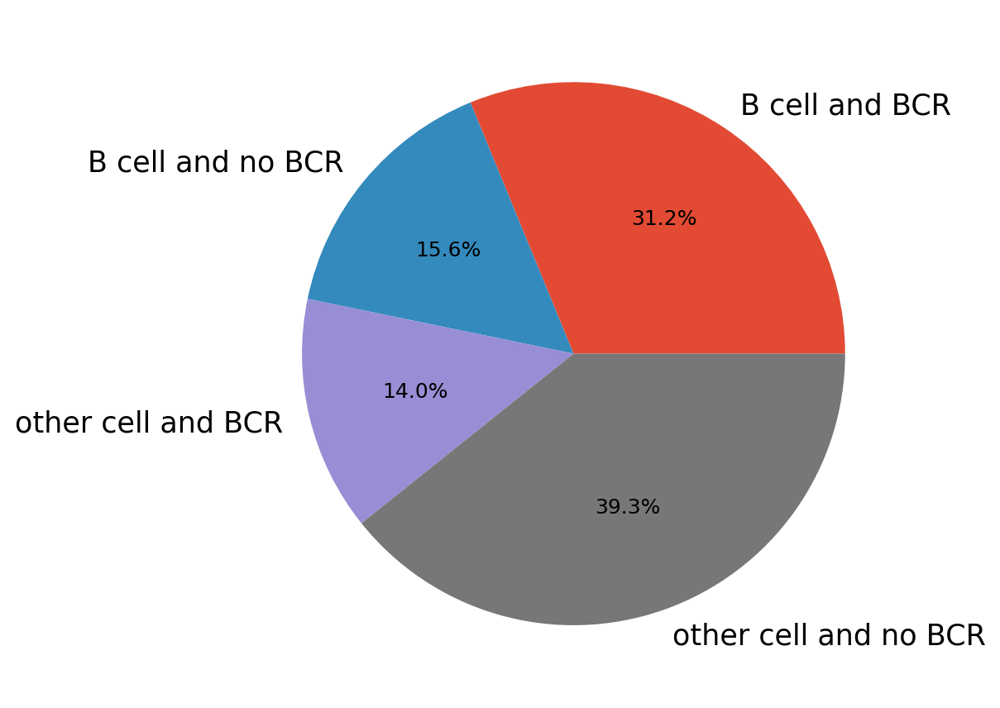

In [147]:
ax = gex_adata.obs['b_cell_bcr'].value_counts().sort_index().plot(kind='pie', autopct='%1.1f%%')
ax.set_ylabel('')

## 2. group abundance

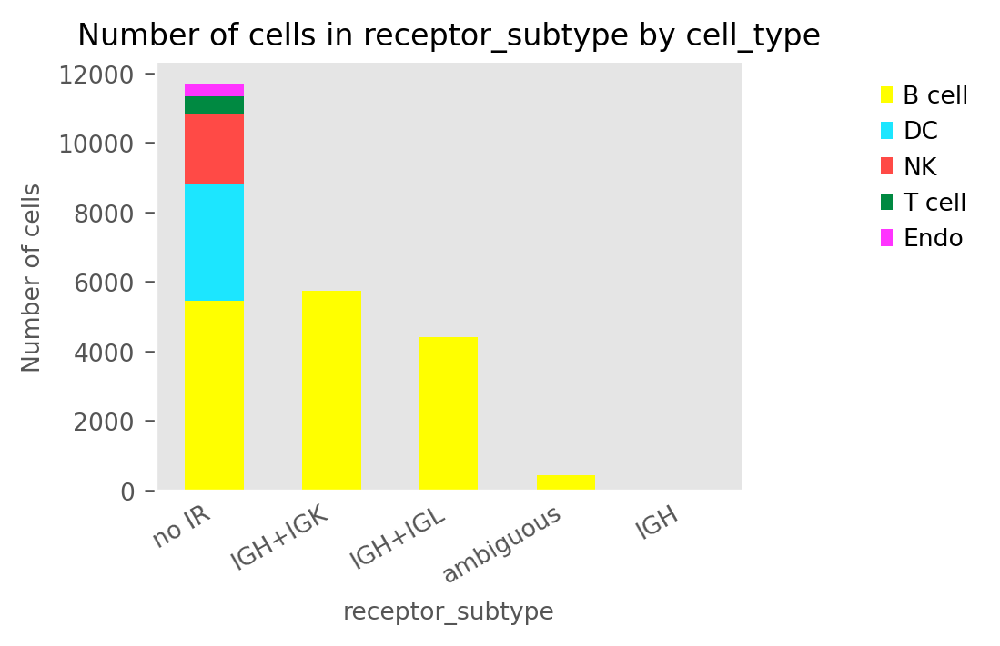

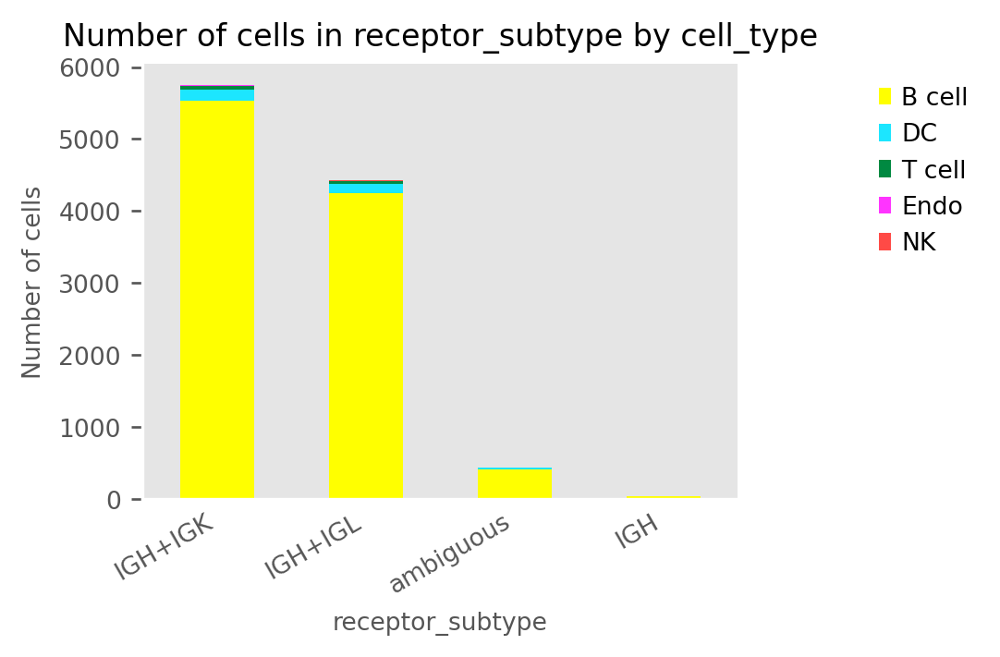

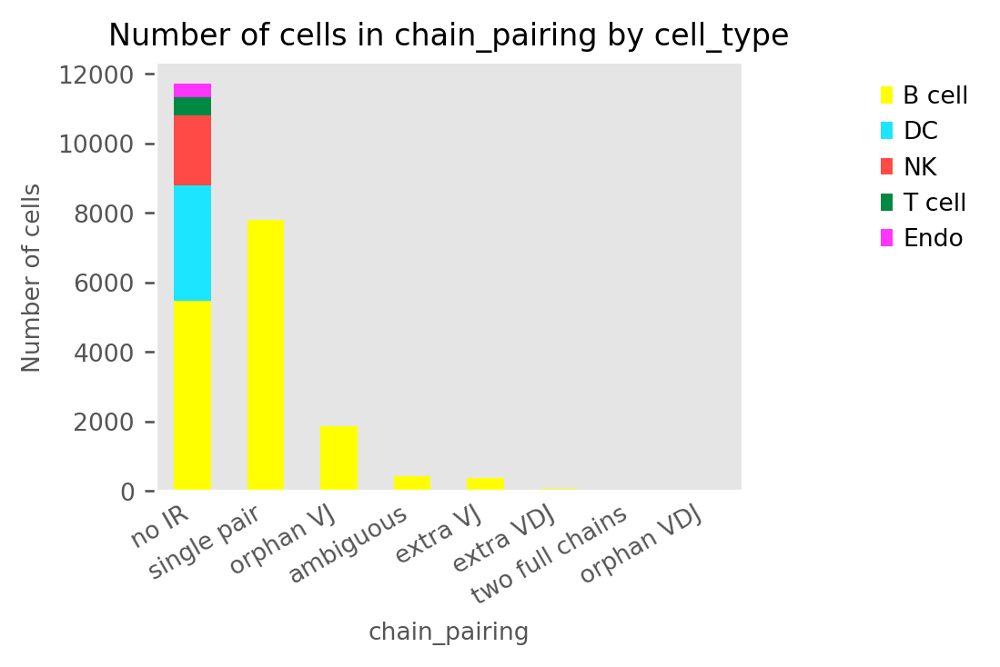

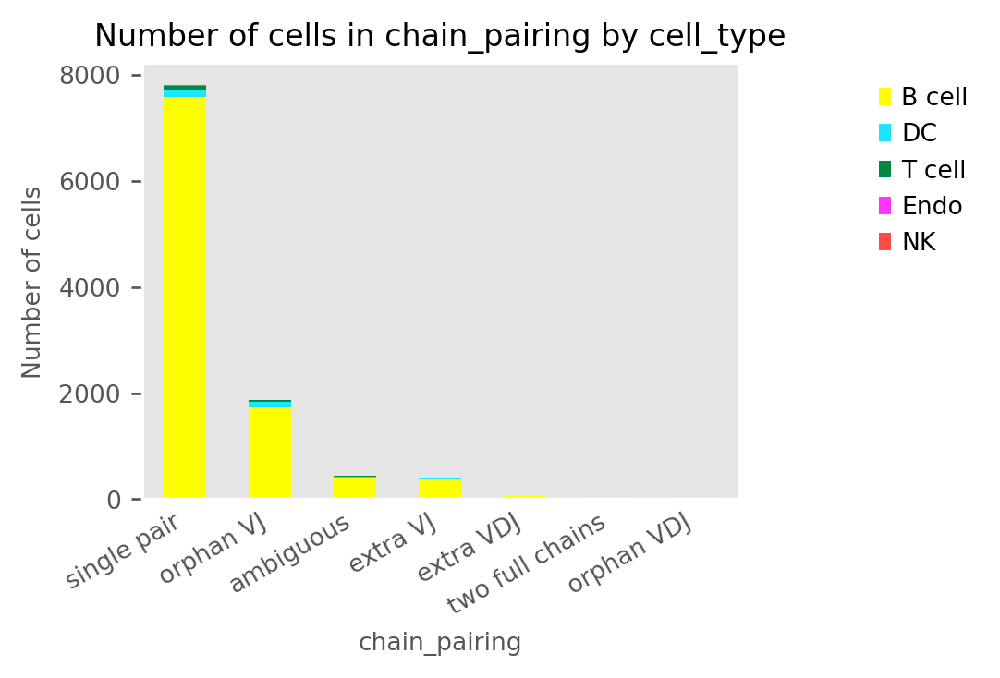

In [351]:
ax = ir.pl.group_abundance(gex_adata, groupby="receptor_subtype", target_col="cell_type")
ax = ir.pl.group_abundance(bcr_adata, groupby="receptor_subtype", target_col="cell_type")
ax = ir.pl.group_abundance(gex_adata, groupby="chain_pairing", target_col="cell_type")
ax = ir.pl.group_abundance(bcr_adata, groupby="chain_pairing", target_col="cell_type")

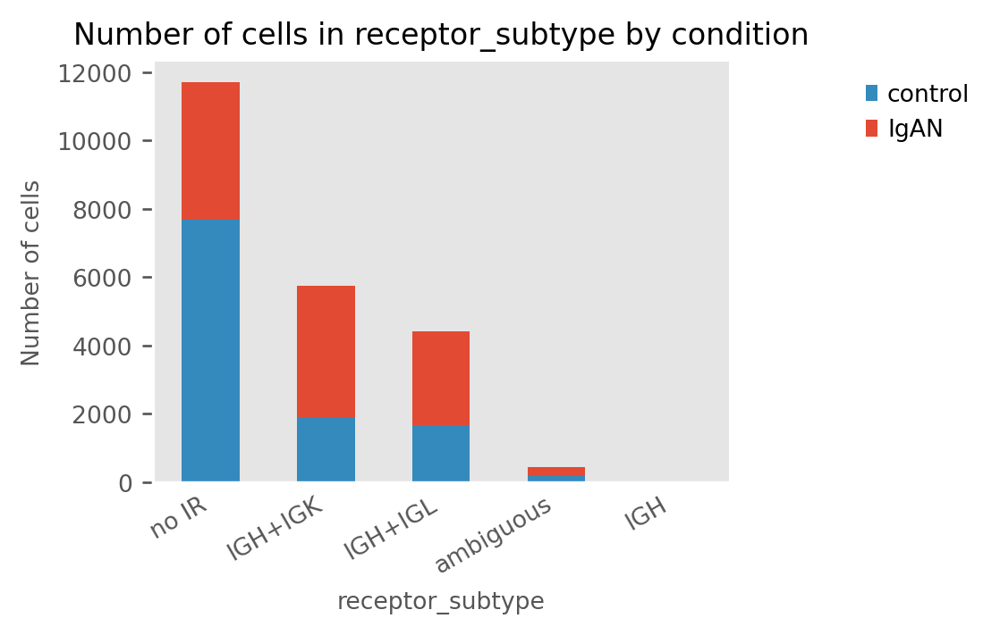

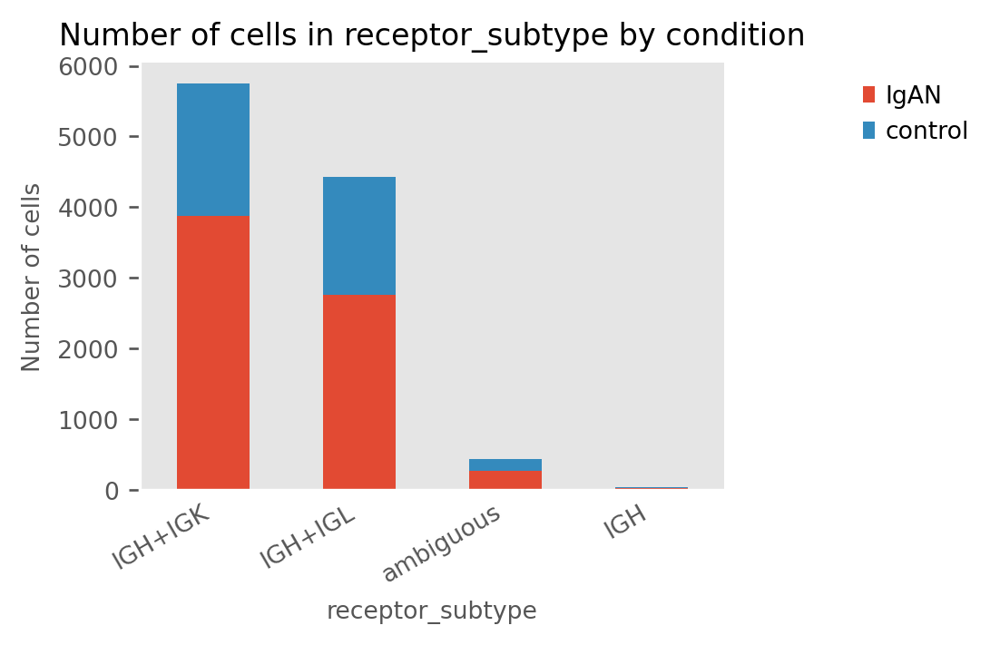

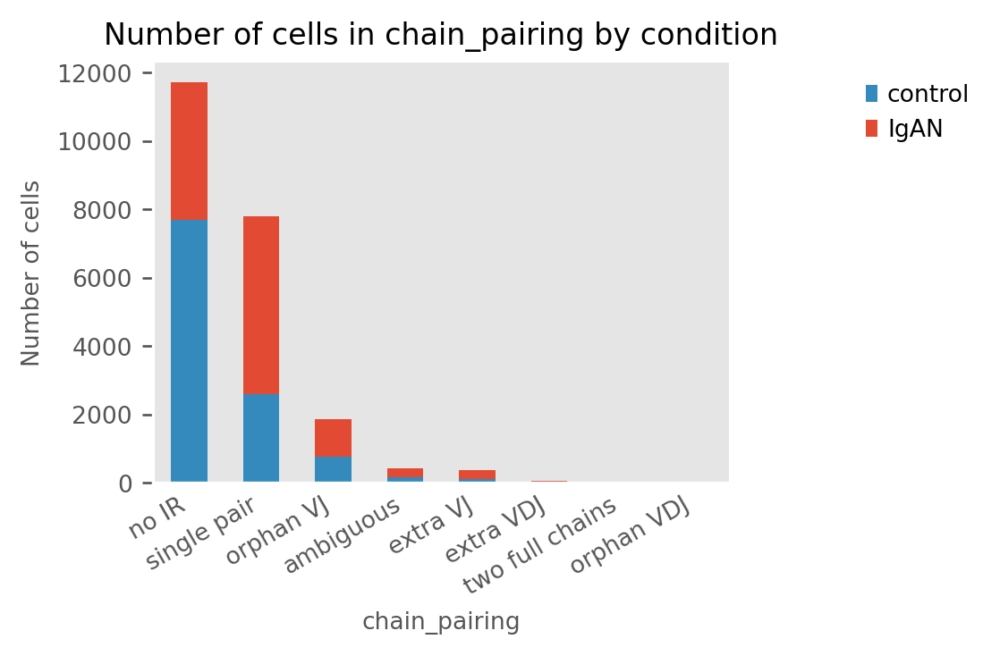

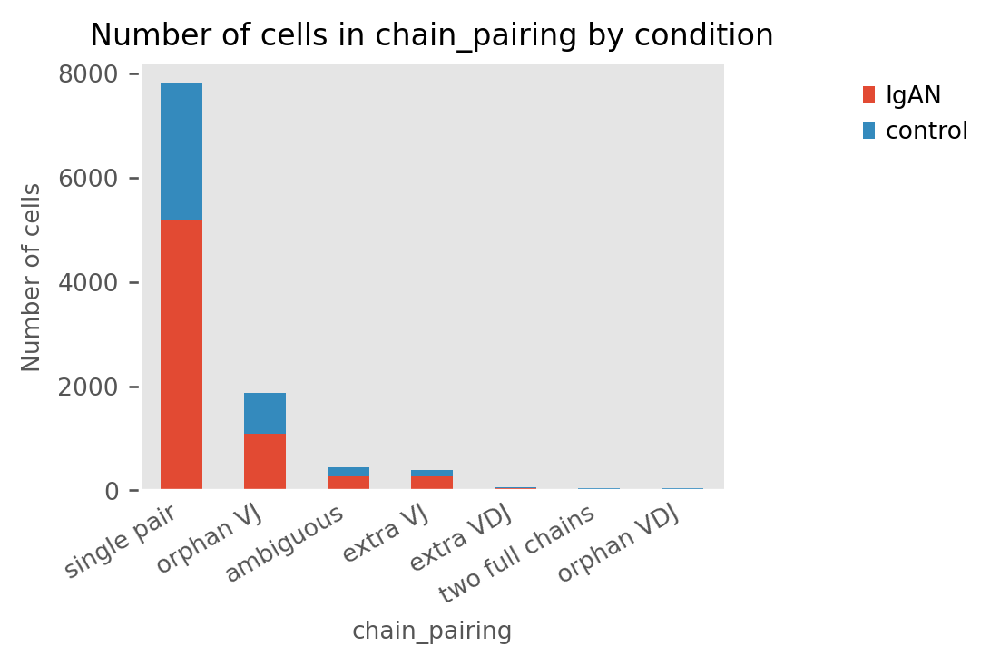

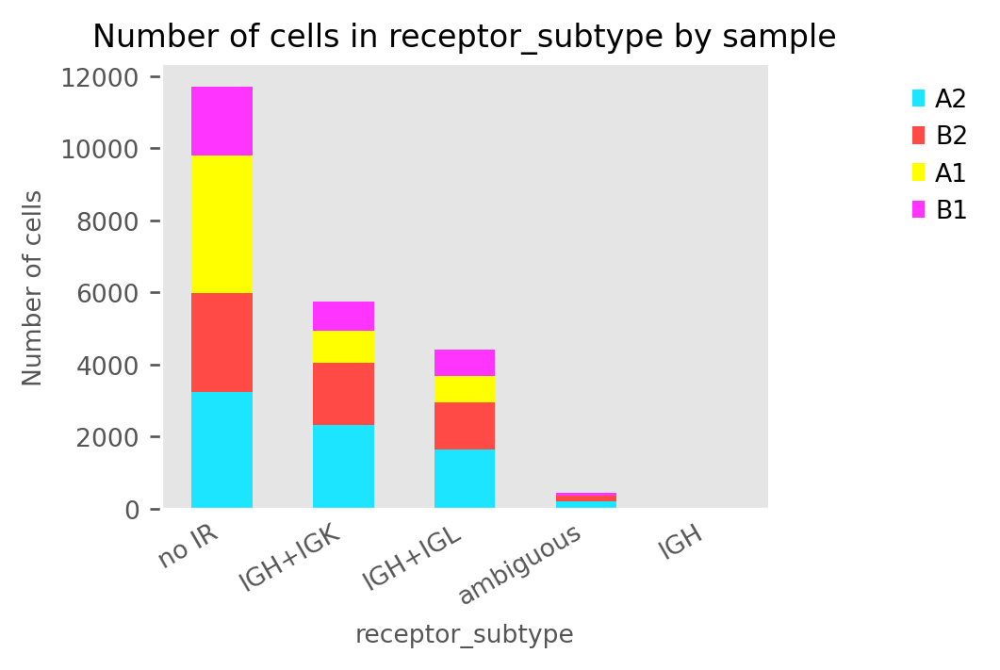

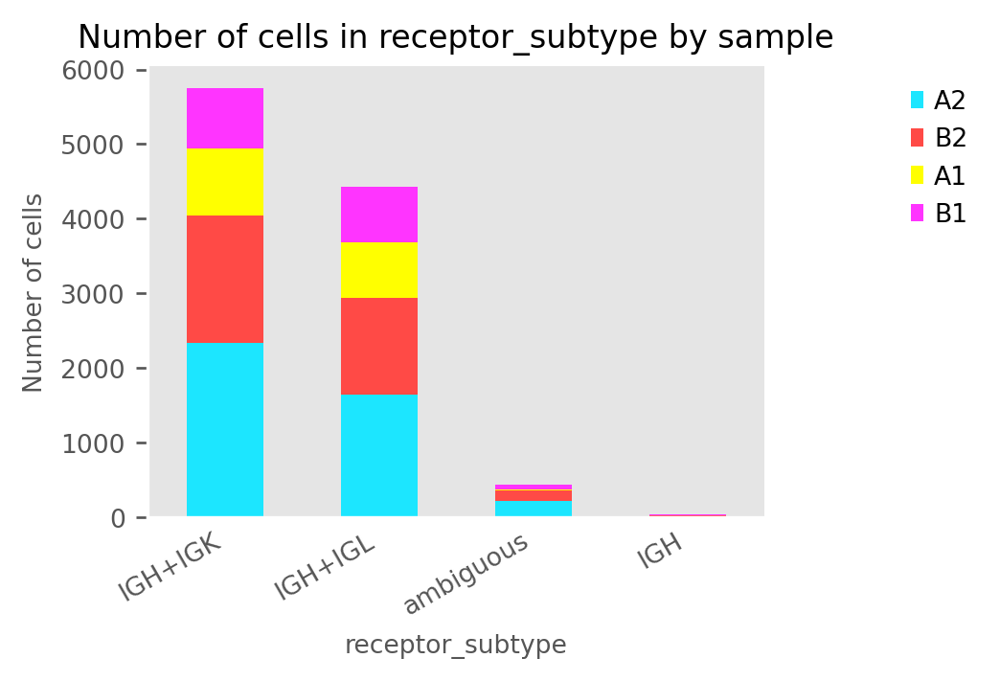

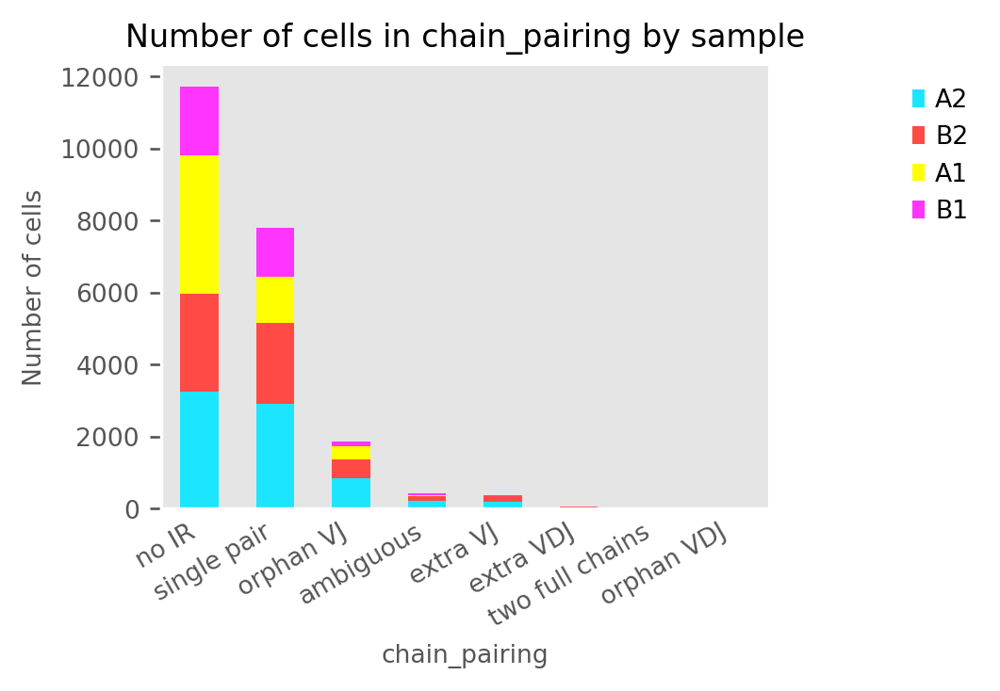

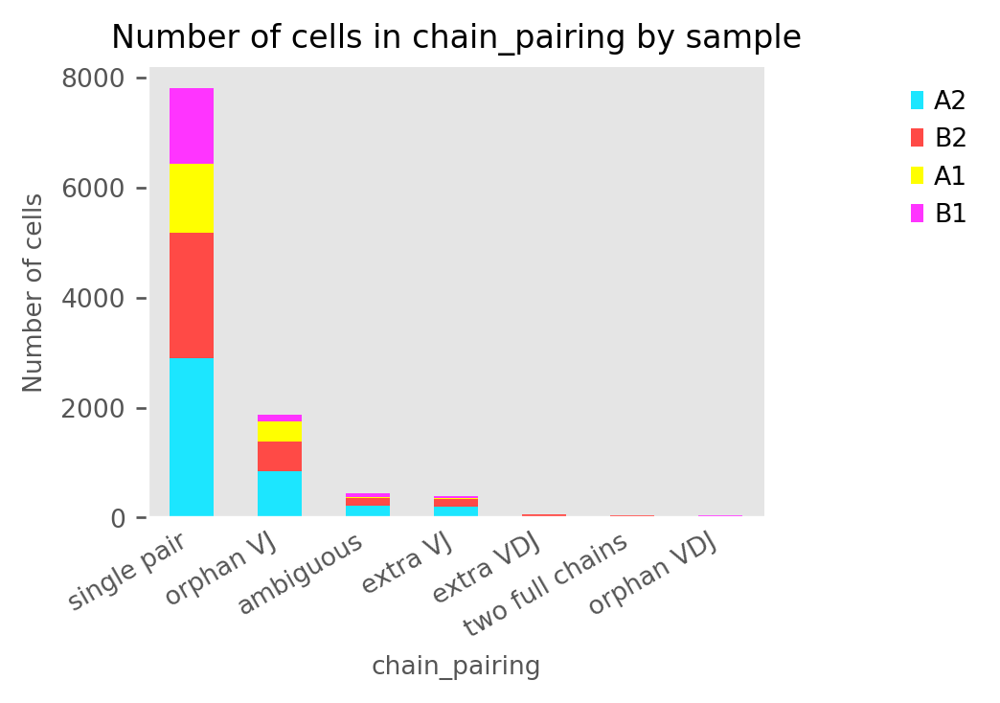

In [353]:
ax = ir.pl.group_abundance(gex_adata, groupby="receptor_subtype", target_col="condition")
ax = ir.pl.group_abundance(bcr_adata, groupby="receptor_subtype", target_col="condition")
ax = ir.pl.group_abundance(gex_adata, groupby="chain_pairing", target_col="condition")
ax = ir.pl.group_abundance(bcr_adata, groupby="chain_pairing", target_col="condition")

ax = ir.pl.group_abundance(gex_adata, groupby="receptor_subtype", target_col="sample")
ax = ir.pl.group_abundance(bcr_adata, groupby="receptor_subtype", target_col="sample")
ax = ir.pl.group_abundance(gex_adata, groupby="chain_pairing", target_col="sample")
ax = ir.pl.group_abundance(bcr_adata, groupby="chain_pairing", target_col="sample")

In [354]:
print("Fraction of cells with more than one pair of BCRs: {:.2f}".format(
        np.sum(bcr_adata.obs["chain_pairing"].isin(
                ["extra VJ", "extra VDJ", "two full chains"]
            )
        )
        / bcr_adata.n_obs
    )
)

Fraction of cells with more than one pair of BCRs: 0.05


In [439]:
bcr_adata = bcr_adata[bcr_adata.obs["chain_pairing"] != "multichain", :].copy()
bcr_adata = bcr_adata[~bcr_adata.obs["chain_pairing"].isin(["orphan VDJ", "orphan VJ"]), :].copy()

### 3.1 DE analysis using wilcoxon test - Delete

In [ ]:
key = "IgAN_vs_Ctrl_wilcoxon"
sc.tl.rank_genes_groups(ab_adata, 'condition', reference='control', method='wilcoxon', pts=True, key_added = key)

ranking genes
    finished: added to `.uns['IgAN_vs_Ctrl_wilcoxon']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:00)


In [ ]:
result = ab_adata.uns[key]
groups = result['names'].dtype.names
de_df = pd.DataFrame({group + '_' + key: result[key][group] for group in groups for key in ['names', 'logfoldchanges','scores','pvals','pvals_adj']})
pts_df = result['pts']
pts_df.columns = ['pts_' + c for c in pts_df.columns]

In [ ]:
de_path = f'{work_dir}/DE'
os.makedirs(de_path, exist_ok=True)
de_fn = f'{de_path}/IgA+_B_cell_IgAN_vs_ctrl_prot_wilcoxon.tsv'
de_df.to_csv(de_fn,sep='\t', index=False)

In [161]:
# stats
up_sig_df = de_df.query('IgAN_logfoldchanges > 0.58 and IgAN_pvals_adj < 0.05')
dn_sig_df = de_df.query('IgAN_logfoldchanges < -0.58 and IgAN_pvals_adj < 0.05')
print('up genes',up_sig_df.shape[0])
print('dn genes',dn_sig_df.shape[0])

up genes 3
dn genes 14


In [162]:
plot_genes = ['CD62L','CD36-1','IgD','CD41']

[<Axes: title={'center': 'IgAN vs. control'}, xlabel='genes', ylabel='expression'>]

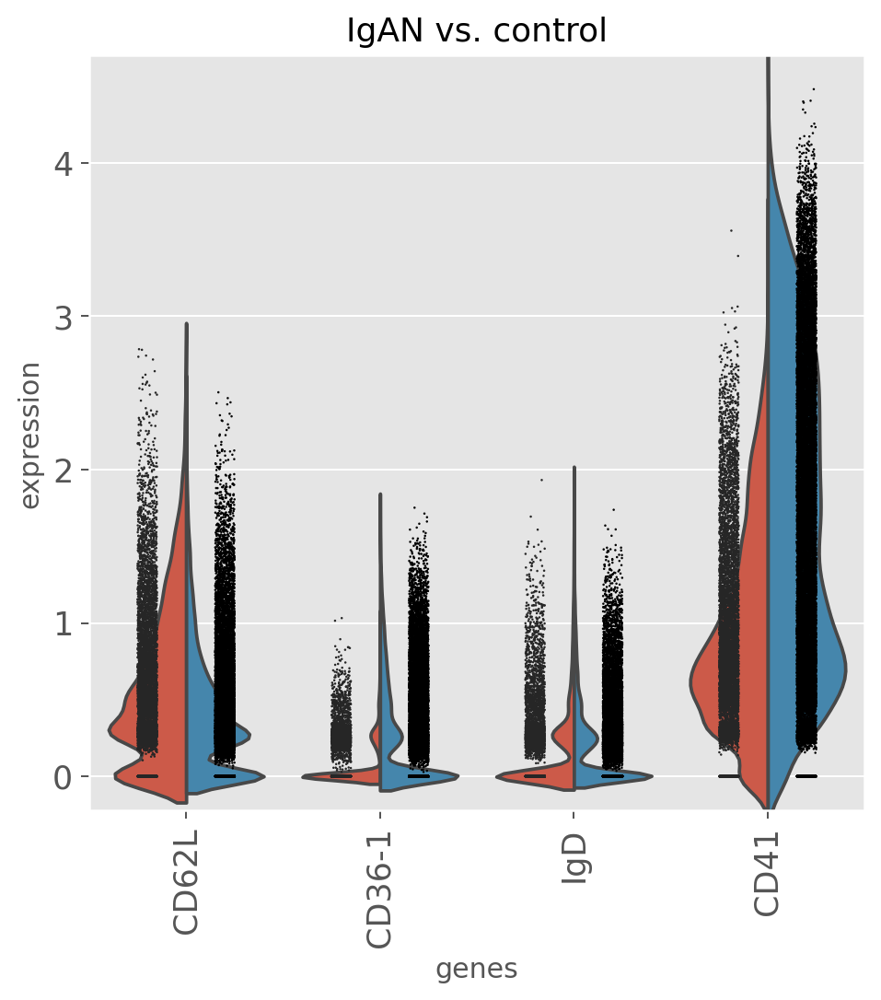

In [163]:
sc.pl.rank_genes_groups_violin(ab_adata, groups='IgAN', gene_names=plot_genes, key=key, show=False)

# Analyze B cell separately
## 1. Normalize and batch correction

In [360]:
b_adata = gex_adata[gex_adata.obs.query('cell_type == "B cell"').index,:].copy()
b_adata.X = b_adata.raw.X.copy()

In [361]:
# get IG variable gene names
rm_genes = [g for g in b_adata.var.index if g[:4] in ['IGLV','IGLJ']] +  \
           [g for g in b_adata.var.index if g[:4] in ['IGKV','IGKJ']] + \
           [g for g in b_adata.var.index if g[:4] in ['IGHV','IGHJ','IGHD']]
rm_genes.remove('IGHD') # IGHD is the constant reion, so don't remove this gene
sub_genes =[g for g in b_adata.var.index if g not in rm_genes]
b_adata = b_adata[:,sub_genes].copy()
b_adata.raw = b_adata
# # subset b_adata using genes expressed in at least 20 cells
sc.pp.filter_genes(b_adata, min_cells=20)

filtered out 6060 genes that are detected in less than 20 cells


<Axes: xlabel='sample'>

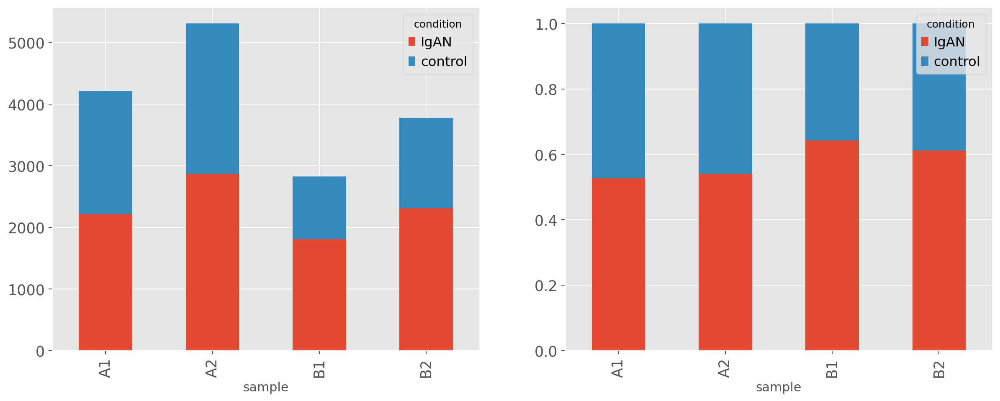

In [362]:
fig, axes = plt.subplots(1,2, figsize=(16,6))
b_adata.obs.groupby(['sample','condition']).size().unstack().plot(kind='bar',stacked=True, ax=axes[0])
b_adata.obs.groupby(['sample','condition']).size().unstack().apply(lambda x: x/sum(x), axis=1).plot(kind='bar',stacked=True, ax=axes[1])

In [363]:
# cell portion of each condition across each run
b_adata.obs.groupby(['sample','condition']).size().unstack().apply(lambda x: x/sum(x), axis=1).round(2)

condition,IgAN,control
sample,,
A1,0.53,0.47
A2,0.54,0.46
B1,0.64,0.36
B2,0.61,0.39


In [393]:
b_adata.obs.groupby(['sample','condition']).size().unstack()

condition,IgAN,control
sample,,
A1,2222,1989
A2,2867,2441
B1,1817,1007
B2,2313,1461


extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
computing PCA
    on highly variable genes
    with n_comps=20
    finished (0:00:02)


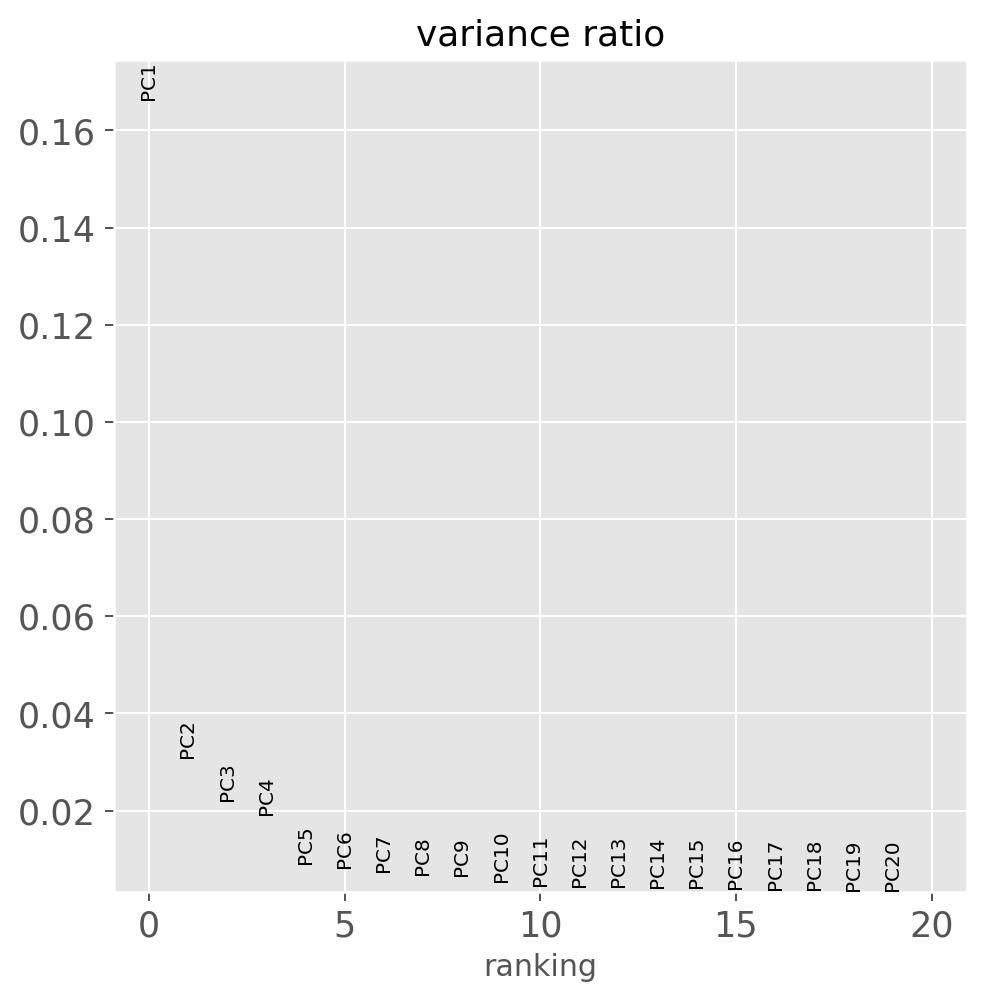

2023-06-29 11:13:11,571 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2023-06-29 11:13:29,434 - harmonypy - INFO - sklearn.KMeans initialization complete.
2023-06-29 11:13:29,533 - harmonypy - INFO - Iteration 1 of 15
2023-06-29 11:13:34,992 - harmonypy - INFO - Iteration 2 of 15
2023-06-29 11:13:41,479 - harmonypy - INFO - Converged after 2 iterations


In [364]:
# integrate samples 
sc.pp.highly_variable_genes(b_adata, flavor='seurat', n_bins=50)
# pca
n_pc=20
sc.tl.pca(b_adata, n_comps=n_pc, use_highly_variable=True, svd_solver='arpack')
sc.pl.pca_variance_ratio(b_adata, n_pcs=n_pc)
# batch correct
sce.pp.harmony_integrate(b_adata, 'sample', max_iter_harmony=15)

## 2. UMAP and clustering

computing neighbors
    finished: added to `.uns['hmny']`
    `.obsp['hmny_distances']`, distances for each pair of neighbors
    `.obsp['hmny_connectivities']`, weighted adjacency matrix (0:00:02)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:08)


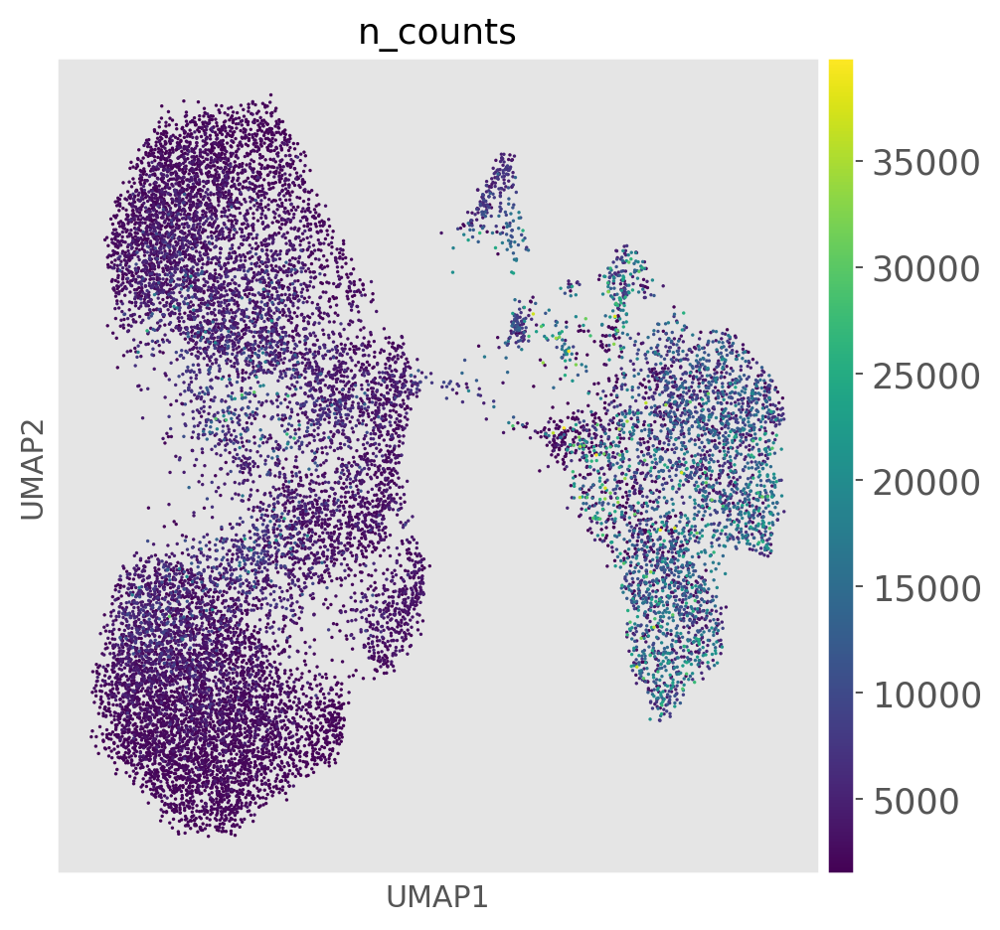

In [374]:
# Calculate the UMAP using harmany
sc.pp.neighbors(b_adata, use_rep = 'X_pca_harmony',key_added='hmny')
sc.tl.umap(b_adata, neighbors_key='hmny')
sc.pl.umap(b_adata, color='n_counts')

In [375]:
# recluster the cells
bcell_cluster_key = 'Bcell_leiden_r0.5'
sc.tl.leiden(b_adata, key_added=bcell_cluster_key, resolution=0.5, neighbors_key='hmny')

running Leiden clustering
    finished: found 9 clusters and added
    'Bcell_leiden_r0.5', the cluster labels (adata.obs, categorical) (0:00:01)


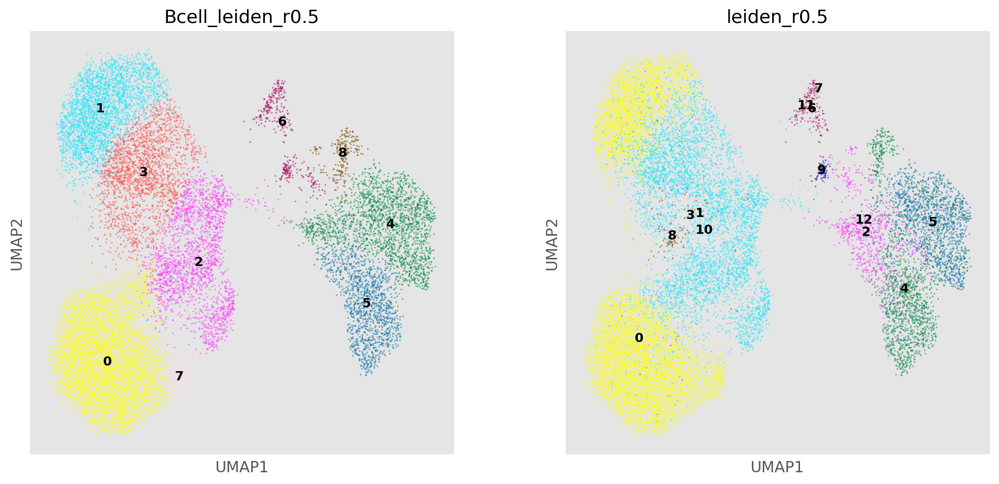

In [376]:
sc.pl.umap(b_adata, color=[bcell_cluster_key, 'leiden_r0.5'], palette=sc.pl.palettes.default_102, legend_loc='on data',alpha=0.5)

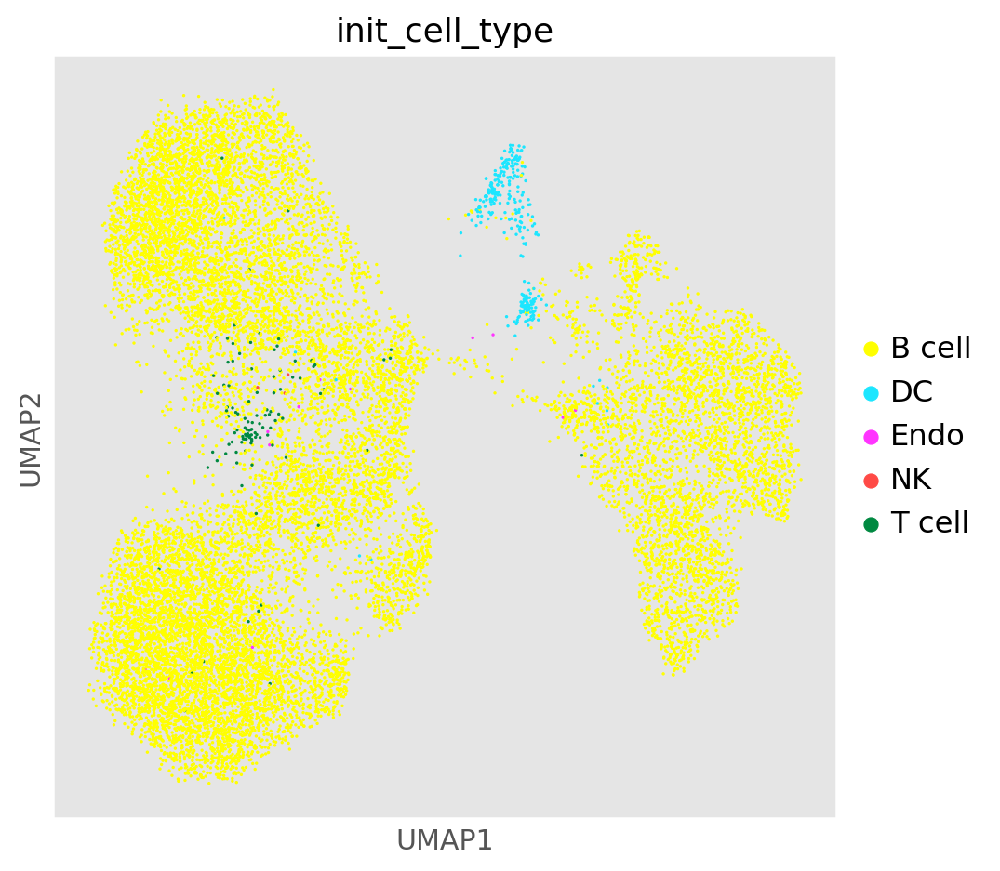

In [377]:
# overlay initial cell type annotation (before BCR correction) to the new B cell clusters
sc.pl.umap(b_adata, color=['init_cell_type'], palette=sc.pl.palettes.default_102)

In [378]:
bcell_rank_key = 'rank_genes_r0.5'
sc.tl.rank_genes_groups(b_adata, groupby=bcell_cluster_key, key_added=bcell_rank_key, method='wilcoxon')

ranking genes
    finished: added to `.uns['rank_genes_r0.5']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:48)


## 3. B cell annotation 
### 3.1 Annotation sing SCSA

In [379]:
b_init_cell_anno = sctool.scsa_cell_anno(b_adata, rank_key=bcell_rank_key, clust_col=bcell_cluster_key, species='Human',tissue='Blood', tmp_dir=work_dir)

PermissionError: [Errno 13] Permission denied: '/media/hpc/grid/wip_drm_targetsciences/projects/p062_MIGIS_IGAN/data_2nd_batch/rank_genes_r0.5.tsv'

In [ ]:
# extract marker gene
de_df = sctool.get_cluster_markers(b_adata, key='rank_genes_r0.5')
# output to file
marker_path = f'{work_dir}/cluster_marker'
os.makedirs(marker_path, exist_ok=True)
b_de_fn = f'{marker_path}/Bcell_cluster_markers_rm_Ig_vari.tsv'
de_df.to_csv(b_de_fn, sep='\t', index=False)

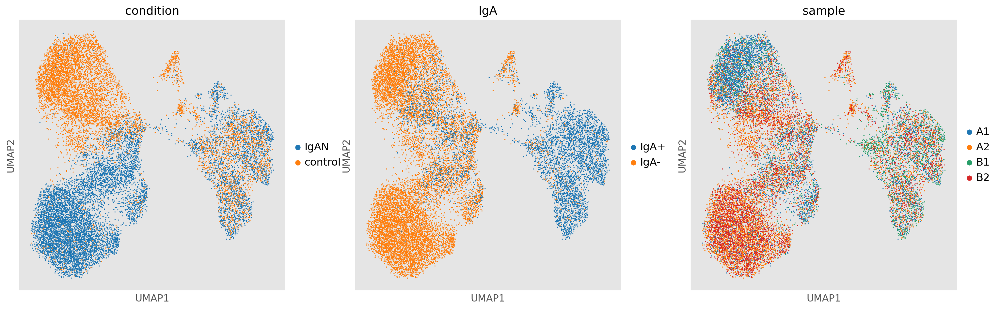

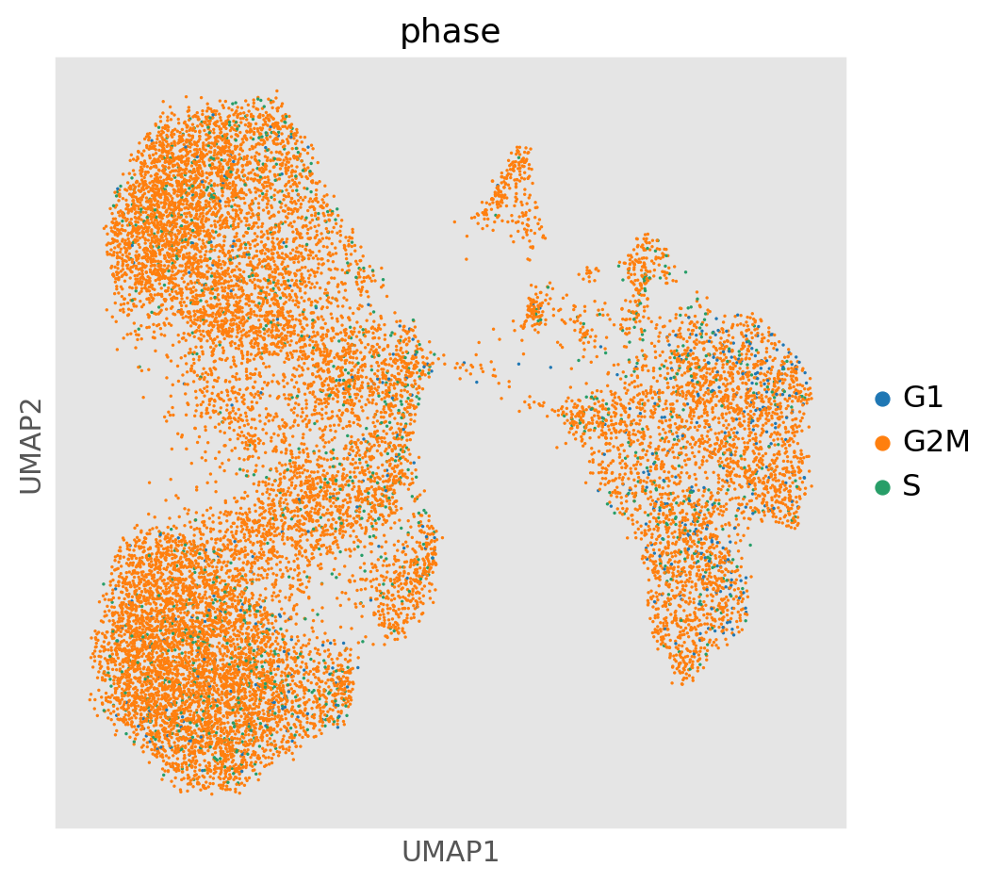

In [380]:
sc.pl.umap(b_adata, color=['condition','IgA','sample'], palette=sc.pl.palettes.default_20)
sc.pl.umap(b_adata, color=['phase'], palette=sc.pl.palettes.default_20)

In [480]:
# save b cell scanpy object to a file
os.makedirs(f'{work_dir}/inter_h5ad', exist_ok=True)
b_adata_rm_Ig_fn =f'{work_dir}/inter_h5ad/b_adata_rm_Ig_vari.h5ad' 
if not os.path.exists(b_adata_rm_Ig_fn):
    b_adata.write(b_adata_rm_Ig_fn)
else:
    b_adata = sc.read_h5ad(b_adata_rm_Ig_fn)  # use this command if you saved the data to h5ad file before
    b_adata.uns['log1p']["base"] = None

### 3.2 marker genes overlap analysis between clusters

In [381]:
# Top marker genes pathway enrichment analysis
subB_marker_df = sctool.get_cluster_markers(b_adata, bcell_rank_key)
nclusts = int(subB_marker_df.shape[1] / 5) # each cluster has 5 columns of results

In [382]:
# get top 100 marker genes
marker_genes = {}
for c in range(nclusts):
    genes = subB_marker_df.query(f'`{c}_logfoldchanges` > 0.58 and `{c}_pvals_adj` < 0.05 and `{c}_names` in @expr_10genes')[f'{c}_names'].tolist()[:100]
    marker_genes[str(c)] = genes
# get numbers
marker_n = {}
for k,v in marker_genes.items():
    marker_n[k] = len(v)

In [180]:
# bar plot to show the number of markers in each cluster
# ax = pd.DataFrame.from_dict(marker_n, orient='index').plot(kind='bar', legend=False, figsize=(8,6))
# ax.set_title('Number of top marker genes')
# ax.set_xlabel('cluster')
# ax.set_ylabel('gene number')
# ax.set_ylim(0,100)

In [383]:
rows = [f'{c}' for c in marker_genes.keys()]
cols = [f'{c}' for c in marker_genes.keys()]
clusts_genes_df = pd.DataFrame(index=rows, columns=cols)

The following code is to plot the overlap of markers between different clusters

In [384]:
dtype = 'raw'
for i in range(len(rows)):
    row_genes = marker_genes[rows[i]]
    for j in range(len(cols)):
        col_genes = marker_genes[cols[j]]
        inter = len(set(row_genes).intersection(col_genes))
        
        if i != j:
            val = round(inter / len(row_genes), 2)
        # elif i < j:
        #     val = round(inter / len(col_genes), 2)
        #     print(val, inter, len(row_genes))
        elif i == j:
            val = 1
        if dtype == 'percent':
            clusts_genes_df.loc[rows[i],cols[j]] = val
        elif dtype == 'raw':
            clusts_genes_df.loc[rows[i],cols[j]] = inter
clusts_genes_df = clusts_genes_df.astype(float)

<Axes: >

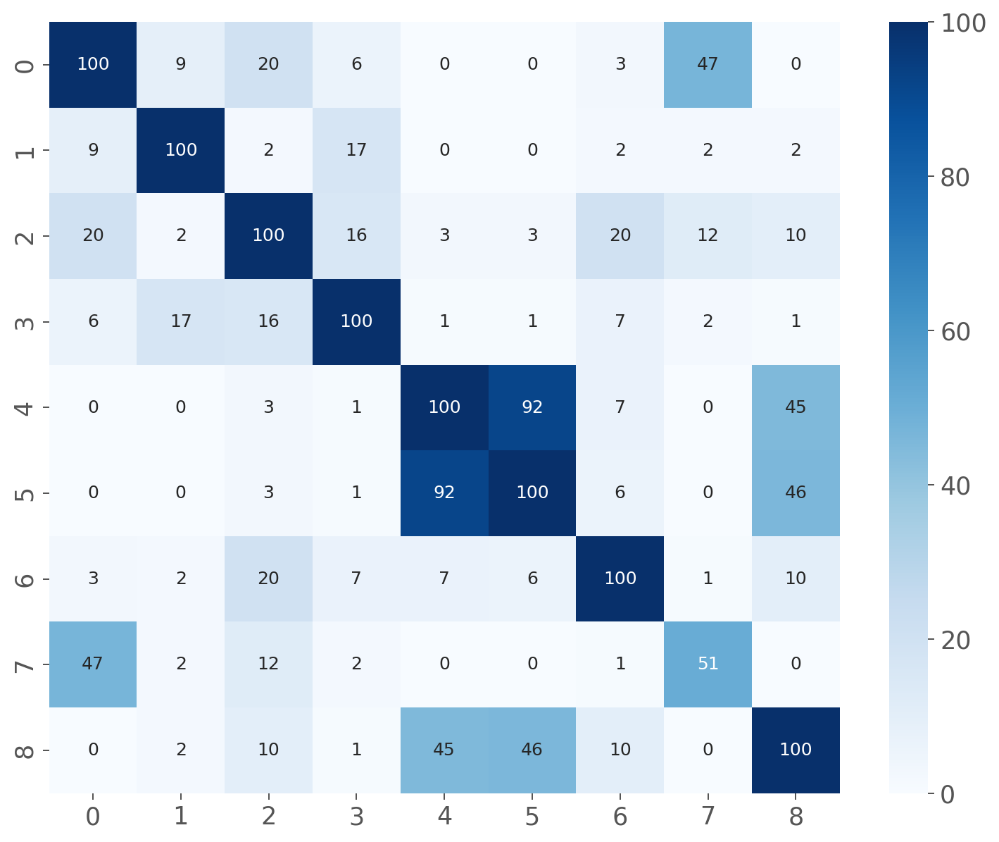

In [385]:
# number of marker genes overlapped between each pair of clusters
fig, ax = plt.subplots(figsize=(10,8))
sb.heatmap(clusts_genes_df,annot=True,cmap='Blues',fmt='g')

## 3. Analyze IgA+ B cells
1. extract IgA+ B cells

In [386]:
b_adata = sc.read_h5ad(f'{work_dir}/inter_h5ad/b_adata_rm_Ig_vari.h5ad')
b_adata.uns['log1p']["base"] = None
b_adata.obs['cond_sp'] = b_adata.obs.apply(lambda x: x['condition'] + '_' + x['sample'].split('_')[0] ,axis=1)
b_iga_adata = b_adata[b_adata.obs.query('IgA == "IgA+"').index,:].copy()

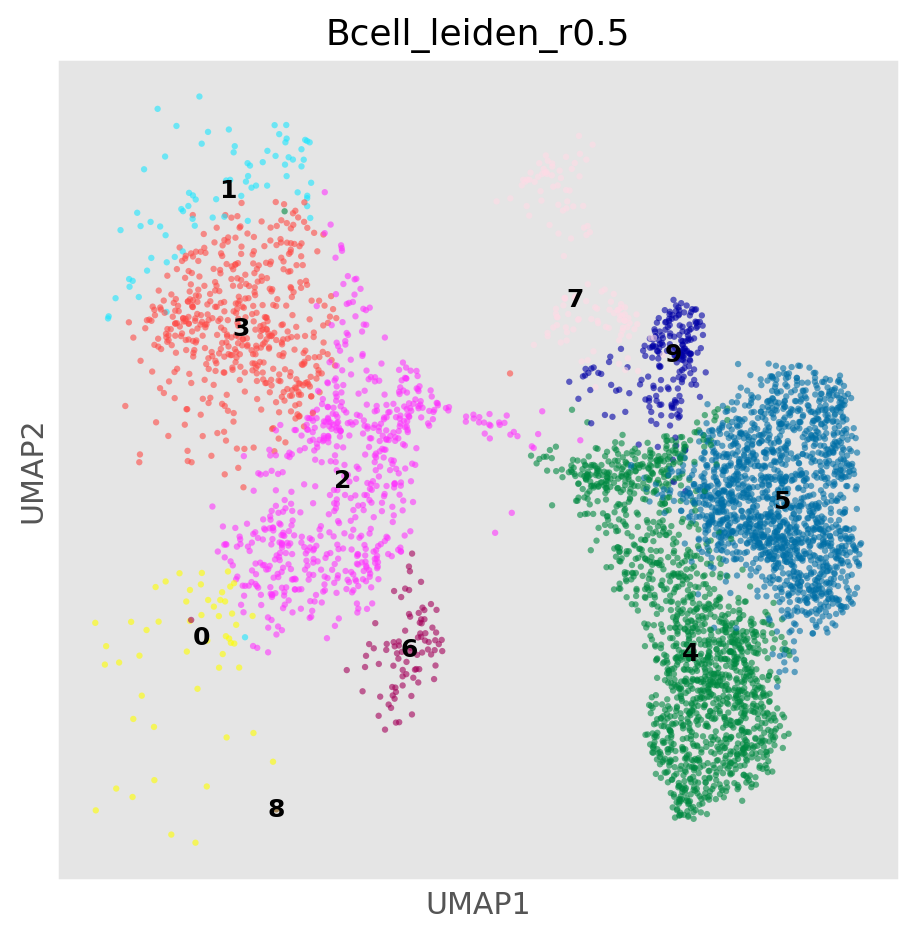

In [387]:
bcell_cluster_key = 'Bcell_leiden_r0.5'
sc.pl.umap(b_iga_adata, color=bcell_cluster_key, palette=sc.pl.palettes.default_102, legend_loc='on data',alpha=0.6)

In [388]:
# cell portion of each condition in each run
b_iga_adata.obs.groupby(['sample','condition']).size().unstack().apply(lambda x: x/sum(x), axis=1).round(2)

condition,IgAN,control
sample,,
A1,0.95,0.05
A2,0.18,0.82
B1,0.90,0.10
B2,0.22,0.78


<Axes: xlabel='sample'>

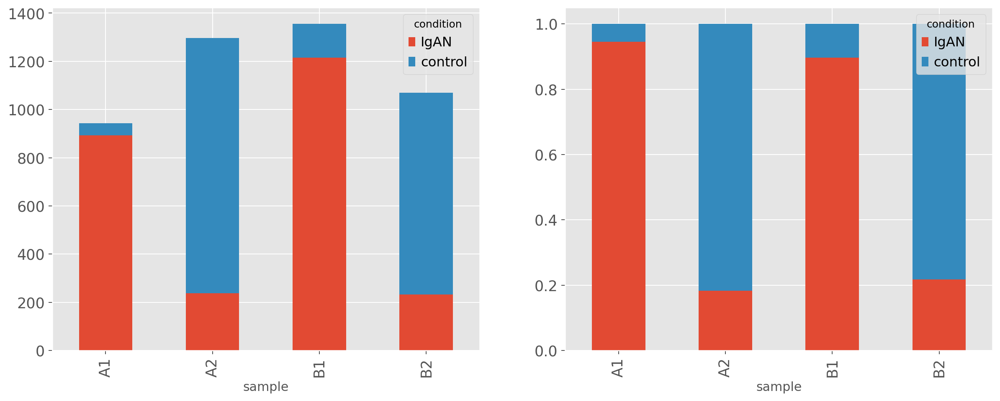

In [490]:
fig, axes = plt.subplots(1,2, figsize=(16,6))
b_iga_adata.obs.groupby(['sample','condition']).size().unstack().plot(kind='bar',stacked=True, ax=axes[0])
b_iga_adata.obs.groupby(['sample','condition']).size().unstack().apply(lambda x: x/sum(x), axis=1).plot(kind='bar',stacked=True, ax=axes[1])

In [394]:
b_iga_adata.obs.groupby(['sample','condition']).size().unstack()

condition,IgAN,control
sample,,
A1,893,51
A2,237,1059
B1,1216,139
B2,233,836


The above figure shows that most IgAN cells are from A1 IgAN patients, and most control cells are from A2 control samples. This unbalance will need to be solved in the experimental stage in the future.

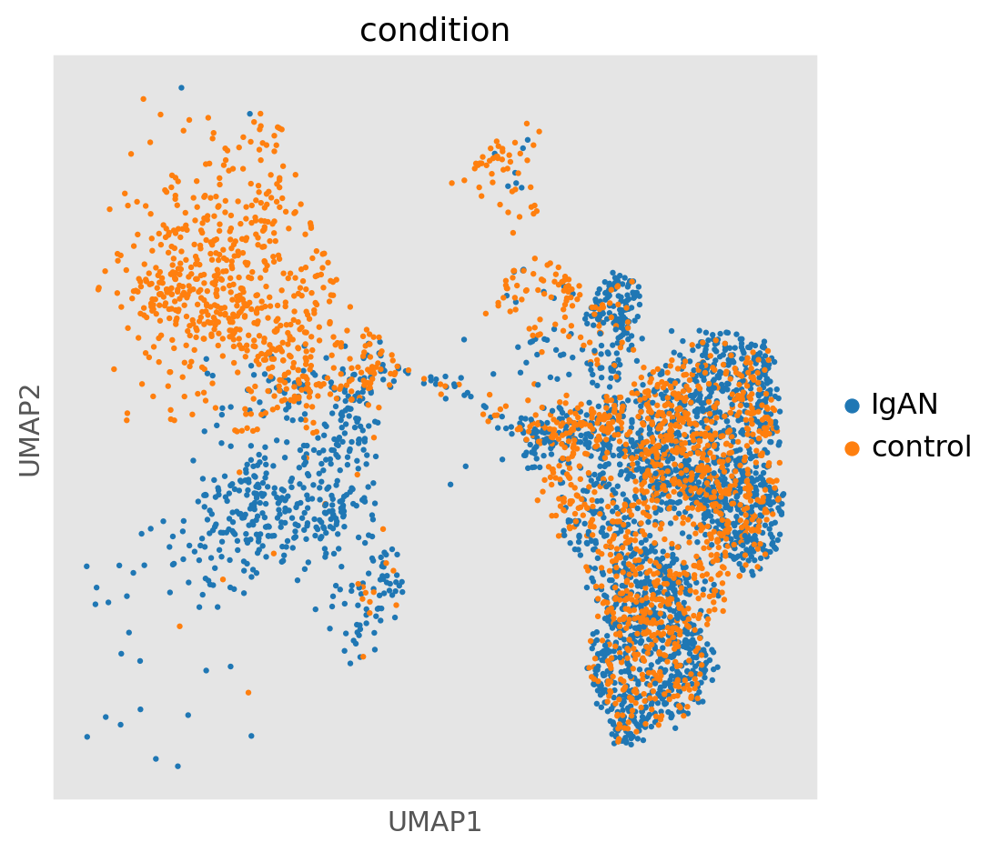

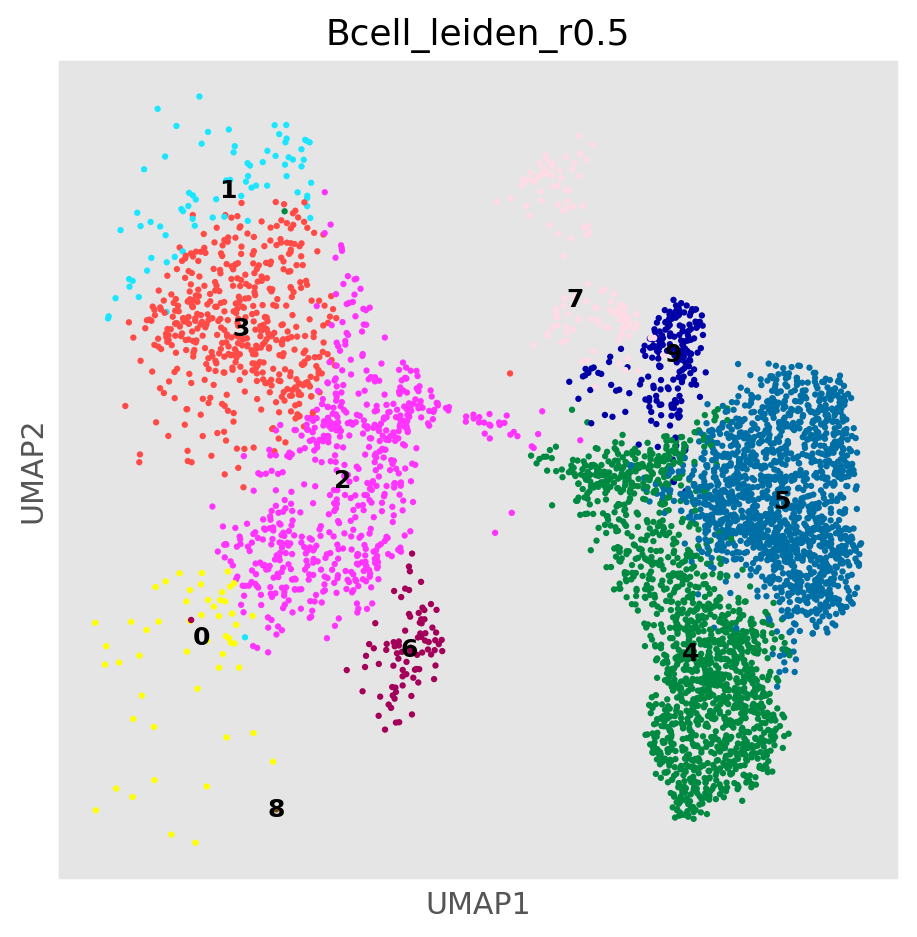

In [491]:
sc.pl.umap(b_iga_adata, color=['condition'], palette=sc.pl.palettes.default_20)
sc.pl.umap(b_iga_adata, color=[bcell_cluster_key], palette=sc.pl.palettes.default_102, legend_loc='on data')

Text(0.5, 1.0, 'cell distribution across cluster & condition')

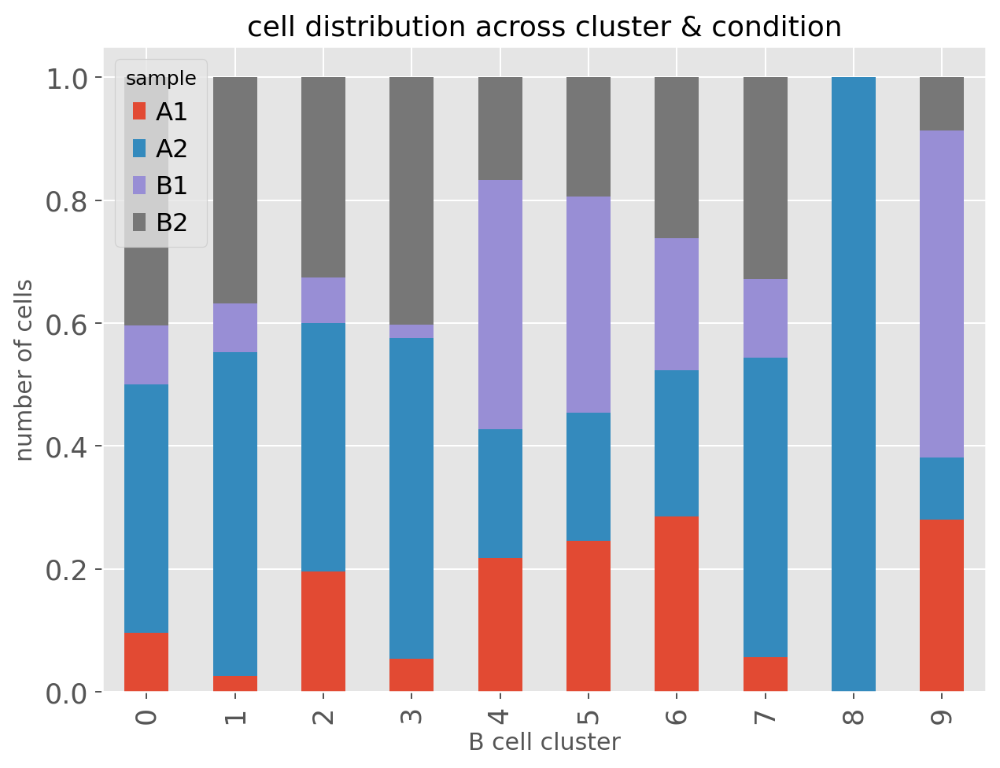

In [492]:
# ax = b_iga_adata.obs.groupby(['Bcell_leiden_r0.5','condition']).size().unstack().plot(kind='bar',stacked=True, figsize=(8,6))
ax = b_iga_adata.obs.groupby([bcell_cluster_key,'sample']).size().unstack().apply(lambda x: x/sum(x),axis=1).plot(kind='bar',stacked=True, figsize=(8,6))
ax.set_xlabel('B cell cluster')
ax.set_ylabel('number of cells')
ax.set_title('cell distribution across cluster & condition')

<Axes: xlabel='Bcell_leiden_r0.5'>

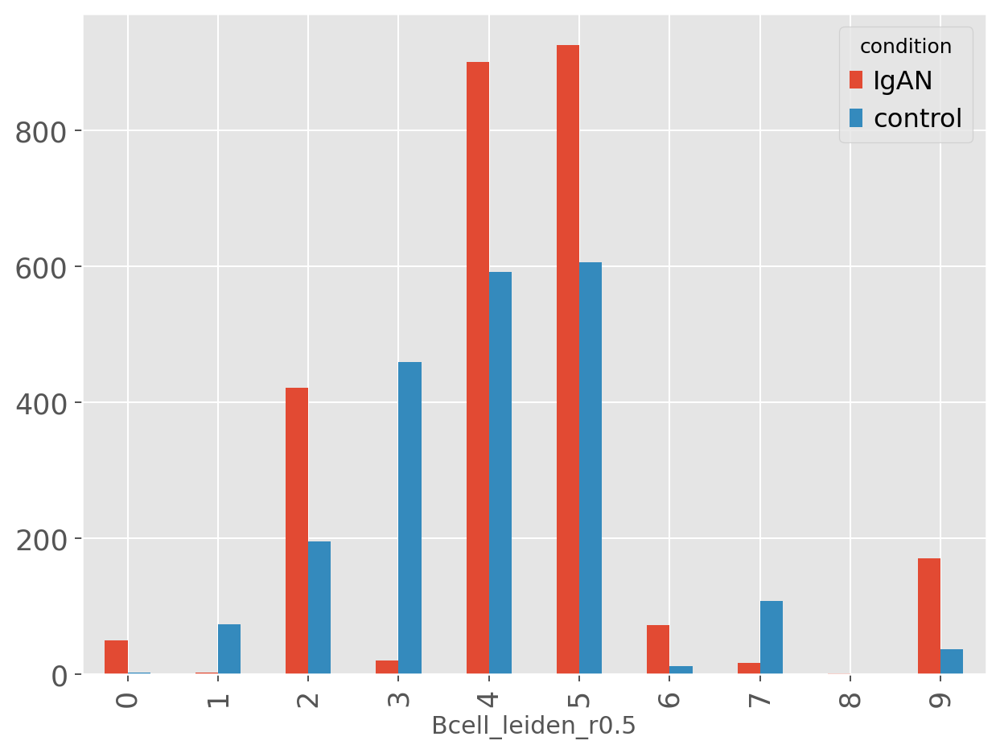

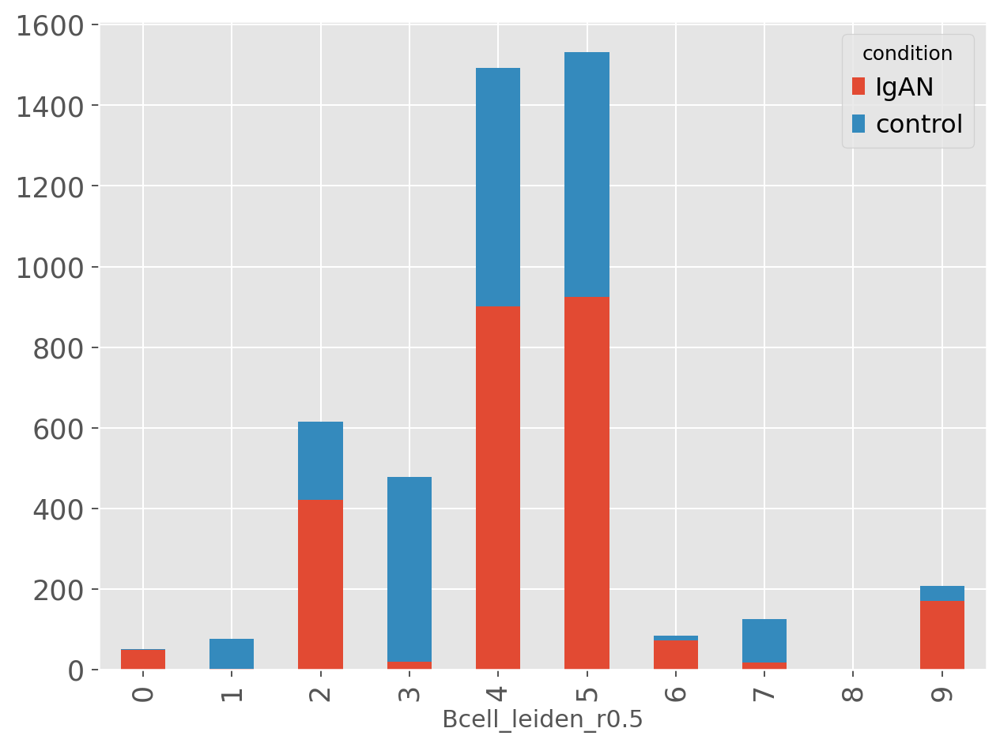

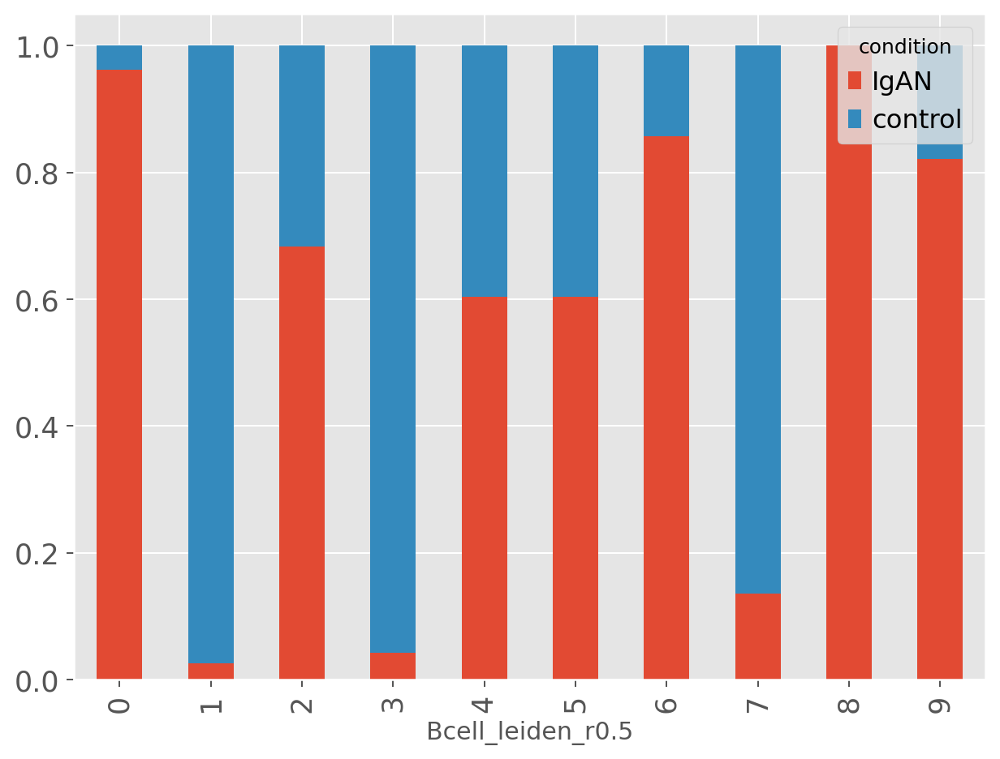

In [493]:
b_iga_adata.obs.groupby(['Bcell_leiden_r0.5','condition']).size().unstack().plot(kind='bar',figsize=(8,6))
b_iga_adata.obs.groupby(['Bcell_leiden_r0.5','condition']).size().unstack().plot(kind='bar',stacked=True, figsize=(8,6))
b_iga_adata.obs.groupby(['Bcell_leiden_r0.5','condition']).size().unstack().apply(lambda x: x/sum(x) , axis=1).plot(kind='bar', stacked=True, figsize=(8,6))

The above figure shows that each cluster has similar portion of cells from each run.

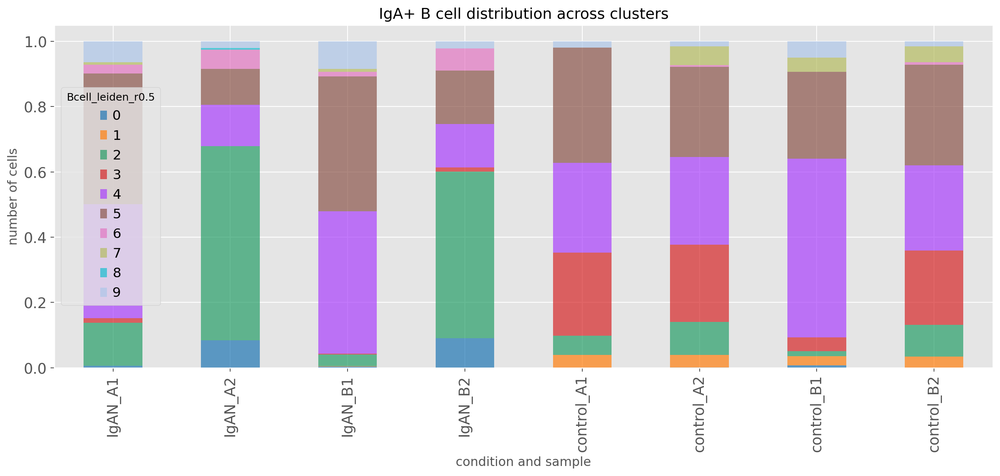

In [494]:
portion_df = b_iga_adata.obs.groupby(['cond_sp', 'Bcell_leiden_r0.5']).size().unstack().apply(lambda x: x/sum(x),axis=1)
color = color = sc.pl.palettes.default_20[:10] # sb.color_palette("tab20")  
ax = portion_df.plot(kind='bar',stacked=True, figsize=(16,6), color=color, alpha=0.7)
ax.set_xlabel('condition and sample')
ax.set_ylabel('number of cells')
ax.set_title('IgA+ B cell distribution across clusters')
portion_df = portion_df.T

The above figure shows the ditribution of cluster cell numbers in each sample. It shows that cluster 12 is mainly enriched in IgAN patient sample in A2. We run t-test on the cell portions between IgAN and control. The sample number is small, so no significant difference were found in any cluster.

In [495]:
def ig_type(row):
    '''
    this function tries to identify which Ig each cell express
    '''
    call1 = row['IR_VDJ_1_c_call']
    call2 = row['IR_VDJ_2_c_call']
    if isinstance(call1, str) and isinstance(call2, str) and (call1[:4] != call2[:4]):
        return 'ambiguous'
    call1 = str(call1)
    call2 = str(call2)
    if 'IGHA' in call1 or 'IGHA' in call2:
        return 'IgA'
    if 'IGHD' in call1 or 'IGHD' in call2:
        return 'IgD'
    if 'IGHG' in call1 or 'IGHG' in call2:
        return 'IgG'
    if 'IGHM' in call1 or 'IGHM' in call2:
        return 'IgM'
    
b_adata.obs['Ig_type'] = b_adata.obs.apply(lambda row: ig_type(row), axis=1)

Text(0, 0.5, 'cell portion')

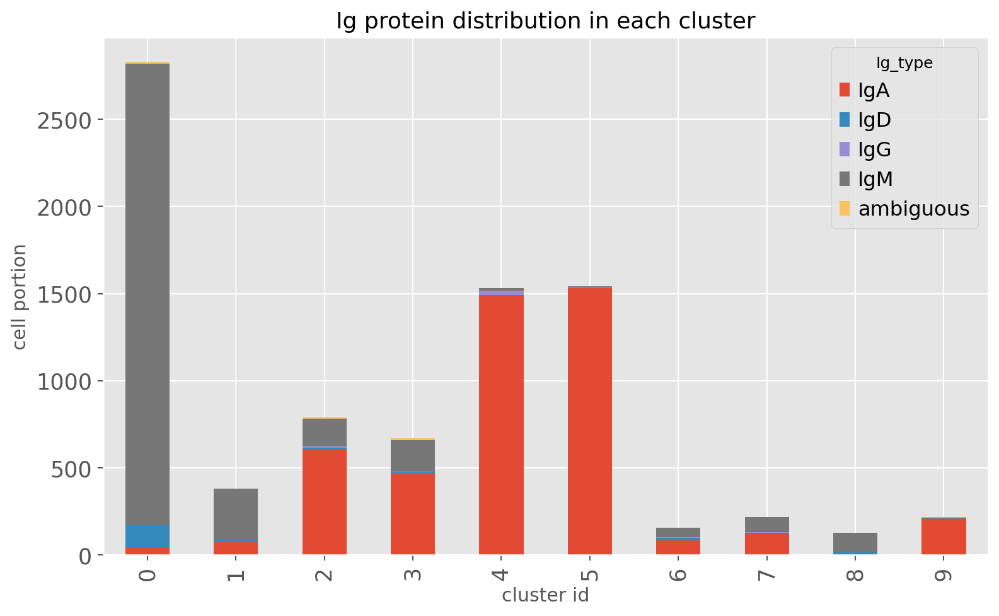

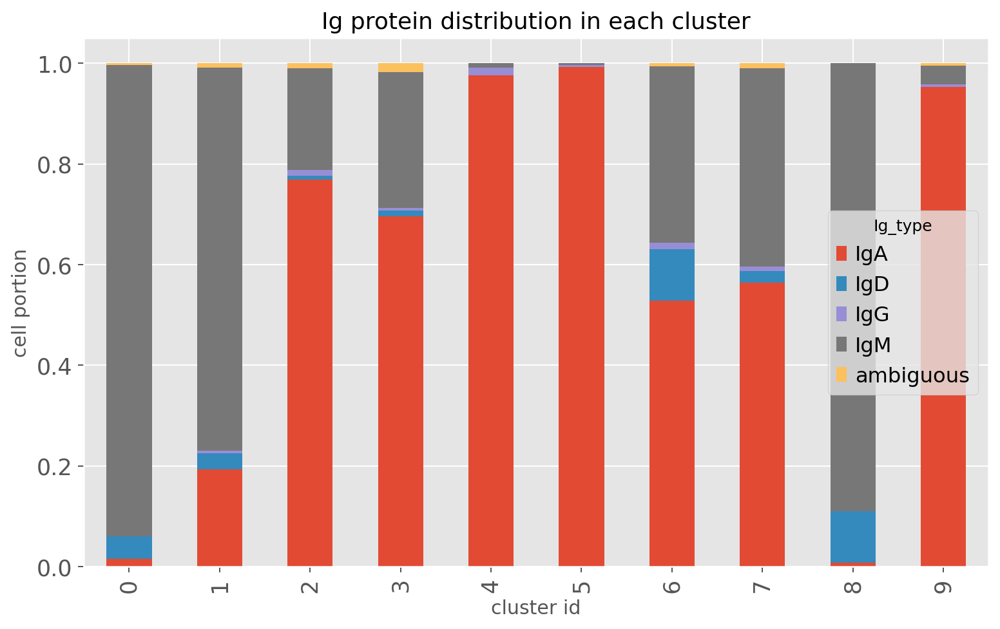

In [496]:
# ig type plot distribution
ax = b_adata.obs.groupby([bcell_cluster_key,'Ig_type']).size().unstack().plot(kind='bar', stacked=True, figsize=(10,6))
ax.set_title('Ig protein distribution in each cluster')
ax.set_xlabel('cluster id')
ax.set_ylabel('cell portion')

# ig type plot distribution
ax = b_adata.obs.groupby([bcell_cluster_key,'Ig_type']).size().unstack().apply(lambda x: x/sum(x),axis=1).plot(kind='bar', stacked=True, figsize=(10,6))
ax.set_title('Ig protein distribution in each cluster')
ax.set_xlabel('cluster id')
ax.set_ylabel('cell portion')

    using 'X_pca' with n_pcs = 20
Storing dendrogram info using `.uns['dendrogram_Bcell_leiden_r0.5']`


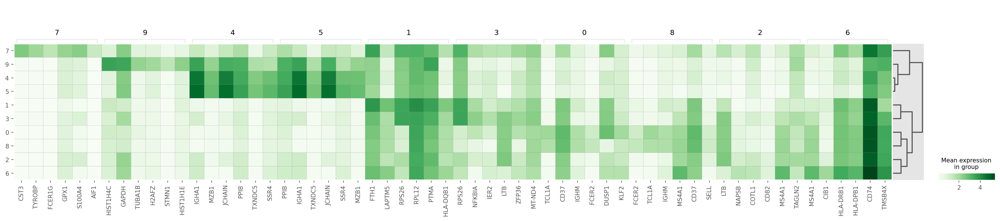

In [497]:
# plot heatmap include only expressed genes,  mean expression
bmarker = sctool.get_cluster_markers(b_adata, bcell_rank_key)
bmarker_dict = {}
for i in b_adata.uns[bcell_rank_key]['names'].dtype.fields:
    sub = bmarker.query(f'`{i}_logfoldchanges` > 0.58 and `{i}_pvals_adj` < 0.05')[f'{i}_names'].tolist()
    bmarker_dict[i] = [g for g in sub if g in expr_10genes]
# groups = ['0','1','5','12']
groups = [str(i) for i in bmarker_dict]
group_dict = {k:bmarker_dict[k][:6] for k in groups}
sc.pl.rank_genes_groups_matrixplot(b_adata, key=bcell_rank_key,cmap='Greens',groups=groups, var_names=group_dict)

    using 'X_pca' with n_pcs = 20
Storing dendrogram info using `.uns['dendrogram_Bcell_leiden_r0.5']`


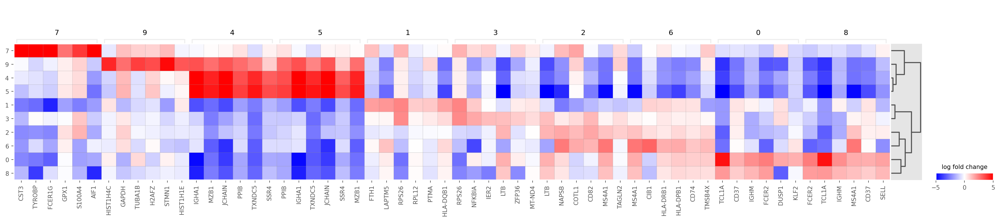

In [498]:
# plot heatmap include only expressed genes, logfoldchange
bmarker = sctool.get_cluster_markers(b_iga_adata, bcell_rank_key)
bmarker_dict = {}
for i in b_iga_adata.uns[bcell_rank_key]['names'].dtype.fields:
    sub = bmarker.query(f'`{i}_logfoldchanges` > 0.58 and `{i}_pvals_adj` < 0.05')[f'{i}_names'].tolist()
    bmarker_dict[i] = [g for g in sub if g in expr_10genes]

groups = [str(i) for i in bmarker_dict]
# groups = ['0', '1', '2', '3','4', '5', '6', '7', '8', '9', '10', '12', '13']
group_dict = {k:bmarker_dict[k][:6] for k in groups}
sc.pl.rank_genes_groups_matrixplot(b_iga_adata, key=bcell_rank_key, groups=groups,
                                   cmap='bwr', values_to_plot="logfoldchanges", var_names=group_dict, vmin=-5, vmax=5, dendrogram=True)

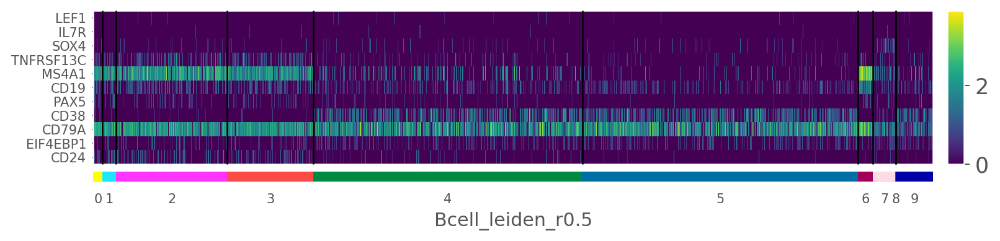

In [499]:
# B cell linearge genes
genes = ['IL7R','CD19','CD45','CD43','RAG1','RAG2','PAX5','SOX4','LEF1','CD34','CD38','CD24','TdT','CD179B','CD79A','EIF4EBP1','MS4A1','TNFRSF13C']
genes = list(set(genes).intersection(b_iga_adata.var.index))
sc.pl.heatmap(b_iga_adata, genes, groupby='Bcell_leiden_r0.5',swap_axes=True)

### Trajectory analysis 

#### Using monocol2

In [500]:
#Preprocessing for monocle
adata_ent = b_iga_adata.copy()
data_mat_mon = adata_ent.layers['counts'].T
var_mon=adata_ent.var.copy()
obs_mon=adata_ent.obs.copy()

In [501]:
%%R -i data_mat_mon -i obs_mon -i var_mon

#Set up the CellDataSet data structure
pd <- AnnotatedDataFrame(data = obs_mon)
fd <- AnnotatedDataFrame(data = var_mon)
colnames(data_mat_mon) <- rownames(pd)
rownames(data_mat_mon) <- rownames(fd)
ie_regions_cds <- newCellDataSet(cellData=data_mat_mon, phenoData=pd, featureData=fd, expressionFamily=negbinomial.size())

#Normalize the count data
ie_regions_cds <- estimateSizeFactors(ie_regions_cds)

#Calculate dispersions to filter for highly variable genes
ie_regions_cds <- estimateDispersions(ie_regions_cds)


#Filter for Stem, EP, TA, and Enterocytes
cell_types = as.character(pData(ie_regions_cds)$Bcell_leiden_r0.5)
cell_mask = rep(FALSE, length(cell_types))
cells_to_keep = cell_types # c("Stem", "EP", "TA", "Enterocyte")
for (item in cells_to_keep) {cell_mask = cell_mask | startsWith(cell_types, item)}
print("Number of cells after filtering:")
print(sum(cell_mask))
print("")

#Filter highly variable genes from our analysis
hvg_mask = fData(ie_regions_cds)$highly_variable
ie_regions_cds <- ie_regions_cds[hvg_mask, cell_mask]

#Do dimensionality reduction
ie_regions_cds <- reduceDimension(ie_regions_cds, norm_method = 'vstExprs', reduction_method='DDRTree', verbose = F, max_components = 7)

#Run for the first time to get the ordering
ie_regions_cds <- orderCells(ie_regions_cds)

#Find the correct root state the corresponds to the 'Stem' cluster
tab1 <- table(pData(ie_regions_cds)$State, pData(ie_regions_cds)$Bcell_leiden_r0.5)
id = which(colnames(tab1) == '5')
root_name = names(which.max(tab1[,id]))

#Run a second time to get the correct root state that overlaps with Stem cells
ie_regions_cds <- orderCells(ie_regions_cds, root_state=root_name)

[1] "Number of cells after filtering:"
[1] 4664
[1] ""


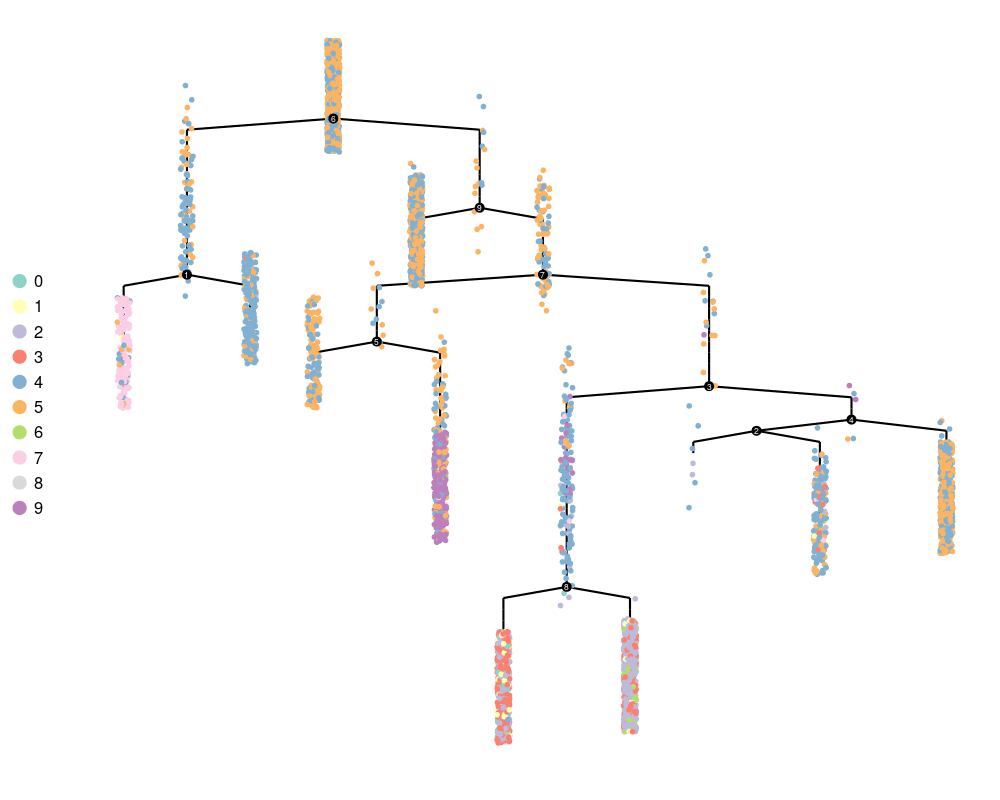

In [502]:
%%R -w 1000 -h 800

#Get a nice colour map
custom_colour_map = c(brewer.pal(12,'Set3'), brewer.pal(3,'Set1')) # brewer.pal(length(unique(pData(ie_regions_cds)$Bcell_leiden_r0.5)),'Paired')

#Find the correct root state that coresponds to the 'Stem' cluster
tab1 <- table(pData(ie_regions_cds)$State, pData(ie_regions_cds)$Bcell_leiden_r0.5)
id = which(colnames(tab1) == '5')
root_name = names(which.max(tab1[,id]))

# Visualize with our cluster labels
options(repr.plot.width=5, repr.plot.height=4)
plot_complex_cell_trajectory(ie_regions_cds, color_by = 'Bcell_leiden_r0.5', show_branch_points = T, 
                             cell_size = 2, cell_link_size = 1, root_states = c(root_name)) +
scale_size(range = c(0.2, 0.2)) +
theme(legend.position="left", legend.title=element_blank(), legend.text=element_text(size=rel(1.5))) +
guides(colour = guide_legend(override.aes = list(size=6))) + 
scale_color_manual(values = custom_colour_map)

### 3.1 DE analysis scRNA-Seq
#### 3.1.1 using wilcoxn test for each cluster
Here we use genes that are expressed in at least 10 percent of all the original cells

In [ ]:
b_iga_adata.obs[['condition','Bcell_leiden_r0.5']].value_counts()

condition  Bcell_leiden_r0.5
IgAN       5                    925
           4                    901
control    5                    606
           4                    592
           3                    459
IgAN       2                    421
control    2                    195
IgAN       9                    170
control    7                    108
           1                     74
IgAN       6                     72
           0                     50
control    9                     37
IgAN       3                     20
           7                     17
control    6                     12
           0                      2
IgAN       1                      2
           8                      1
dtype: int64

We can see that cluster 8 only has Igan cell, so can't do DE analysis. Here we need to remove cluster 8 first

In [518]:
b_iga_adata = b_iga_adata[b_iga_adata.obs['Bcell_leiden_r0.5'] != '8',:]

In [519]:
concat_df, merge_df = sctool.clust_de_wilcoxon(b_iga_adata, 'Bcell_leiden_r0.5', 'condition', 'control', 'wilcoxn_IgA+_Bcell_igan_vs_ctrl')

filtered out 10580 genes that are detected in less than 5.2 cells
ranking genes
--> Few observations in a group for normal approximation (<=25). Lower test accuracy.
    finished: added to `.uns['wilcoxn_IgA+_Bcell_igan_vs_ctrl_clust0']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:00)
filtered out 11505 genes that are detected in less than 7.6000000000000005 cells
ranking genes
--> Few observations in a group for normal approximation (<=25). Lower test accuracy.
    finished: added to `.uns['wilcoxn_IgA+_Bcell_igan_vs_ctrl_clust1']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
   

In [520]:
# merge data using the cluster 0 gene ranking
merge_df.index.name = 'Gene'
bde_res_path = f'{work_dir}/DE/Cluster_B_cells'
os.makedirs(bde_res_path, exist_ok=True)
merge_de_fn = f'{bde_res_path}/IgA+_Bcell_clusts_igan_vs_ctrl.tsv'
merge_df.to_csv(merge_de_fn, sep='\t')
# concat data keep the origin order
concat_de_fn = f'{bde_res_path}/IgA+_Bcell_clusts_igan_vs_ctrl_keep_origin_rank.tsv'
concat_df.to_csv(concat_de_fn, sep='\t', index=False)

Plot some statistics of DE results of wilcoxon methods

Text(0, 0.5, 'number of DE genes')

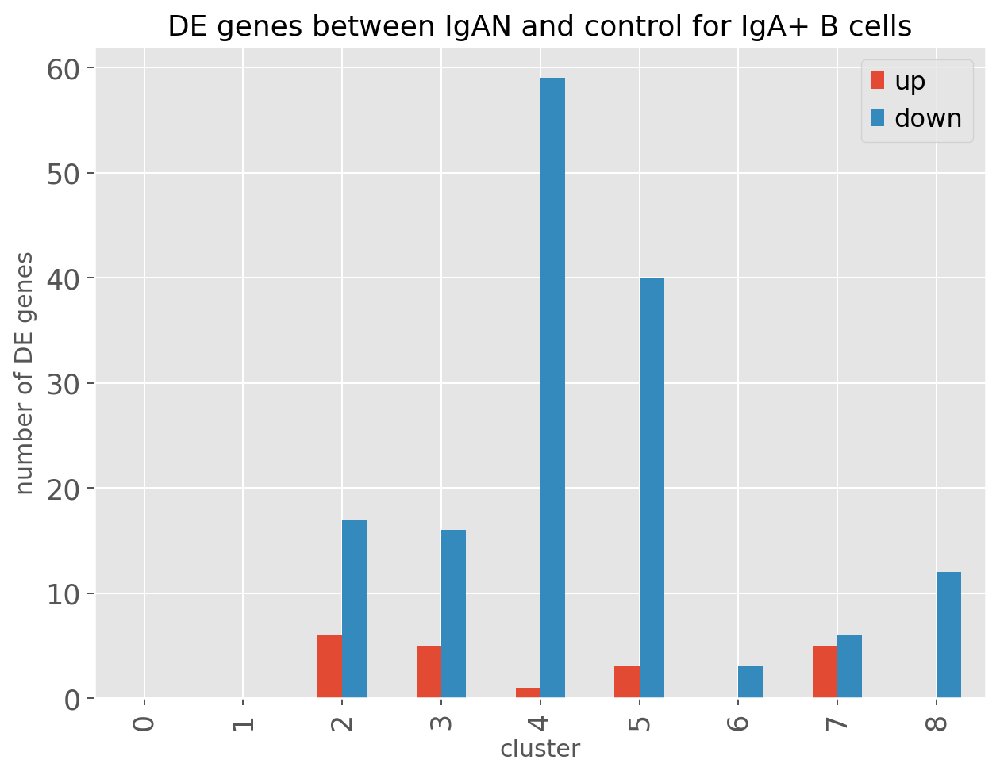

In [522]:
log2fc = 1
pval = 0.05
clusts = b_iga_adata.obs['Bcell_leiden_r0.5'].cat.categories
up_n = []; dn_n = []
up_dict = {}; dn_dict = {}; other_dict = {}
for i in clusts:
    up = merge_df.query(f'clust{i}_logfoldchanges > {log2fc} and clust{i}_pvals_adj < {pval}')
    dn = merge_df.query(f'clust{i}_logfoldchanges < -{log2fc} and clust{i}_pvals_adj < {pval}')
    up_n.append(up.shape[0])
    dn_n.append(dn.shape[0])
    up_dict[i] = up.index
    dn_dict[i] = dn.index
    other_dict[i] = list(set(merge_df.index) - set(up.index) - set(dn.index))
df = pd.DataFrame({'up':up_n, 'down':dn_n})
ax = df.plot(kind='bar', figsize=(8,6))
ax.set_title('DE genes between IgAN and control for IgA+ B cells')
ax.set_xlabel('cluster')
ax.set_ylabel('number of DE genes')

Scatter plot of genes between conditions

In [523]:
# get gene expression in IgAN and control
clusts = b_iga_adata.obs['Bcell_leiden_r0.5'].cat.categories
rows = [c + '_igan' for c in clusts] + [c + '_ctrl' for c in clusts]

res = pd.DataFrame(columns=b_iga_adata.var_names, index=rows)
# get mean gene expression for each cluster
for cl in clusts:
    ctrl = b_iga_adata[b_iga_adata.obs.query('`Bcell_leiden_r0.5` == @cl and condition == "control"').index,:]
    res.loc[f'{cl}_ctrl'] = ctrl.X.mean(0)
    igan = b_iga_adata[b_iga_adata.obs.query('`Bcell_leiden_r0.5` == @cl and condition == "IgAN"').index,:]
    res.loc[f'{cl}_igan'] = igan.X.mean(0)

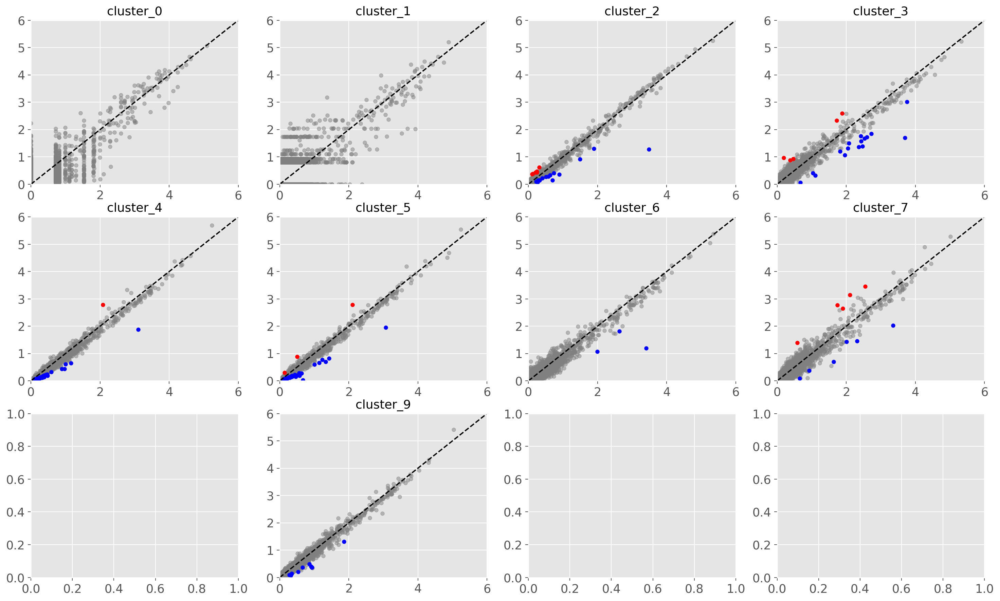

In [526]:
# scatter plot of gene expression in IgAN and control
row = 3
col = 4
fig, axes = plt.subplots(row,col, figsize=(20,12),sharex=False, sharey=False)

for cl in b_iga_adata.obs['Bcell_leiden_r0.5'].cat.categories:
    x = f'{cl}_ctrl'
    y = f'{cl}_igan'
    
    n = int(cl)
    j = n % col
    i = n // col
    res.loc[[x,y],other_dict[cl]].T.plot(kind='scatter', x=x,y=y, color='grey', ax=axes[i,j], alpha=0.5)
    res.loc[[x,y],up_dict[cl]].T.plot(kind='scatter', x=x,y=y, color='r', ax=axes[i,j])
    res.loc[[x,y],dn_dict[cl]].T.plot(kind='scatter', x=x,y=y, color='b', ax=axes[i,j])
    axes[i,j].set_ylim(0,6)
    axes[i,j].set_xlim(0,6)
    axes[i,j].set_xlabel('')
    axes[i,j].set_ylabel('')
    axes[i,j].set_title(f'cluster_{cl}')
    axes[i,j].plot([0, 6], [0, 6], transform=axes[i,j].transAxes, ls='--', color='black')

MA plot

In [527]:
# get mean expression of genes
clusts = b_iga_adata.obs['Bcell_leiden_r0.5'].cat.categories
rows = [f'clust{c}_mean' for c in clusts]

ma_df = pd.DataFrame(columns=b_iga_adata.var_names, index=rows)

# get mean gene expression for each cluster
for cl in clusts:
    clst = b_iga_adata[b_iga_adata.obs.query('`Bcell_leiden_r0.5` == @cl').index,:]
    ma_df.loc[f'clust{cl}_mean',:] = clst.X.mean(0)
ma_df = ma_df.T
ma_df = pd.merge(merge_df, ma_df, how='left', left_index=True, right_index=True)

for cl in b_iga_adata.obs['Bcell_leiden_r0.5'].cat.categories:
    ma_df[f'clust{cl}_pvals_adj'] = -np.log10(ma_df[f'clust{cl}_pvals_adj'])

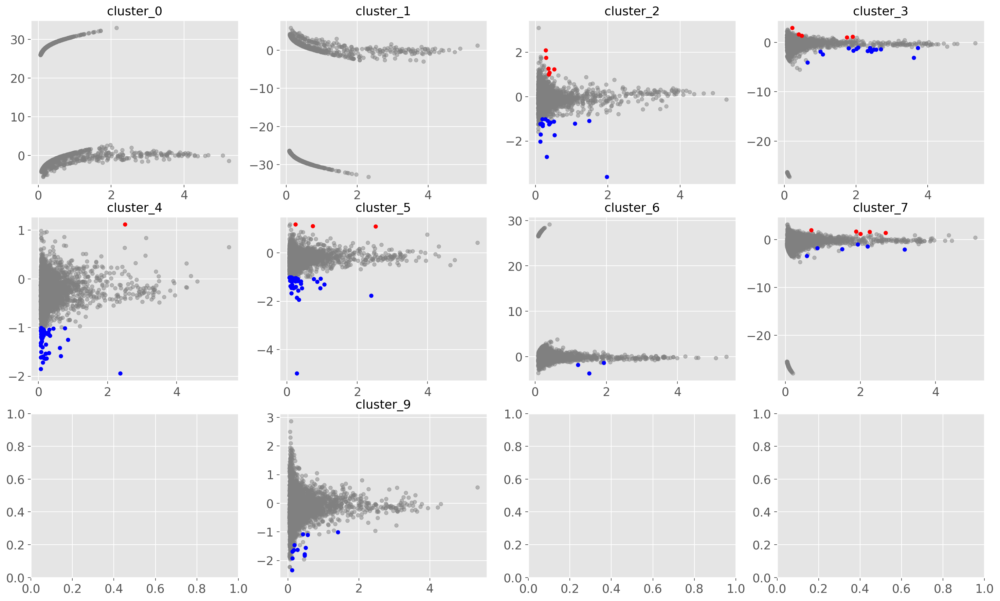

In [528]:
# MA plot,  logfoldchange  vs  mean expression
row = 3
col = 4
fig, axes = plt.subplots(row,col, figsize=(20,12),sharex=False, sharey=False)

for cl in b_iga_adata.obs['Bcell_leiden_r0.5'].cat.categories:
    x = f'clust{cl}_mean'
    y = f'clust{cl}_logfoldchanges'
    
    n = int(cl)
    j = n % col
    i = n // col
    ma_df.loc[other_dict[cl], [x,y]].plot(kind='scatter', x=x,y=y, color='grey', ax=axes[i,j], alpha=0.5)
    ma_df.loc[up_dict[cl], [x,y]].plot(kind='scatter', x=x,y=y, color='r', ax=axes[i,j])
    ma_df.loc[dn_dict[cl], [x,y]].plot(kind='scatter', x=x,y=y, color='b', ax=axes[i,j])
    # axes[i,j].set_ylim(0,6)
    # axes[i,j].set_xlim(0,6)
    axes[i,j].set_xlabel('')
    axes[i,j].set_ylabel('')
    axes[i,j].set_title(f'cluster_{cl}')
    # axes[i,j].plot([0, 6], [0, 6], transform=axes[i,j].transAxes, ls='--', color='black')

Gene expressed in percent of cells

#### 3.1.2 using MAST to run DE analysis for each cluster

In [503]:
def prep_anndata(adata_):
    def fix_dtypes(adata_):
        df = pd.DataFrame(adata_.X.A, index=adata_.obs_names, columns=adata_.var_names)
        df = df.join(adata_.obs)
        return sc.AnnData(df[adata_.var_names], obs=df.drop(columns=adata_.var_names))

    adata_ = fix_dtypes(adata_)
    sc.pp.filter_genes(adata_, min_cells=3)
    return adata_

In [208]:
%%R
find_de_MAST_RE <- function(adata_, test){
    # create a MAST object
    sca <- SceToSingleCellAssay(adata_, class = "SingleCellAssay")
    print("Dimensions before subsetting:")
    print(dim(sca))
    print("")
    # keep genes that are expressed in more than 10% of all cells
    sca <- sca[freq(sca)>0.1,]
    print("Dimensions after subsetting:")
    print(dim(sca))
    print("")
    # add a column to the data which contains scaled number of genes that are expressed in each cell
    cdr2 <- colSums(assay(sca)>0)
    colData(sca)$ngeneson <- scale(cdr2)
    # store the columns that we are interested in as factors
    label <- factor(colData(sca)$condition)
    # set the reference level
    label <- relevel(label, "control")
    colData(sca)$label <- label
    cluster <- factor(colData(sca)$Bcell_leiden_r0.5)
    colData(sca)$cluster <- cluster
    # same for donors (which we need to model random effects)
    replicate <- factor(colData(sca)$sample)
    colData(sca)$replicate <- replicate
    # create a group per condition-celltype combination
    colData(sca)$group <- paste0(colData(adata_)$condition, ".", colData(adata_)$Bcell_leiden_r0.5)
    colData(sca)$group <- factor(colData(sca)$group)
    # define and fit the model
    zlmCond <- zlm(formula = ~ngeneson + group + (1 | replicate), 
                   sca=sca, 
                   method='glmer', 
                   ebayes=F, 
                   strictConvergence=F,
                   fitArgsD=list(nAGQ = 0)) # to speed up calculations
    
    # perform likelihood-ratio test for the condition that we are interested in    
    summaryCond <- summary(zlmCond, doLRT=test)
    # get the table with log-fold changes and p-values
    summaryDt <- summaryCond$datatable
    result <- merge(summaryDt[contrast==test & component=='H',.(primerid, `Pr(>Chisq)`)], # p-values
                     summaryDt[contrast==test & component=='logFC', .(primerid, coef)],
                     by='primerid') # logFC coefficients
    # MAST uses natural logarithm so we convert the coefficients to log2 base to be comparable to edgeR
    result[,coef:=result[,coef]/log(2)]
    # do multiple testing correction
    result[,FDR:=p.adjust(`Pr(>Chisq)`, 'fdr')]
    # result = result[result$FDR<0.01,, drop=F]

    result <- stats::na.omit(as.data.frame(result))
    return(result)
}

In [214]:
# Create new Anndata object for use in MAST with non-batch corrected data as before
adata_test = b_iga_adata.copy()
adata_test.X = adata_test.layers['counts'].copy()
sc.pp.normalize_total(adata_test, target_sum=1e4)
sc.pp.log1p(adata_test)
adata_test = prep_anndata(adata_test)

normalizing counts per cell
    finished (0:00:00)
filtered out 2 genes that are detected in less than 3 cells


In [ ]:
%%time
%%R -i adata_test -o mast_des
mast_des = list()
clusts = levels(colData(adata_test)$Bcell_leiden_r0.5)
for (i in clusts) {
    print(i)
    cl = adata_test[,colData(adata_test)$Bcell_leiden_r0.5 == i]
    test = paste0('groupIgAN.',i)
    res <- find_de_MAST_RE(cl, test)
    mast_des[[i]] = res
}

[1] "0"
[1] "Dimensions before subsetting:"
[1] 16577  3918
[1] ""
[1] "Dimensions after subsetting:"
[1] 5010 3918
[1] ""
[1] "1"
[1] "Dimensions before subsetting:"
[1] 16577  2468
[1] ""
[1] "Dimensions after subsetting:"
[1] 4368 2468
[1] ""
[1] "2"
[1] "Dimensions before subsetting:"
[1] 16577   101
[1] ""
[1] "Dimensions after subsetting:"
[1] 4944  101
[1] ""


In [ ]:
# organize the DE results into a dataframe
for k,de in mast_des.items():
    mast_des[k].columns = [f'clust{k}_' + c for c in ['names','pvals','logfoldchanges','pvals_adj']]
mast_des = [mast_des[k] for k in mast_des]
mast_concat_df = pd.concat(mast_des, axis=1)
for de in mast_des:
    de.index = de.iloc[:,0]
    del de[de.columns[0]]

In [ ]:
# merge data using the cluster 0 gene ranking
mast_merge_df = reduce(lambda left, right: pd.merge(left, right, left_index=True, right_index=True, how='outer'), mast_des)
mast_merge_df = mast_merge_df.sort_values('clust0_pvals_adj')
mast_merge_df.index.name = 'Gene'
bde_res_path = f'{work_dir}/DE/Cluster_B_cells'
os.makedirs(bde_res_path, exist_ok=True)
merge_de_fn = f'{bde_res_path}/MAST_IgA+_Bcell_clusts_igan_vs_ctrl.tsv'
mast_merge_df.to_csv(merge_de_fn, sep='\t')

In [ ]:
mast_concat_fn = f'{bde_res_path}/MAST_IgA+_Bcell_clusts_igan_vs_ctrl_keep_orign_rank.tsv'
mast_concat_df.to_csv(mast_concat_fn, sep='\t', index=False)

In [ ]:
ax, (up_dict, dn_dict, non_de_dict) = sctool.plot_rank_gene_de_num(mast_merge_df, ncol_clust=3, 
                                                title='MAST DE genes between IgAN and control for IgA+ B cells', lfc=0.58, padj=0.05)

MA plot for DE results of each cluster

In [ ]:
# get mean expression of genes
clust = b_iga_adata.obs['Bcell_leiden_r0.5'].cat.categories
rows = [f'clust{c}_mean' for c in clust]

ma_df = pd.DataFrame(columns=b_iga_adata.var_names, index=rows)

# get mean gene expression for each cluster
for cl in b_iga_adata.obs['Bcell_leiden_r0.5'].cat.categories:
    clst = b_iga_adata[b_iga_adata.obs.query('`Bcell_leiden_r0.5` == @cl').index,:]
    ma_df.loc[f'clust{cl}_mean',:] = clst.X.mean(0)
ma_df = ma_df.T
ma_df = pd.merge(mast_merge_df, ma_df, how='left', left_index=True, right_index=True)

for cl in b_iga_adata.obs['Bcell_leiden_r0.5'].cat.categories:
    ma_df[f'clust{cl}_pvals_adj'] = -np.log10(ma_df[f'clust{cl}_pvals_adj'])

In [ ]:
# MA plot,  logfoldchange  vs  mean expression
row = 3
col = 4
fig, axes = plt.subplots(row,col, figsize=(20,12),sharex=False, sharey=False)

for cl in b_iga_adata.obs['Bcell_leiden_r0.5'].cat.categories:
    x = f'clust{cl}_mean'
    y = f'clust{cl}_logfoldchanges'
    
    n = int(cl)
    j = n % col
    i = n // col
    ma_df.loc[non_de_dict[cl], [x,y]].plot(kind='scatter', x=x,y=y, color='grey', ax=axes[i,j], alpha=0.5)
    ma_df.loc[up_dict[cl], [x,y]].plot(kind='scatter', x=x,y=y, color='r', ax=axes[i,j])
    ma_df.loc[dn_dict[cl], [x,y]].plot(kind='scatter', x=x,y=y, color='b', ax=axes[i,j])
    axes[i,j].set_ylim(-2,2)
    axes[i,j].set_xlim(0,4)
    axes[i,j].set_xlabel('')
    axes[i,j].set_ylabel('')
    axes[i,j].set_title(f'cluster_{cl}')
    # axes[i,j].plot([0, 6], [0, 6], transform=axes[i,j].transAxes, ls='--', color='black')

Check DE gene overlap between clusters

In [ ]:
def de_gene_heatmap(dict2plot, dtype='raw'):
    '''plot heatmap for gene overlap between clusters of DE results'''
    rows = [f'{c}' for c in dict2plot.keys()]
    cols = [f'{c}' for c in dict2plot.keys()]
    de_clusts_genes_df = pd.DataFrame(index=rows, columns=cols)
    for i in range(len(rows)):
        row_genes = dict2plot[rows[i]]
        for j in range(len(cols)):
            col_genes = dict2plot[cols[j]]
            inter = len(set(row_genes).intersection(col_genes))

            if i != j:
                val = round(inter / len(row_genes), 2)
            # elif i < j:
            #     val = round(inter / len(col_genes), 2)
            #     print(val, inter, len(row_genes))
            elif i == j:
                val = 1
            if dtype == 'percent':
                de_clusts_genes_df.loc[rows[i],cols[j]] = val
            elif dtype == 'raw':
                de_clusts_genes_df.loc[rows[i],cols[j]] = inter
    de_clusts_genes_df = de_clusts_genes_df.astype(float)
    return de_clusts_genes_df

In [ ]:
pval = 0.05
lfc = 0.58
up_genes_dict = {}
dn_genes_dict = {}
de_genes_dict = {}
for i in range(nclusts):
    cols = [c for c in mast_merge_df.columns if f'clust{i}' in c]
    clust_df = mast_merge_df[cols]
    up_genes = clust_df.query(f'clust{i}_pvals_adj < {pval} and clust{i}_logfoldchanges > {lfc}').index.tolist()
    dn_genes = clust_df.query(f'clust{i}_pvals_adj < {pval} and clust{i}_logfoldchanges < -{lfc}').index.tolist()
    up_genes_dict[f'{i}'] = up_genes
    dn_genes_dict[f'{i}'] = dn_genes
    de_genes_dict[f'{i}'] = up_genes + dn_genes

In [ ]:
dtype = 'raw'
up_clusts_genes_df = de_gene_heatmap(up_genes_dict, dtype)
dn_clusts_genes_df = de_gene_heatmap(dn_genes_dict, dtype)
de_clusts_genes_df = de_gene_heatmap(de_genes_dict, dtype)

In [ ]:
# up genes
plt.figure(figsize=(10,8))
ax = sb.heatmap(up_clusts_genes_df, annot=True,cmap='Blues',fmt='g',vmin=0,vmax=125)
ax.set(title='up genes in IgAN vs control')
# dn genes
plt.figure(figsize=(10,8))
ax = sb.heatmap(dn_clusts_genes_df, annot=True,cmap='Blues',fmt='g',vmin=0,vmax=125)
ax.set(title='dn genes in IgAN vs control')
# de genes
plt.figure(figsize=(10,8))
ax = sb.heatmap(de_clusts_genes_df, annot=True,cmap='Blues',fmt='g',vmin=0,vmax=125)
ax.set(title='de genes in IgAN vs control')

GSEA analysis for MAST DE analysis for each cluster

In [ ]:
def run_enrichr(genes, gene_sets=['GO_Biological_Process_2021'], organism='human', outdir=None):
    enr = gp.enrichr(gene_list=genes, # or "./tests/data/gene_list.txt",
                     gene_sets=gene_sets, # GO_Cellular_Component_2021, GO_Biological_Process_2021
                     organism=organism, # don't forget to set organism to the one you desired! e.g. Yeast
                     outdir=outdir) # don't write to disk)
    return enr

In [ ]:
pval = 0.05
lfc = 0.58
up_go_dict = {}
dn_go_dict = {}
for i in range(nclusts):
    cols = [c for c in mast_merge_df.columns if f'clust{i}' in c]
    clust_df = mast_merge_df[cols]
    up_genes = clust_df.query(f'clust{i}_pvals_adj < {pval} and clust{i}_logfoldchanges > {lfc}').index.tolist()
    dn_genes = clust_df.query(f'clust{i}_pvals_adj < {pval} and clust{i}_logfoldchanges < -{lfc}').index.tolist()
    # up go term
    up_go_dict[str(i)] = run_enrichr(up_genes)
    dn_go_dict[str(i)] = run_enrichr(dn_genes)

In [ ]:
# up go term
for i in range(nclusts):
    try:
        gp.dotplot(up_go_dict[str(i)].res2d, title=f'cluster{i}_up',cmap='viridis_r', size=10, figsize=(3,5), cutoff=0.1)
    except:
        pass

In [ ]:
# dn go term
for i in range(nclusts):
    try:
        gp.dotplot(dn_go_dict[str(i)].res2d, title=f'cluster{i}_down',cmap='viridis_r', size=10, figsize=(3,5), cutoff=0.05)
    except:
        pass

#### 3.1.3 MAST DE analysis for combined IgAN and control

In [529]:
%%R
run_mast <- function(adata_, test){
    # create a MAST object
    sca <- SceToSingleCellAssay(adata_, class = "SingleCellAssay")
    print("Dimensions before subsetting:")
    print(dim(sca))
    print("")
    # keep genes that are expressed in more than 10% of all cells
    sca <- sca[freq(sca)>0.1,]
    print("Dimensions after subsetting:")
    print(dim(sca))
    print("")
    # add a column to the data which contains scaled number of genes that are expressed in each cell
    cdr2 <- colSums(assay(sca)>0)
    colData(sca)$ngeneson <- scale(cdr2)
    # store the columns that we are interested in as factors
    label <- factor(colData(sca)$condition)
    # set the reference level
    label <- relevel(label, "control")
    colData(sca)$label <- label
    cluster <- factor(colData(sca)$Bcell_leiden_r0.5)
    colData(sca)$cluster <- cluster
    # same for donors (which we need to model random effects)
    replicate <- factor(colData(sca)$sample)
    colData(sca)$replicate <- replicate
    # create a group per condition-celltype combination
    colData(sca)$group <- paste0(colData(adata_)$condition)
    colData(sca)$group <- factor(colData(sca)$group)
    # define and fit the model
    zlmCond <- zlm(formula = ~ngeneson + group + (1 | replicate), 
                   sca=sca, 
                   method='glmer', 
                   ebayes=F, 
                   strictConvergence=F,
                   fitArgsD=list(nAGQ = 0)) # to speed up calculations
    
    # perform likelihood-ratio test for the condition that we are interested in    
    summaryCond <- summary(zlmCond, doLRT=test)
    # get the table with log-fold changes and p-values
    summaryDt <- summaryCond$datatable
    result <- merge(summaryDt[contrast==test & component=='H',.(primerid, `Pr(>Chisq)`)], # p-values
                     summaryDt[contrast==test & component=='logFC', .(primerid, coef)],
                     by='primerid') # logFC coefficients
    # MAST uses natural logarithm so we convert the coefficients to log2 base to be comparable to edgeR
    result[,coef:=result[,coef]/log(2)]
    # do multiple testing correction
    result[,FDR:=p.adjust(`Pr(>Chisq)`, 'fdr')]
    # result = result[result$FDR<0.01,, drop=F]

    result <- stats::na.omit(as.data.frame(result))
    return(result)
}

In [535]:
#Create new Anndata object for use in MAST with non-batch corrected data as before
adata_test = b_iga_adata.copy()
adata_test.X = adata_test.layers['counts'].copy()
sc.pp.normalize_total(adata_test, target_sum=1e4)
sc.pp.log1p(adata_test)
rm_clusts = []  # remove cluster downstrea analysis, empty means don't remove any cluster
adata_test = adata_test[adata_test.obs.query('`Bcell_leiden_r0.5` not in @rm_clusts').index,:]
adata_test = prep_anndata(adata_test)

normalizing counts per cell
    finished (0:00:00)
filtered out 35 genes that are detected in less than 3 cells


In [536]:
adata_test.obs['Bcell_leiden_r0.5'].value_counts()

5    1531
4    1493
2     616
3     479
9     207
7     125
6      84
1      76
0      52
Name: Bcell_leiden_r0.5, dtype: int64

In [537]:
%%time
%%R -i adata_test -o mast_de
mast_de <- run_mast(adata_test, 'groupIgAN')

[1] "Dimensions before subsetting:"
[1] 14928  4663
[1] ""
[1] "Dimensions after subsetting:"
[1] 4900 4663
[1] ""
CPU times: user 21min 34s, sys: 28.4 s, total: 22min 2s
Wall time: 21min 56s


In [538]:
os.makedirs(f'{work_dir}/DE/Cluster_B_cells', exist_ok=True)
mast_de.columns = ['names','pvals','logfoldchanges','pvals_adj']
mast_de = mast_de.sort_values('pvals_adj')
mast_de.to_csv(f'{work_dir}/DE/Cluster_B_cells/MAST_all_cells_IgA+_Bcell_clusts_igan_vs_ctrl_rm_Ig_vari.tsv', sep='\t', index=False)

In [539]:
# volcano plot, please go to the work directory, there is a png file there showing the results
name = 'names'
logfc='logfoldchanges'
q_val = 'pvals_adj'
title = 'IgAN vs Control (scRNA-Seq)'

sctool.volcano(mast_de, name, logfc, q_val, 0.58, 0.05, work_dir, title, topN=0)

/usr/local/lib/python3.10/dist-packages/pandas/core/arraylike.py:402: RuntimeWarning: divide by zero encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family ['Arial'] not found. Falling back to DejaVu Sans.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
posx and posy should be finite values
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font fam

In [ ]:
sctool.volcano(ab_def, name, logfc, q_val, 0.58, 0.05, work_dir, title, topN=0)

MA plot

In [540]:
pval = 0.05
log2fc = 0.58
ma_df = pd.DataFrame(columns=adata_test.var_names, index=['mean'])
# get mean expression of genes
ma_df.loc['mean',:] = adata_test.X.mean(0)
ma_df = ma_df.T
ma_df = pd.merge(mast_de, ma_df, how='left', left_on='names', right_index=True)
ma_df.index = ma_df['names']
# up, dn and non_de_gene
up = ma_df.query(f'pvals < {pval} and logfoldchanges > {log2fc}')['names'].tolist()
dn = ma_df.query(f'pvals < {pval} and logfoldchanges < -{log2fc}')['names'].tolist()
non_de = list(set(ma_df['names'].tolist()) - set(up) - set(dn))

Text(0.5, 1.0, 'IgAN vs Control')

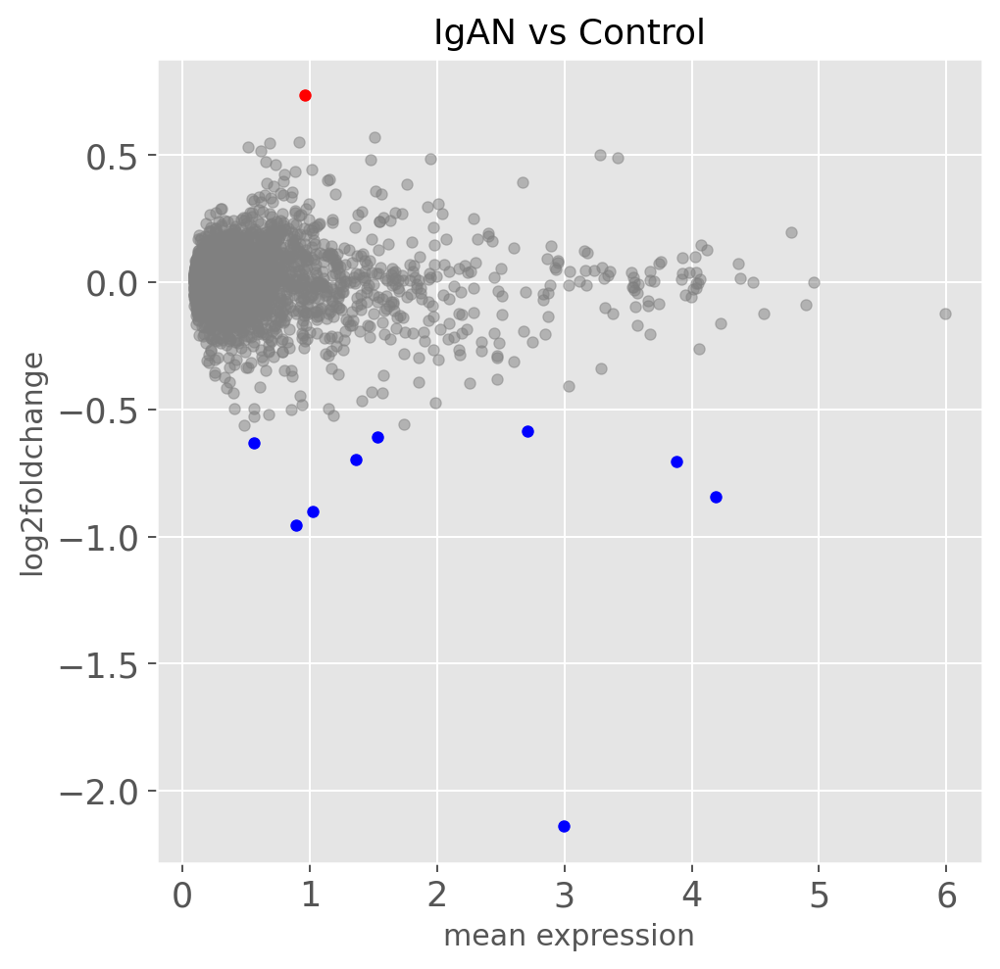

In [541]:
# plot
x = 'mean'
y = 'logfoldchanges'

fig, ax = plt.subplots()
ma_df.loc[non_de, [x,y]].plot(kind='scatter', x=x,y=y, color='grey', alpha=0.5, ax=ax)
ma_df.loc[up, [x,y]].plot(kind='scatter', x=x,y=y, color='r',ax=ax)
ma_df.loc[dn, [x,y]].plot(kind='scatter', x=x,y=y, color='b',ax=ax)
# axes[i,j].set_ylim(-2,2)
# axes[i,j].set_xlim(0,4)
ax.set_xlabel('mean expression')
ax.set_ylabel('log2foldchange')
ax.set_title(f'IgAN vs Control')

GO term analysis

In [542]:
pval = 0.05
log2fc = 0.58
mast_de_up_genes = mast_de.query(f'pvals < {pval} and logfoldchanges > {log2fc}')['names'].tolist()
mast_up_enr = gp.enrichr(gene_list=mast_de_up_genes, organism='Human', gene_sets='GO_Biological_Process_2021', cutoff = 0.5)

<Axes: title={'center': 'UP genes of IgAN vs Control (GO_Biological_Process_2021)'}, xlabel='Combined Score'>

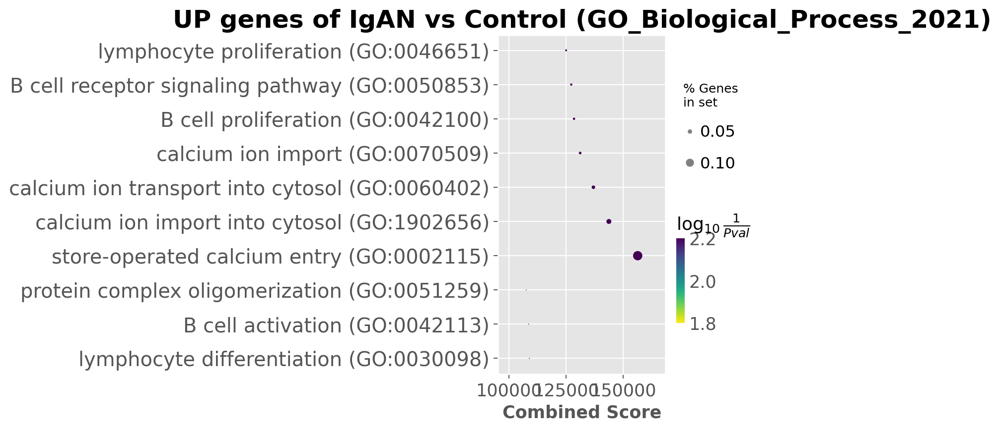

In [543]:
gp.dotplot(mast_up_enr.res2d, title=f'UP genes of IgAN vs Control (GO_Biological_Process_2021)',cmap='viridis_r', size=10, figsize=(3,5), cutoff=0.05)

<Axes: title={'center': 'GO_Biological_Process_2021'}, xlabel='$- \\log_{10}$ (Adjusted P-value)'>

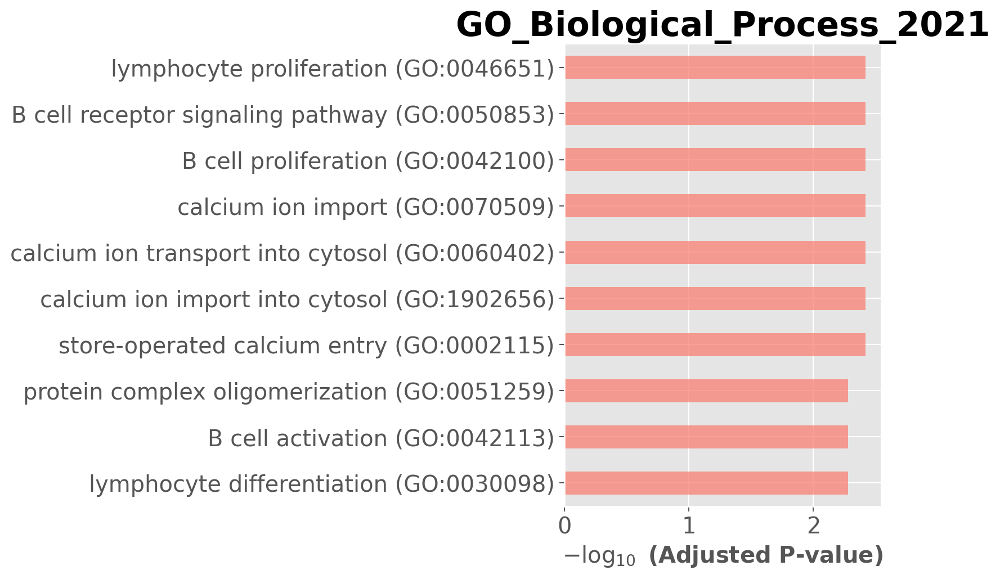

In [544]:
gp.barplot(mast_up_enr.res2d,title='GO_Biological_Process_2021')

GSEA analysis for MAST DE between merged IgAN and control

In [545]:
mast4gsea_df = mast_de.sort_values('logfoldchanges', ascending=False)
res = gp.prerank(mast4gsea_df[['names','logfoldchanges']], 
               gene_sets= 'MSigDB_Hallmark_2020',
               outdir=None,
              permutation_num=1000,
              threads=6)
sig_mast_gsea = res.res2d.query('`FDR q-val` < 0.05')

<Axes: title={'center': 'GSEA IgAN vs Control (MsigDB_hallmark)'}, xlabel='NES'>

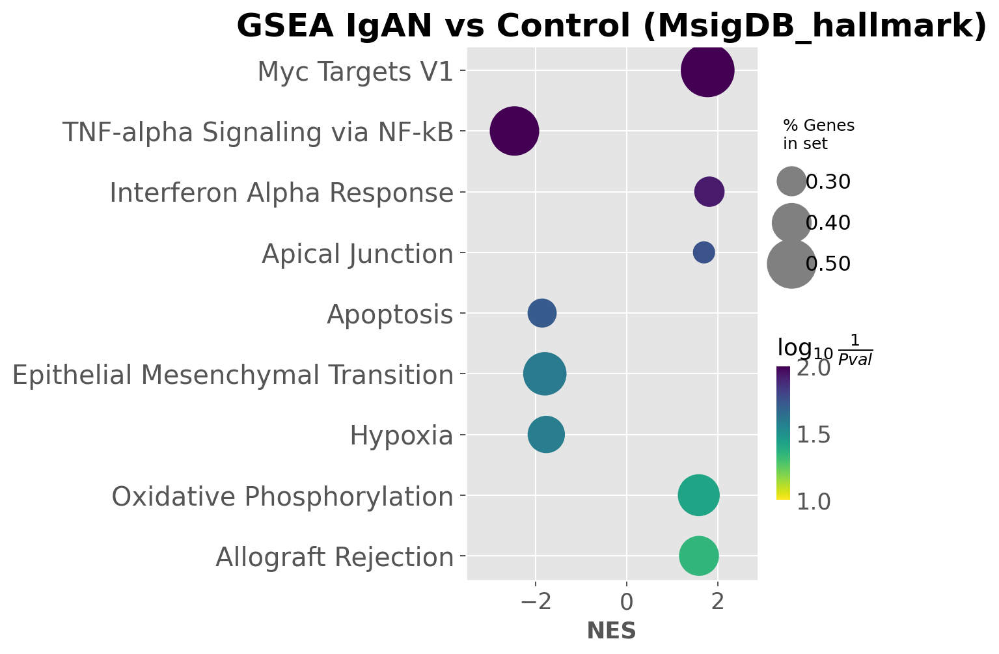

In [546]:
# dotplot 
gp.dotplot(res.res2d, title=f'GSEA IgAN vs Control (MsigDB_hallmark)',cmap='viridis_r', size=10,  cutoff=0.05,column='FDR q-val')

In [549]:
glyco_gene_fn = f'{work_dir}/glyco/glyco_genes.tsv'
glyco_df = pd.read_csv(glyco_gene_fn, sep='\t', header=0)
glyco_dict = {k:list(v) for k,v in glyco_df.groupby('Category')['Gene']}

In [550]:
mast4gsea_df = mast_de.sort_values('logfoldchanges', ascending=False)
res_glyco = gp.prerank(mast4gsea_df[['names','logfoldchanges']], 
               gene_sets= glyco_dict,
               outdir=None,
              permutation_num=1000,
              threads=6)
# sig_mast_gsea = res.res2d.query('`FDR q-val` < 0.05')

<Axes: title={'center': 'GSEA IgAN vs Control (Glycosylation pathways)'}, xlabel='NES'>

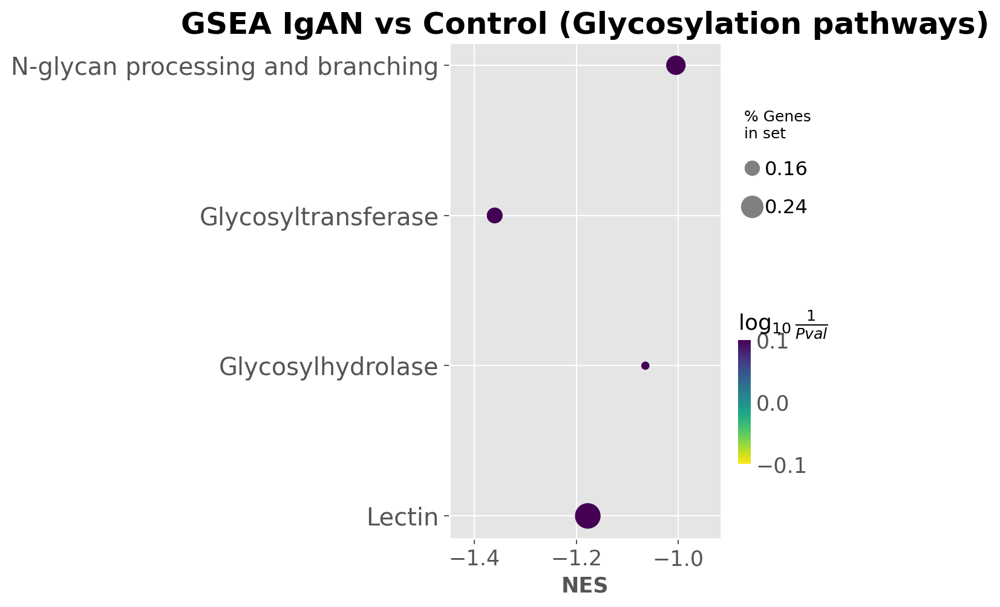

In [552]:
# dotplot
gp.dotplot(res_glyco.res2d, title=f'GSEA IgAN vs Control (Glycosylation pathways)',cmap='viridis_r', size=10,  cutoff=0.5,column='FDR q-val')

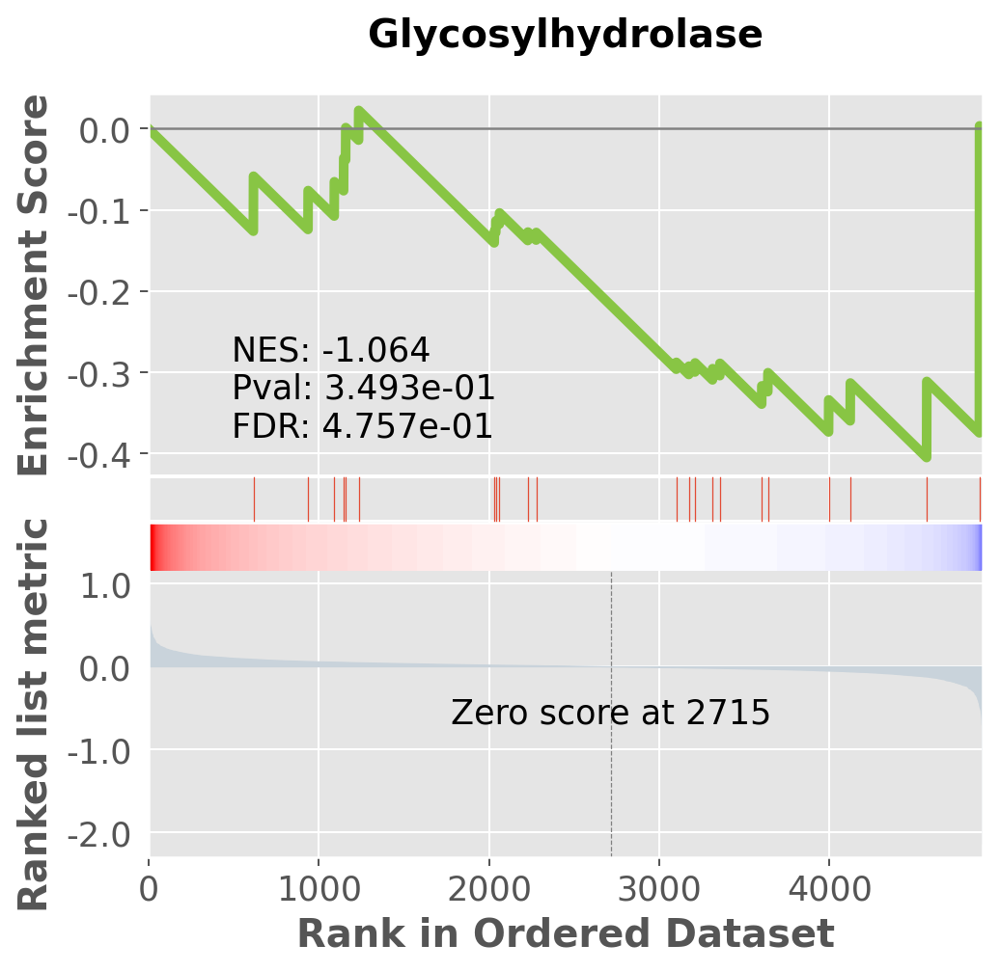

In [553]:
# gsea plot
term = 'Glycosylhydrolase'
gp.gseaplot(res_glyco.ranking, term=term, **res_glyco.results[term])

In [568]:
de_fn = f'{bde_res_path}/MAST_all_cells_IgA+_Bcell_clusts_igan_vs_ctrl.tsv'
mast_de.to_csv(de_fn, sep='\t', index=False)

In [569]:
mast_de = pd.read_csv(f'{bde_res_path}/MAST_all_cells_IgA+_Bcell_clusts_igan_vs_ctrl.tsv', sep='\t')
mast_de.columns = ['names','pvals','logfoldchanges','pvals_adj']

#### 3.1.3 GO term analysis

In [572]:
key = 'wilcoxn_IgA+_Bcell_igan_vs_ctrl_clust2'
up_glist = sc.get.rank_genes_groups_df(b_iga_adata, group='IgAN', key=key,pval_cutoff=0.05, log2fc_min=1)['names'].squeeze().str.strip().tolist()
dn_glist = sc.get.rank_genes_groups_df(b_iga_adata, group='IgAN', key=key,pval_cutoff=0.05, log2fc_max=-1)['names'].squeeze().str.strip().tolist()

In [574]:
up_enr = gp.enrichr(gene_list=up_glist, organism='Human', gene_sets='GO_Biological_Process_2021', cutoff = 0.5)
dn_enr = gp.enrichr(gene_list=dn_glist, organism='Human', gene_sets='GO_Biological_Process_2021', cutoff = 0.5)

up genes: 6
down genes: 26


<Axes: title={'center': 'GO_Biological_Process_2021'}, xlabel='$- \\log_{10}$ (Adjusted P-value)'>

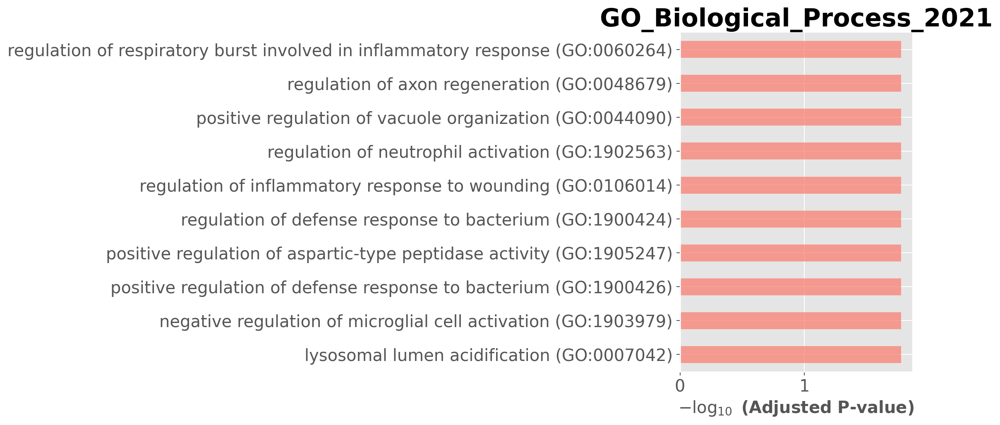

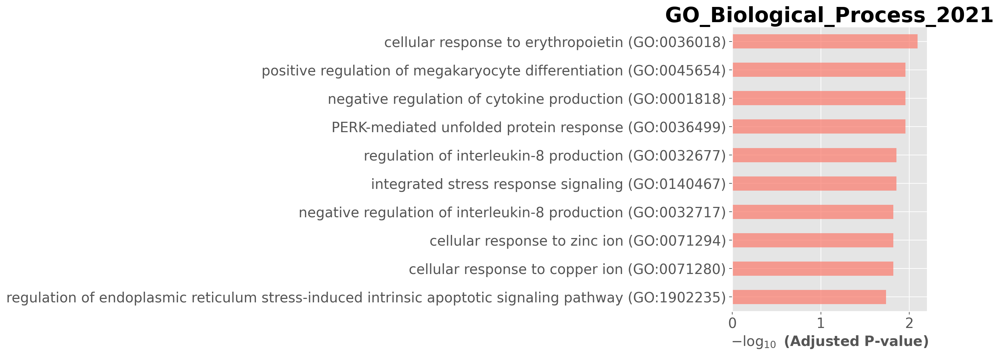

In [576]:
print('up genes:', len(up_glist))
gp.barplot(up_enr.res2d,title='GO_Biological_Process_2021')
print('down genes:', len(dn_glist))
gp.barplot(dn_enr.res2d,title='GO_Biological_Process_2021')

### 3.2 DE analysis CITE-Seq
#### 3.2.1 using wilcoxon

In [577]:
# rank genes group
ab_adata = sc.read_h5ad(f'{work_dir}/inter_h5ad/ab_adata.h5ad')
ab_adata.obs = pd.merge(ab_adata.obs, b_iga_adata.obs[['Bcell_leiden_r0.5']], how='left', left_index=True, right_index=True)
iga_ab_adata = ab_adata[~ab_adata.obs['Bcell_leiden_r0.5'].isna(),:]
sc.tl.rank_genes_groups(iga_ab_adata, 'Bcell_leiden_r0.5', method='wilcoxon')

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:00)


In [578]:
# ran DE analysis using wilcoxon analysis
ab_concat_df, ab_merge_df = sctool.clust_de_wilcoxon(iga_ab_adata, 'Bcell_leiden_r0.5', 'condition', 'control', 'Iga+_Bcite_igan_vs_ctrl')

ranking genes
--> Few observations in a group for normal approximation (<=25). Lower test accuracy.
    finished: added to `.uns['Iga+_Bcite_igan_vs_ctrl_clust0']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:00)
filtered out 1 genes that are detected in less than 7.6000000000000005 cells
ranking genes
--> Few observations in a group for normal approximation (<=25). Lower test accuracy.
    finished: added to `.uns['Iga+_Bcite_igan_vs_ctrl_clust1']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.rec

In [579]:
# output merged DE results to file
ab_merge_df.index.name = 'Gene'
bde_res_path = f'{work_dir}/DE/Cluster_B_cells'
os.makedirs(bde_res_path, exist_ok=True)
ab_merge_de_fn = f'{bde_res_path}/IgA+_Bcite_igan_vs_ctrl.tsv'
ab_merge_df.to_csv(ab_merge_de_fn, sep='\t')

In [ ]:
## plot of DE gene number for each condition -- skip for this notebook
ax, de_dicts = sctool.plot_rank_gene_de_num(ab_merge_df, title='DE genes between IgAN and control for IgA+ B cells', ncol_clust=6, lfc=0.58, padj=0.05)
up_dict, dn_dict, non_de_dict = de_dicts

Scatter plot of gene expression between conditions

In [582]:
# get IgAN and control * gene expression --  skip for this notebook
clusts = iga_ab_adata.obs['Bcell_leiden_r0.5'].cat.categories
rows = [c + '_igan' for c in clusts] + [c + '_ctrl' for c in clusts]

res = pd.DataFrame(columns=iga_ab_adata.var_names, index=rows)
# get mean gene expression for each cluster
for cl in iga_ab_adata.obs['Bcell_leiden_r0.5'].cat.categories:
    ctrl = iga_ab_adata[iga_ab_adata.obs.query('`Bcell_leiden_r0.5` == @cl and condition == "control"').index,:]
    res.loc[f'{cl}_ctrl'] = ctrl.X.mean(0)
    igan = iga_ab_adata[iga_ab_adata.obs.query('`Bcell_leiden_r0.5` == @cl and condition == "IgAN"').index,:]
    res.loc[f'{cl}_igan'] = igan.X.mean(0)

NameError: name 'non_de_dict' is not defined

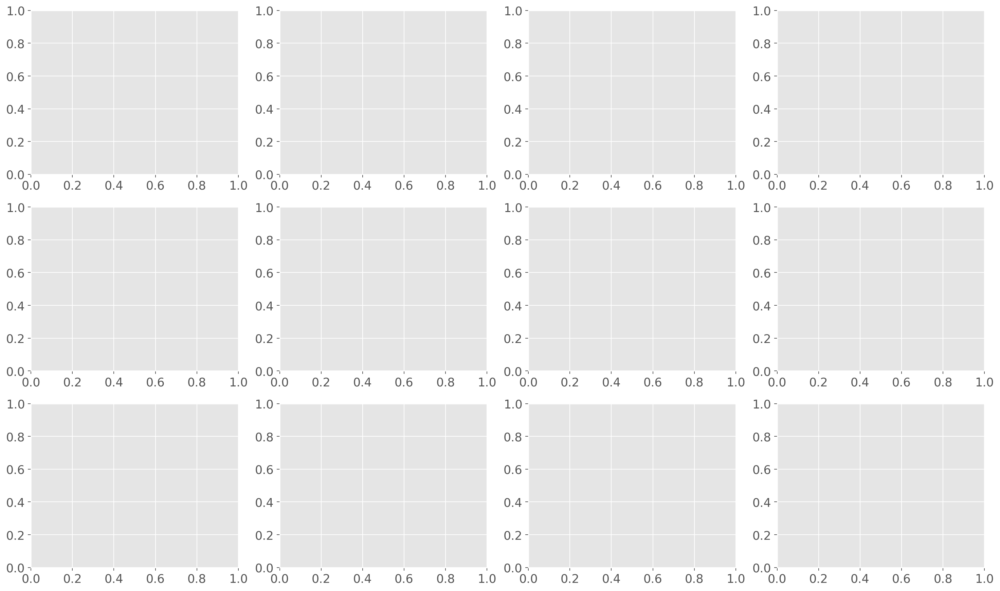

In [583]:
# scatter plot of gene expression in IgAN and control --  skip for this notebook
row = 3
col = 4
fig, axes = plt.subplots(row,col, figsize=(20,12),sharex=False, sharey=False)

for cl in iga_ab_adata.obs['Bcell_leiden_r0.5'].cat.categories:
    x = f'{cl}_ctrl'
    y = f'{cl}_igan'
    
    n = int(cl)
    j = n % col
    i = n // col
    res.loc[[x,y],non_de_dict[cl]].T.plot(kind='scatter', x=x,y=y, color='grey', ax=axes[i,j], alpha=0.5)
    res.loc[[x,y],up_dict[cl]].T.plot(kind='scatter', x=x,y=y, color='r', ax=axes[i,j])
    res.loc[[x,y],dn_dict[cl]].T.plot(kind='scatter', x=x,y=y, color='b', ax=axes[i,j])
    axes[i,j].set_ylim(0,2.5)
    axes[i,j].set_xlim(0,2.5)
    axes[i,j].set_xlabel('')
    axes[i,j].set_ylabel('')
    axes[i,j].set_title(f'cluster_{cl}')
    axes[i,j].plot([0, 2.5], [0, 2.5], transform=axes[i,j].transAxes, ls='--', color='black')

MA plot

In [ ]:
# get mean expression of genes --  skip for this notebook
clust = iga_ab_adata.obs['Bcell_leiden_r0.5'].cat.categories
rows = [f'clust{c}_mean' for c in clust]

ma_df = pd.DataFrame(columns=iga_ab_adata.var_names, index=rows)

# get mean gene expression for each cluster
for cl in iga_ab_adata.obs['Bcell_leiden_r0.5'].cat.categories:
    clst = iga_ab_adata[iga_ab_adata.obs.query('`Bcell_leiden_r0.5` == @cl').index,:]
    ma_df.loc[f'clust{cl}_mean',:] = clst.X.mean(0)
ma_df = ma_df.T
ma_df = pd.merge(ab_merge_df, ma_df, how='left', left_index=True, right_index=True)

for cl in iga_ab_adata.obs['Bcell_leiden_r0.5'].cat.categories:
    ma_df[f'clust{cl}_pvals_adj'] = -np.log10(ma_df[f'clust{cl}_pvals_adj'])

In [ ]:
# MA plot,  logfoldchange  vs  mean expression --  skip for this notebook
row = 3
col = 4
fig, axes = plt.subplots(row,col, figsize=(20,12),sharex=False, sharey=False)

for cl in iga_ab_adata.obs['Bcell_leiden_r0.5'].cat.categories:
    x = f'clust{cl}_mean'
    y = f'clust{cl}_logfoldchanges'
    
    n = int(cl)
    j = n % col
    i = n // col
    ma_df.loc[non_de_dict[cl], [x,y]].plot(kind='scatter', x=x,y=y, color='grey', ax=axes[i,j], alpha=0.5)
    ma_df.loc[up_dict[cl], [x,y]].plot(kind='scatter', x=x,y=y, color='r', ax=axes[i,j])
    ma_df.loc[dn_dict[cl], [x,y]].plot(kind='scatter', x=x,y=y, color='b', ax=axes[i,j])
    # axes[i,j].set_ylim(0,6)
    # axes[i,j].set_xlim(0,6)
    axes[i,j].set_xlabel('')
    axes[i,j].set_ylabel('')
    axes[i,j].set_title(f'cluster_{cl}')
    # axes[i,j].plot([0, 6], [0, 6], transform=axes[i,j].transAxes, ls='--', color='black')

#### 3.2.2 Marker proteins plot

In [585]:
# plot heatmap include only expressed genes
bmarker = sctool.get_cluster_markers(iga_ab_adata, 'rank_genes_groups')
bmarker_dict = {}
for i in iga_ab_adata.uns['rank_genes_groups']['names'].dtype.fields:
    bmarker_dict[i] = [g for g in bmarker[f'{i}_names'].tolist() if g in expr_10genes]
    
groups = ['0','1','5']
group_dict = {k:bmarker_dict[k][:10] for k in groups}
# sc.pl.rank_genes_groups_matrixplot(test, key='rank_genes_r0.5',cmap='Greens',groups=groups, var_names=group_dict)

    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns['dendrogram_Bcell_leiden_r0.5']`


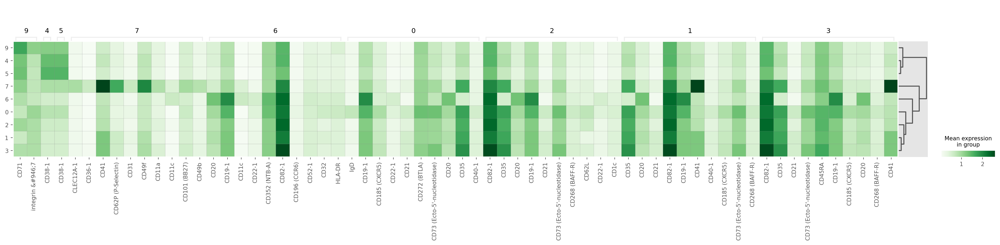

In [586]:
# protein expression at each cluster
groups = [str(i) for i in clusts]
sc.pl.rank_genes_groups_matrixplot(iga_ab_adata, n_genes=10, min_logfoldchange=0.58, key='rank_genes_groups',groups=groups, cmap='Greens')

categories: 0, 1, 2, etc.
var_group_labels: 0, 1, 5


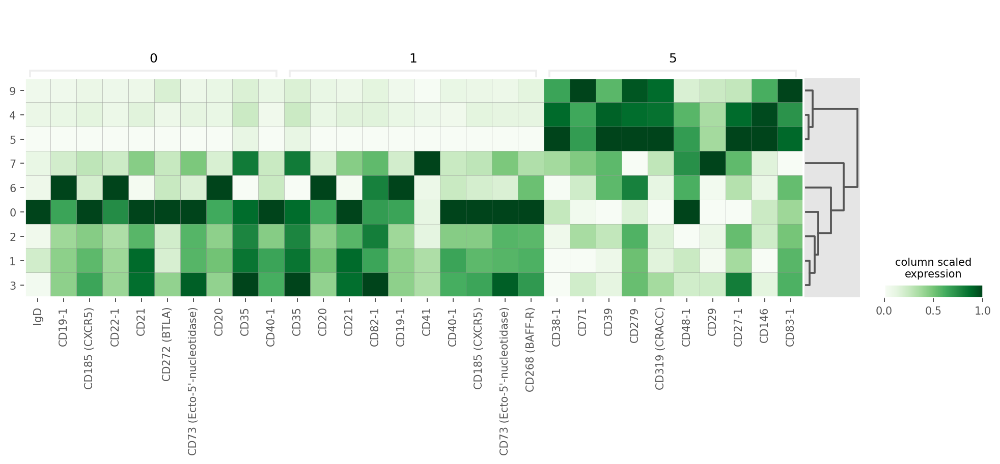

In [588]:
# protein expression at each cluster
sc.pl.rank_genes_groups_matrixplot(iga_ab_adata, n_genes=10, min_logfoldchange=0, key='rank_genes_groups',groups=['0','1','5'], cmap='Greens', standard_scale='var', colorbar_title='column scaled\nexpression')

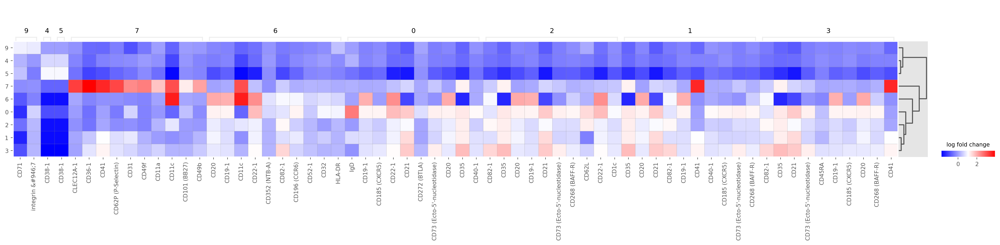

In [589]:
sc.pl.rank_genes_groups_matrixplot(iga_ab_adata, n_genes=10, min_logfoldchange=0.58, key='rank_genes_groups', 
                                   cmap='bwr', values_to_plot="logfoldchanges")

NameError: name 'non_de_dict' is not defined

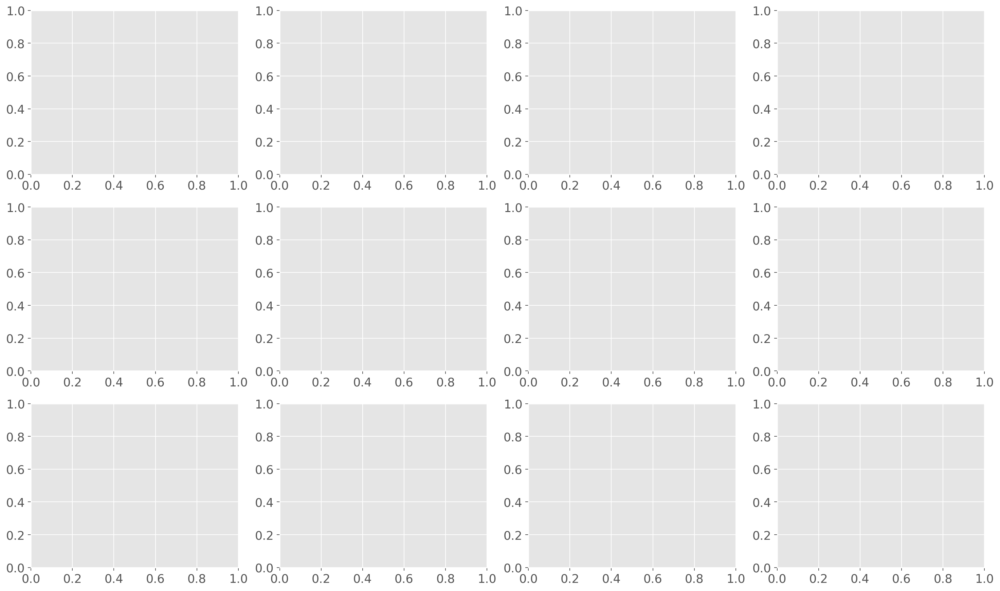

In [590]:
# MA plot,  logfoldchange  vs  mean expression
row = 3
col = 4
fig, axes = plt.subplots(row, col, figsize=(20,12),sharex=False, sharey=False)

for cl in iga_ab_adata.obs['Bcell_leiden_r0.5'].cat.categories:
    x = f'clust{cl}_control_pts'
    y = f'clust{cl}_IgAN_pts'
    
    n = int(cl)
    j = n % col
    i = n // col
    ma_df.loc[non_de_dict[cl], [x,y]].plot(kind='scatter', x=x,y=y, color='grey', ax=axes[i,j], alpha=0.5)
    ma_df.loc[up_dict[cl], [x,y]].plot(kind='scatter', x=x,y=y, color='r', ax=axes[i,j])
    ma_df.loc[dn_dict[cl], [x,y]].plot(kind='scatter', x=x,y=y, color='b', ax=axes[i,j])
    # axes[i,j].set_ylim(0,6)
    # axes[i,j].set_xlim(0,6)
    axes[i,j].set_xlabel('')
    axes[i,j].set_ylabel('')
    axes[i,j].set_title(f'cluster_{cl}')
    # axes[i,j].plot([0, 6], [0, 6], transform=axes[i,j].transAxes, ls='--', color='black')

### 3.3 BCRSeq Clonoal type analysis anlaysis

In [ ]:
b_adata = sc.read_h5ad(f'{work_dir}/inter_h5ad/b_adata_rm_Ig_vari.h5ad')
b_adata.uns['log1p']["base"] = None
b_adata.obs['cond_sp'] = b_adata.obs.apply(lambda x: x['condition'] + '_' + x['sample'].split('_')[0] ,axis=1)
b_iga_adata = b_adata[b_adata.obs.query('IgA == "IgA+"').index,:].copy()

In [ ]:
ir.pp.ir_dist(b_iga_adata)
ir.tl.define_clonotypes(b_iga_adata, receptor_arms="all", dual_ir="primary_only")

In [ ]:
ir.tl.clonotype_network(b_iga_adata, min_cells=2)

In [ ]:
ir.pl.clonotype_network(b_iga_adata, color="condition", base_size=20, label_fontsize=9, panel_size=(7, 7))

### 3.2 Calculate based on the aa sequence

In [ ]:
ir.pp.ir_dist(bcr_adata, metric="alignment", sequence="aa", cutoff=15)

In [ ]:
ir.tl.define_clonotype_clusters(bcr_adata, sequence="aa", metric="alignment", receptor_arms="all", dual_ir="any")
ir.tl.clonotype_network(bcr_adata, min_cells=3, sequence="aa", metric="alignment")

In [ ]:
ir.pl.clonotype_network(bcr_adata, color="cell_type", label_fontsize=9, panel_size=(7, 7), base_size=20)

In [ ]:
ir.pl.clonotype_network(bcr_adata, color="condition", label_fontsize=9, panel_size=(7, 7), base_size=20)

In [ ]:
ir.pl.clonotype_network(bcr_adata, color="sample", label_fontsize=9, panel_size=(7, 7), base_size=20)

In [ ]:
bcr_adata.obs['sample'].value_counts()

In [ ]:
bcr_adata.obs.loc[bcr_adata.obs["cc_aa_alignment"] == "877", :].groupby(
    [
        "IR_VJ_1_junction_aa",
        # "IR_VJ_2_junction_aa",
        "IR_VDJ_1_junction_aa",
        # "IR_VDJ_2_junction_aa",
        "receptor_subtype",
    ],
    observed=True,
).size().reset_index(name="n_cells")

In [ ]:
bcr_adata.obs.loc[bcr_adata.obs["cc_aa_alignment"] == "2706", :].groupby(
    [
        "IR_VJ_1_junction_aa",
        # "IR_VJ_2_junction_aa",
        "IR_VDJ_1_junction_aa",
        # "IR_VDJ_2_junction_aa",
        "receptor_subtype",
    ],
    observed=True,
).size().reset_index(name="n_cells")

### 3.3 Including the V-gene in clonotype definition

In [ ]:
ir.tl.define_clonotype_clusters(bcr_adata, sequence="aa", metric="alignment", receptor_arms="all", dual_ir="any", same_v_gene=True,
    key_added="cc_aa_alignment_same_v")

In [ ]:
# find clonotypes with more than one `clonotype_same_v`
ct_different_v = bcr_adata.obs.groupby("cc_aa_alignment").apply(
    lambda x: x["cc_aa_alignment_same_v"].nunique() > 1)
ct_different_v = ct_different_v[ct_different_v].index.values.tolist()
print(ct_different_v)

In [ ]:
bcr_adata.obs.loc[bcr_adata.obs["cc_aa_alignment"].isin(ct_different_v),
    [   "cc_aa_alignment",
        "cc_aa_alignment_same_v",
        "IR_VJ_1_v_call",
        "IR_VDJ_1_v_call"]].sort_values("cc_aa_alignment").drop_duplicates().reset_index(drop=True)

### 3.4 Clonal expansion

In [ ]:
ir.tl.clonal_expansion(bcr_adata)

In [ ]:
sc.pl.umap(bcr_adata, color=["clonal_expansion", "clone_id_size"])

In [ ]:
ir.pl.clonal_expansion(bcr_adata, groupby="cell_type", clip_at=4, normalize=False)

In [ ]:
mdata.write(f'{work_dir}/inter_h5ad/rna_prot_bcr.h5mu')

### Analyze genes in Glycosylation pathways
#### 1. Glycosylation genes expression in IgAN and Control
The commented commands are for directly loading the data from the saved files.

In [ ]:
# b_adata = sc.read_h5ad(f'{work_dir}/b_adata.h5ad')
# b_adata.obs['cond_sp'] = b_adata.obs.apply(lambda x: x['condition'] + '_' + x['sample'].split('_')[0] ,axis=1)
# b_iga_adata = b_adata[b_adata.obs.query('IgA == "IgA+"').index,:].copy()

b_iga_adata.obs['cond_clust'] = b_iga_adata.obs.apply(lambda x: x['condition'] + '_' + x['Bcell_leiden_r0.5'],axis=1)
b_iga_adata.obs['clust_cond'] = b_iga_adata.obs.apply(lambda x: x['Bcell_leiden_r0.5'] + '_' + x['condition'],axis=1)

In [ ]:
glyco_gene_fn = f'{work_dir}/glyco/glyco_genes.tsv'
glyco_df = pd.read_csv(glyco_gene_fn, sep='\t', header=0)
glyco_dict = {k:list(v) for k,v in glyco_df.groupby('Category')['Gene']}

In [ ]:
pathway = 'Biosynthesis of C-mannose'
glyco_genes = glyco_dict[pathway]
glyco_genes = list(set(glyco_genes).intersection(b_iga_adata.var.index))
sc.pl.matrixplot(b_iga_adata, glyco_genes, 'cond_clust', cmap='Greens', standard_scale='var', colorbar_title='column scaled\nexpression')
sc.pl.dotplot(b_iga_adata, glyco_genes, 'cond_clust', cmap='Greens',standard_scale='var', colorbar_title='column scaled\nexpression')

#### 2. GSEA

In [ ]:
glyco_gene_fn = f'{work_dir}/glyco/glyco_genes.tsv'
glyco_df = pd.read_csv(glyco_gene_fn, sep='\t', header=0)
glyco_dict = {k:list(v) for k,v in glyco_df.groupby('Category')['Gene']}

##### 2.1 GSEA: DE of scRNASeq value
gsea to test if glyco genes are enriched in DE genes between IgAN and control in each cluster using glyco pathways as database
Log2 value calculated direct

In [ ]:
# gsea_de_clust = {}
# for i in range(15):
#     cl = b_iga_adata[b_iga_adata.obs.query(f'`Bcell_leiden_r0.5`=="{i}"').index,:].copy()
#     cl.obs['condition'] = pd.Categorical(cl.obs['condition'], categories=['IgAN','control'], ordered=True)
#     indices = cl.obs.sort_values('condition').index
#     cl = cl[indices,:]
#     res = gp.gsea(data=cl.to_df().T, # row -> genes, column-> samples
#         gene_sets=glyco_dict,
#         cls=cl.obs.condition,
#         permutation_num=1000,
#         permutation_type='phenotype',
#         outdir=None,
#         method='log2_ratio_of_classes', # signal_to_noise
#         threads= 6)
#     print(f'clust{i}')
#     print(res.res2d.query('`FDR q-val` < 0.05'))
#     gsea_de_clust[str(i)] = res.res2d

##### 2.2 MAST DE prerank, MisgDB
gsea to test if glyco genes are enriched in DE genes between IgAN and control in each cluster using glyco pathways as database

gsea to test if glyco genes are enriched in each cluster using glyco pathways as database

In [ ]:
# gsea for all of the de results
mast_de_fn = f'{work_dir}/DE/Cluster_B_cells/MAST_IgA+_Bcell_clusts_igan_vs_ctrl_keep_orign_rank.tsv'
mast_de_df = pd.read_csv(mast_de_fn, sep='\t', header=0)

mast_gsea_clust = {}
mast_gsea_res = {}
sig_gsea_res = {}
for i in range(15):
    df = mast_de_df[[f'clust{i}_names',f'clust{i}_logfoldchanges']] # f'{i}_pvals', f'{i}_pvals_adj'
    df = df.sort_values(f'clust{i}_logfoldchanges', ascending=False)
    res = gp.prerank(df, 
               gene_sets= 'MSigDB_Hallmark_2020',
               outdir=None,
              permutation_num=1000,
              threads=6)
    mast_gsea_clust[str(i)] = res.res2d
    mast_gsea_res[str(i)] = res
    sig_gsea_res[str(i)] = res.res2d.query('`FDR q-val` < 0.05')

In [ ]:
for i in range(15):
    try:
        gp.dotplot(mast_gsea_res[str(i)].res2d, title=f'cluster{i}_MsigDB_hallmark',cmap='viridis_r', size=10, figsize=(3,5), cutoff=0.05,column='FDR q-val')
    except:
        pass

##### 2.3 MAST DE prerank, Glycosylation genes
gsea to test if glyco genes are enriched in DE genes between IgAN and control in each cluster using glyco pathways as database

In [ ]:
# gsea for all of the de results
mast_de_fn = f'{work_dir}/DE/Cluster_B_cells/MAST_IgA+_Bcell_clusts_igan_vs_ctrl_keep_orign_rank.tsv'
mast_de_df = pd.read_csv(mast_de_fn, sep='\t', header=0)

mast_gsea_clust = {}
mast_gsea_res = {}
sig_gsea_res = {}
for i in range(15):
    df = mast_de_df[[f'clust{i}_names',f'clust{i}_logfoldchanges']] # f'{i}_pvals', f'{i}_pvals_adj'
    df = df.sort_values(f'clust{i}_logfoldchanges', ascending=False)
    res = gp.prerank(df, 
               gene_sets= glyco_dict,
               outdir=None,
              permutation_num=1000,
              threads=6)
    mast_gsea_clust[str(i)] = res.res2d
    mast_gsea_res[str(i)] = res
    sig_gsea_res[str(i)] = res.res2d.query('`FDR q-val` < 0.05')

In [ ]:
for i in range(nclusts):
    try:
        gp.dotplot(mast_gsea_res[str(i)].res2d, title=f'cluster{i}',cmap='viridis_r', size=10, figsize=(3,5), cutoff=0.05,column='FDR q-val')
    except:
        pass

#### 3. glycosylation genes expression
Violn plot to show some glycosylation genes' expression

In [ ]:
# expression in each cluster
genes = ['C1GALT1','C1GALT1C1','B4GALT1', 'B4GALT2', 'B4GALT3', 'B4GALT4', 'ST6GALNAC2']
nrow = 3
ncol = 4
fig, axes = plt.subplots(nrow, ncol, figsize=(20,15), sharex=True, sharey=True)
for i in range(15):
    cl = b_iga_adata[b_iga_adata.obs.query(f'`Bcell_leiden_r0.5`=="{i}"').index,:]
    row = i // ncol
    col = i % ncol
    key = f'wilcoxn_IgA+_Bcell_igan_vs_ctrl_clust{i}'
    ax = sc.pl.rank_genes_groups_violin(cl, gene_names=genes, key=key,ax = axes[row,col], show=False)
    # ax[0].set_xlabel('')
    ax[0].set_title(f'cluster {i}')
    ax[0].set_ylabel('')
    axes[row, col] = ax

In [ ]:
sc.tl.rank_genes_groups(b_iga_adata, groupby='condition', ref='control',groups=['control','IgAN'], key_added='wilcoxn_all_IgAN_vs_control')

In [ ]:
genes = ['C1GALT1','C1GALT1C1','B4GALT1', 'B4GALT2', 'B4GALT3', 'B4GALT4', 'ST6GALNAC2']
fig, ax = plt.subplots(figsize=(6,6))
_ = sc.pl.rank_genes_groups_violin(b_iga_adata, gene_names=genes, key='wilcoxn_all_IgAN_vs_control', show=False, ax=ax)
ax.set_title('IgAN vs Control')

In [ ]:
genes = ['C1GALT1','C1GALT1C1','B4GALT1', 'B4GALT2', 'B4GALT3', 'B4GALT4', 'ST6GALNAC2']
test = b_iga_adata.copy()
rm_clusts = ['11', '14']
test = test[test.obs.query('`Bcell_leiden_r0.5` not in @rm_clusts').index,:]

fig, ax = plt.subplots(figsize=(6,6))
_ = sc.pl.rank_genes_groups_violin(test, gene_names=genes, key='wilcoxn_all_IgAN_vs_control', show=False, ax=ax, use_raw=False)
ax.set_title('IgAN vs Control')

In [ ]:
b_iga_adata.obs['condition'].value_counts()

# miloR
Used to calculate differential abundance between conditions.

In [592]:
import milopy
import milopy.core as milo
b_adata = sc.read_h5ad(f'{work_dir}/inter_h5ad/b_adata_rm_Ig_vari.h5ad')
b_adata.uns['log1p']["base"] = None

b_adata.obs['cond_sp'] = b_adata.obs.apply(lambda x: x['condition'] + '_' + x['sample'].split('_')[0] ,axis=1)
b_iga_adata_milo = b_adata[b_adata.obs.query('IgA == "IgA+"').index,:].copy()

In [593]:
## Build KNN graph
sc.pp.neighbors(b_iga_adata_milo, n_neighbors=10, use_rep='X_pca_harmony')
## Assign cells to neighbourhoods
milo.make_nhoods(b_iga_adata_milo)
## Count cells from each sample in each nhood
milo.count_nhoods(b_iga_adata_milo, sample_col="cond_sp")
## Test for differential abundance between conditions
milo.DA_nhoods(b_iga_adata_milo, design="~ condition")

computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:01)


In [594]:
## Check results
milo_results = b_iga_adata_milo.uns["nhood_adata"].obs
milo_results['logFC'] = - milo_results['logFC']
milo_results = pd.merge(milo_results, b_iga_adata_milo.obs[['condition','sample','cond_sp','Bcell_leiden_r0.5']], how='left', left_on='index_cell',right_index=True)

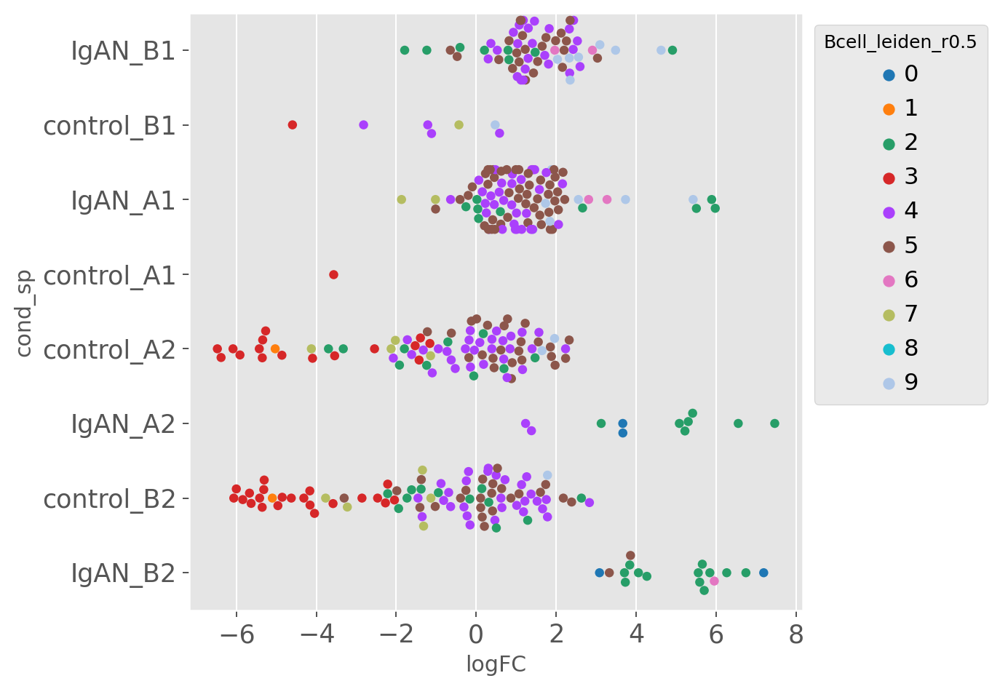

In [595]:
# ax = sb.swarmplot(data=milo_results, x="logFC", y="Bcell_leiden_r0.5",hue='cond_sp')
# sb.move_legend(ax, "upper left", bbox_to_anchor=(1, 1))

plt.figure()
color = sc.pl.palettes.default_20[:10]
# color = list(sb.color_palette().as_hex())
ax = sb.swarmplot(data=milo_results, x="logFC", y="cond_sp",hue='Bcell_leiden_r0.5',palette=color)
sb.move_legend(ax, "upper left", bbox_to_anchor=(1, 1))

# plt.figure()
# ax = sb.swarmplot(data=milo_results, x="logFC", y="sample",hue='cond_sp')
# sb.move_legend(ax, "upper left", bbox_to_anchor=(1, 1))

# 4 Analyze B cells with no IgA+
Since BCR-SEq didn't capture BCR for all of the cells, so next we check cells for B cells that don't have BCR-Seq

In [596]:
b_adata = sc.read_h5ad(f'{work_dir}/inter_h5ad/b_adata_rm_Ig_vari.h5ad')
b_adata.uns['log1p']["base"] = None
b_adata.obs['cond_sp'] = b_adata.obs.apply(lambda x: x['condition'] + '_' + x['sample'].split('_')[0] ,axis=1)
b_no_iga_adata = b_adata[b_adata.obs.query('init_cell_type == "B cell" and receptor_type != "BCR"').index,:].copy()

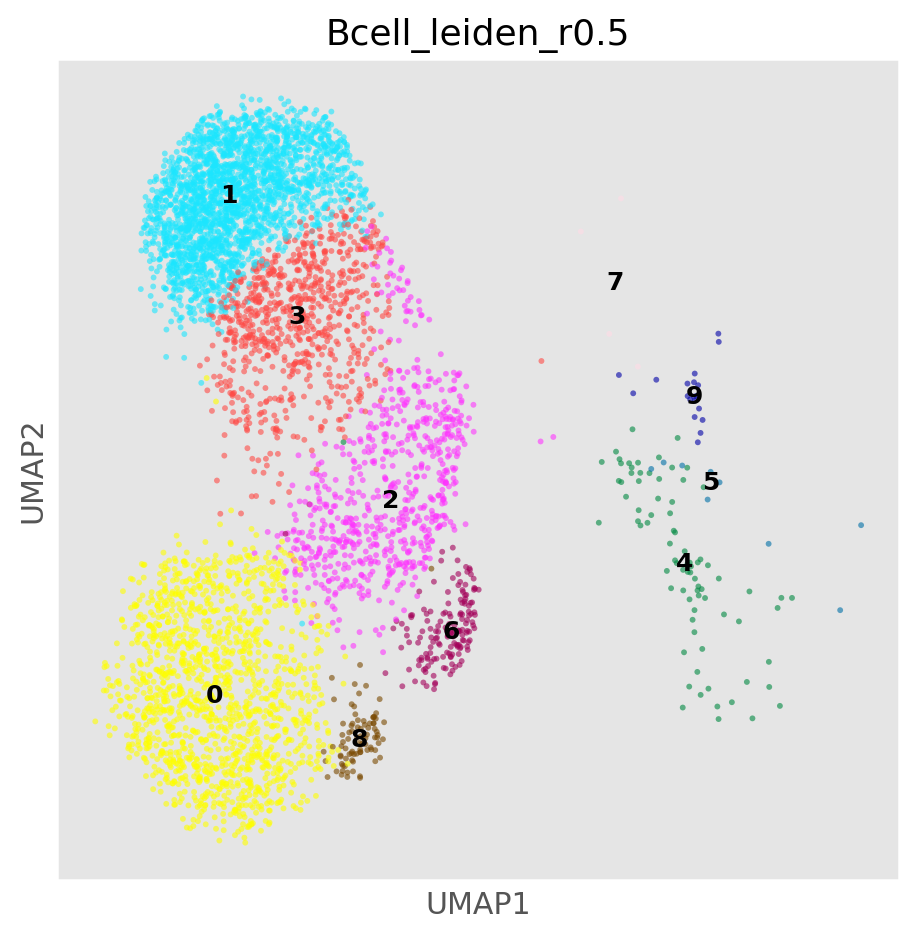

In [597]:
bcell_cluster_key = 'Bcell_leiden_r0.5'
sc.pl.umap(b_no_iga_adata, color=bcell_cluster_key, palette=sc.pl.palettes.default_102, legend_loc='on data',alpha=0.6)

In [598]:
b_no_iga_adata.obs.groupby(['sample','condition']).size().unstack().apply(lambda x: x/sum(x), axis=1).round(2)

condition,IgAN,control
sample,,
A1,0.31,0.69
A2,0.59,0.41
B1,0.33,0.67
B2,0.74,0.26


<Axes: xlabel='sample'>

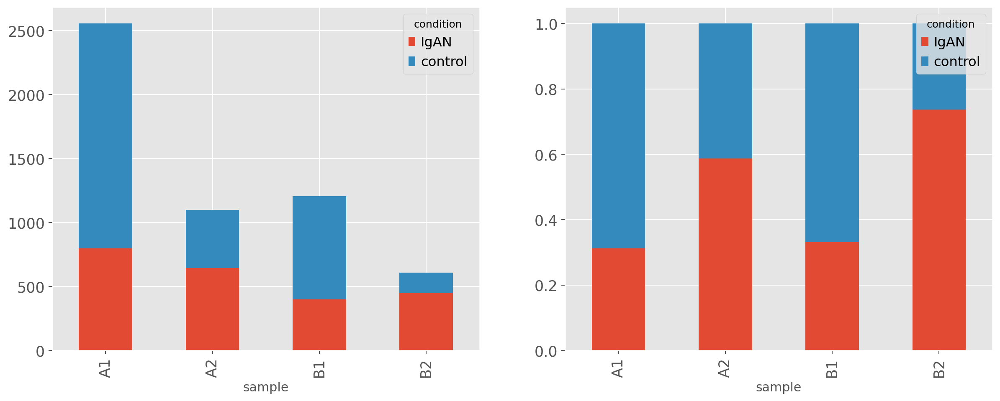

In [599]:
fig, axes = plt.subplots(1,2, figsize=(16,6))
b_no_iga_adata.obs.groupby(['sample','condition']).size().unstack().plot(kind='bar',stacked=True, ax=axes[0])
b_no_iga_adata.obs.groupby(['sample','condition']).size().unstack().apply(lambda x: x/sum(x), axis=1).plot(kind='bar',stacked=True, ax=axes[1])

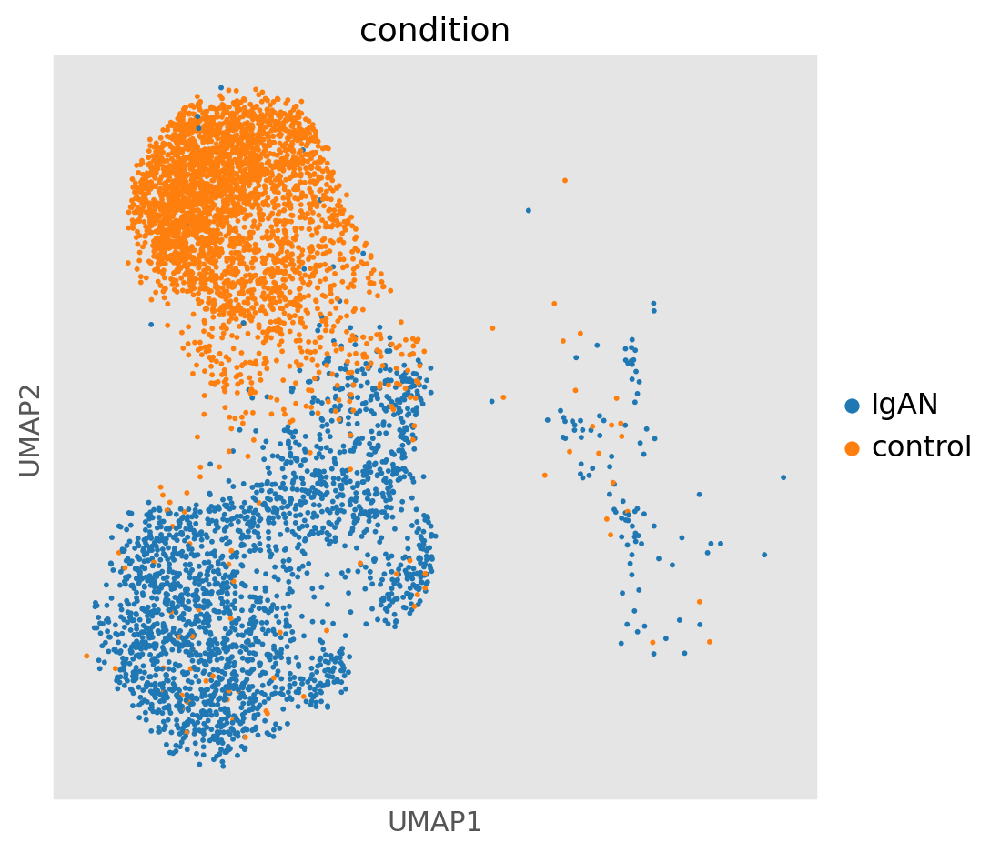

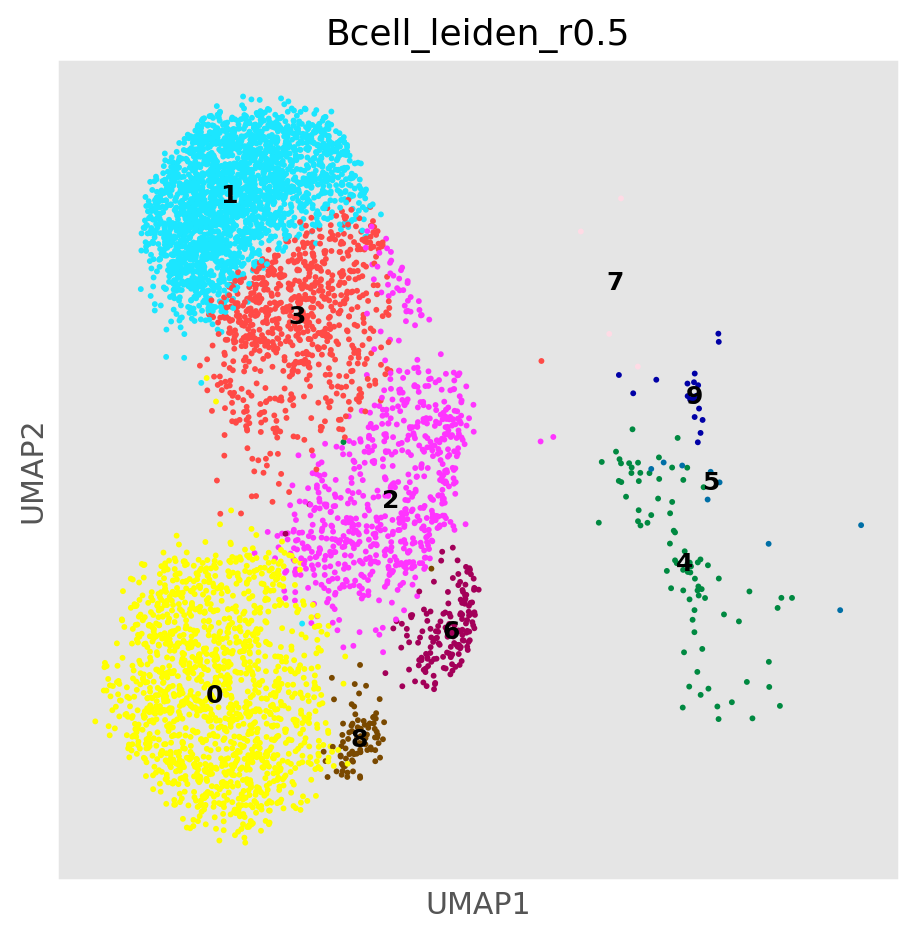

In [600]:
sc.pl.umap(b_no_iga_adata, color=['condition'], palette=sc.pl.palettes.default_20)
sc.pl.umap(b_no_iga_adata, color=[bcell_cluster_key], palette=sc.pl.palettes.default_102, legend_loc='on data')

Text(0.5, 1.0, 'cell distribution across cluster & condition')

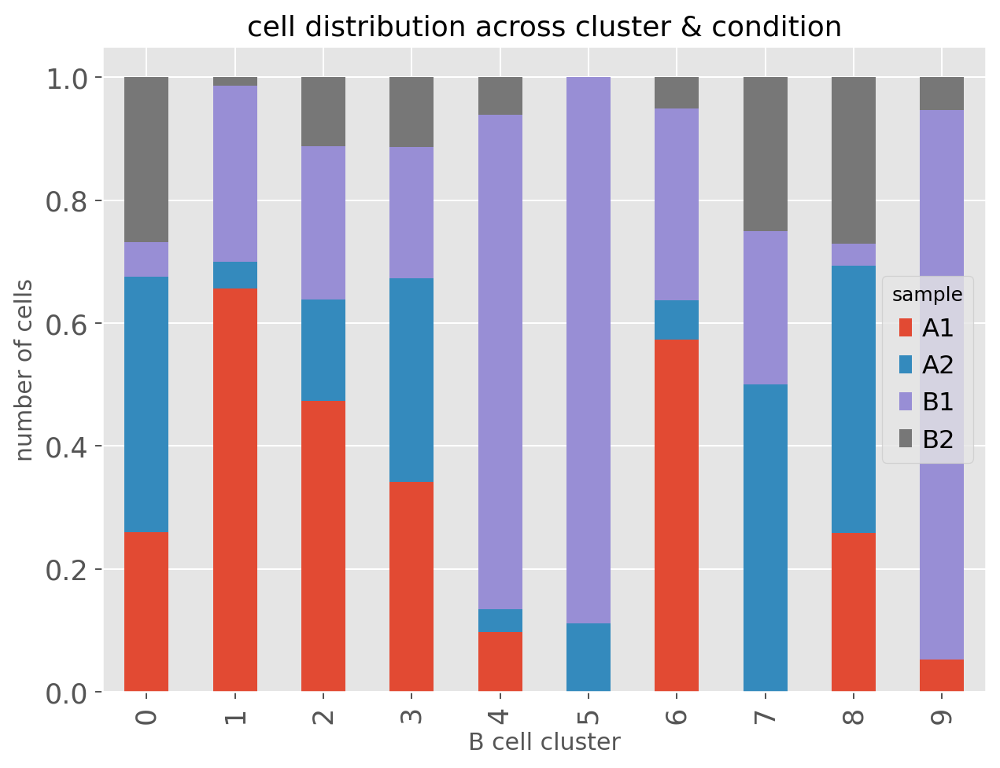

In [601]:
# ax = b_iga_adata.obs.groupby(['Bcell_leiden_r0.5','condition']).size().unstack().plot(kind='bar',stacked=True, figsize=(8,6))
ax = b_no_iga_adata.obs.groupby([bcell_cluster_key,'sample']).size().unstack().apply(lambda x: x/sum(x),axis=1).plot(kind='bar',stacked=True, figsize=(8,6))
ax.set_xlabel('B cell cluster')
ax.set_ylabel('number of cells')
ax.set_title('cell distribution across cluster & condition')

<Axes: xlabel='Bcell_leiden_r0.5'>

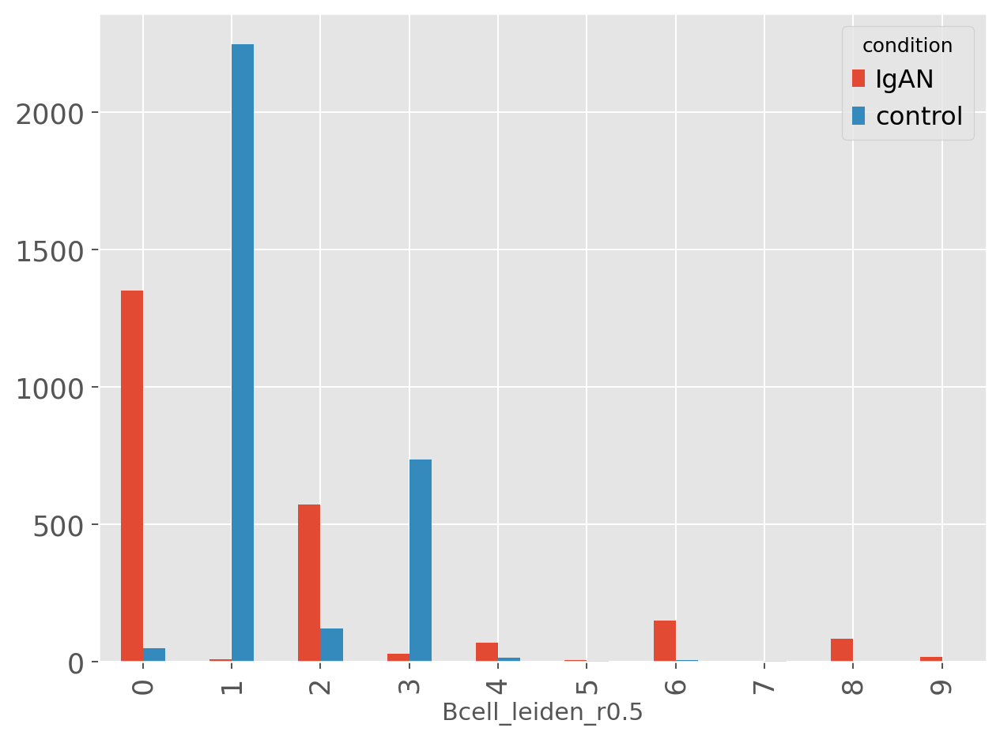

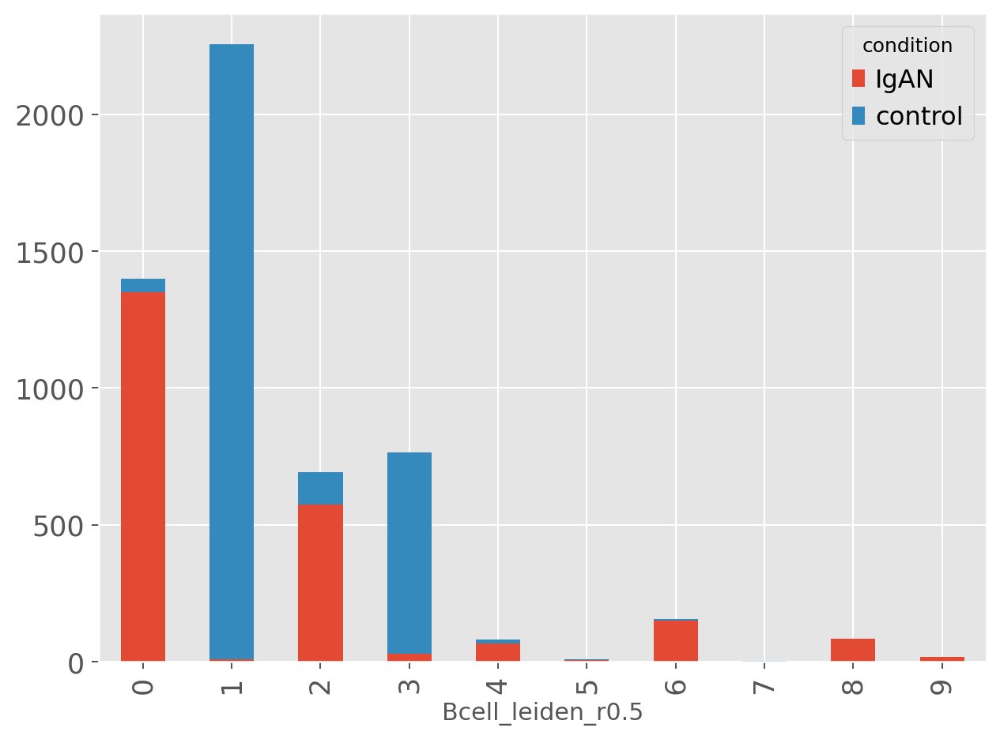

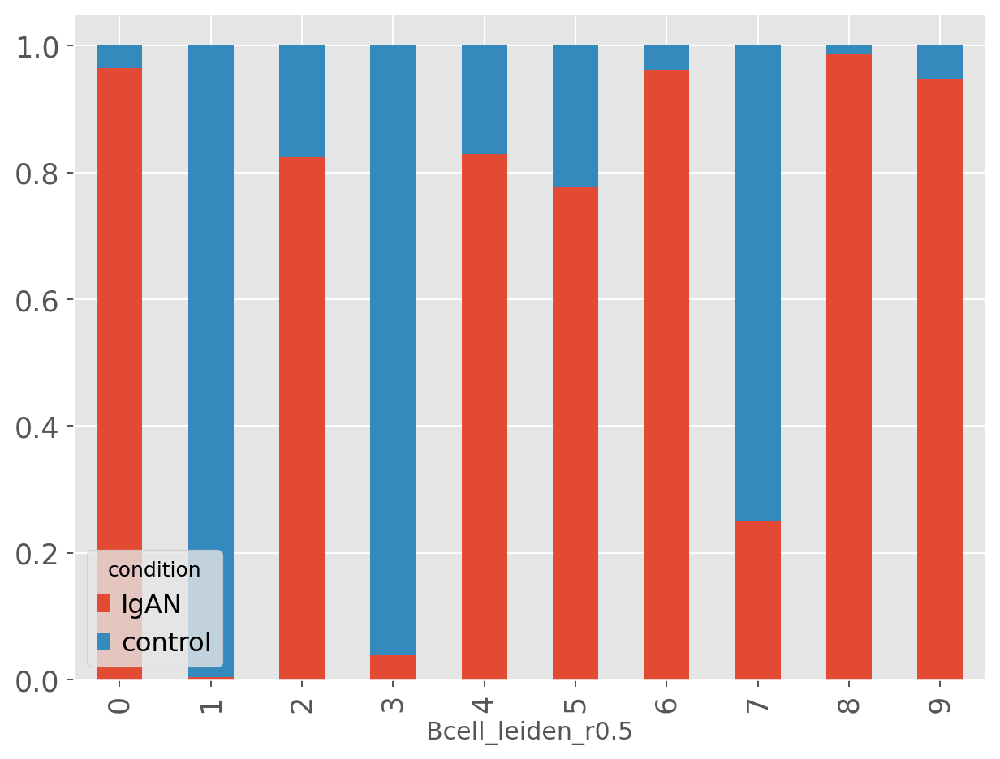

In [602]:
b_no_iga_adata.obs.groupby(['Bcell_leiden_r0.5','condition']).size().unstack().plot(kind='bar',figsize=(8,6))
b_no_iga_adata.obs.groupby(['Bcell_leiden_r0.5','condition']).size().unstack().plot(kind='bar',stacked=True, figsize=(8,6))
b_no_iga_adata.obs.groupby(['Bcell_leiden_r0.5','condition']).size().unstack().apply(lambda x: x/sum(x) , axis=1).plot(kind='bar', stacked=True, figsize=(8,6))

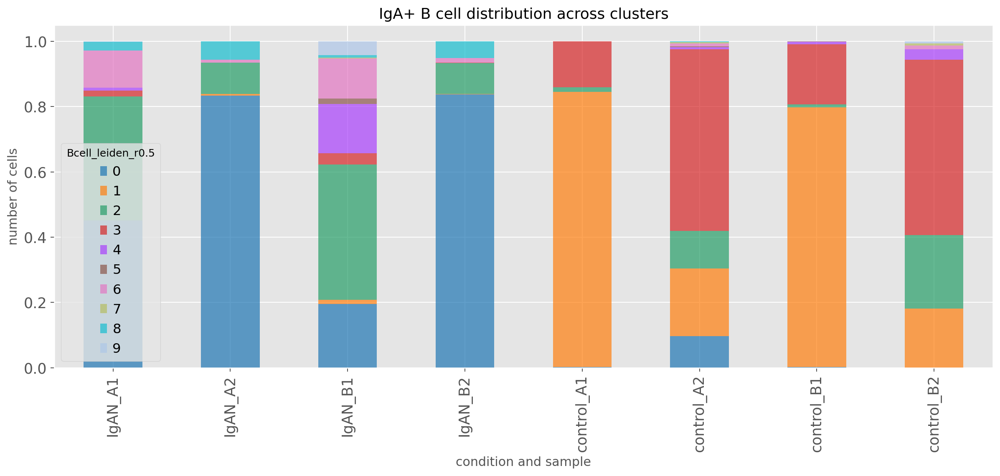

In [603]:
portion_df = b_no_iga_adata.obs.groupby(['cond_sp', 'Bcell_leiden_r0.5']).size().unstack().apply(lambda x: x/sum(x),axis=1)
color = sc.pl.palettes.default_20[:10] # sb.color_palette("tab20")  
ax = portion_df.plot(kind='bar',stacked=True, figsize=(16,6), color=color, alpha=0.7)
ax.set_xlabel('condition and sample')
ax.set_ylabel('number of cells')
ax.set_title('IgA+ B cell distribution across clusters')
portion_df = portion_df.T

### miloR

In [604]:
import milopy
import milopy.core as milo
b_adata = sc.read_h5ad(f'{work_dir}/inter_h5ad/b_adata_rm_Ig_vari.h5ad')
b_adata.uns['log1p']["base"] = None
b_adata.obs['cond_sp'] = b_adata.obs.apply(lambda x: x['condition'] + '_' + x['sample'].split('_')[0] ,axis=1)
b_no_iga_adata_milo = b_adata[b_adata.obs.query('init_cell_type == "B cell" and receptor_type != "BCR"').index,:]
milor = b_adata.copy()

In [605]:
## Build KNN graph
sc.pp.neighbors(milor, n_neighbors=10, use_rep='X_pca_harmony')
## Assign cells to neighbourhoods
milo.make_nhoods(milor)
## Count cells from each sample in each nhood
milo.count_nhoods(milor, sample_col="cond_sp")
## Test for differential abundance between conditions
milo.DA_nhoods(milor, design="~ condition")

computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:03)


In [606]:
milo_res = milor.uns["nhood_adata"].obs
milo_res['logFC'] = - milo_res['logFC']
milo_res = pd.merge(milo_res, b_no_iga_adata_milo.obs[['condition','sample','cond_sp','Bcell_leiden_r0.5']], how='inner', left_on='index_cell',right_index=True)

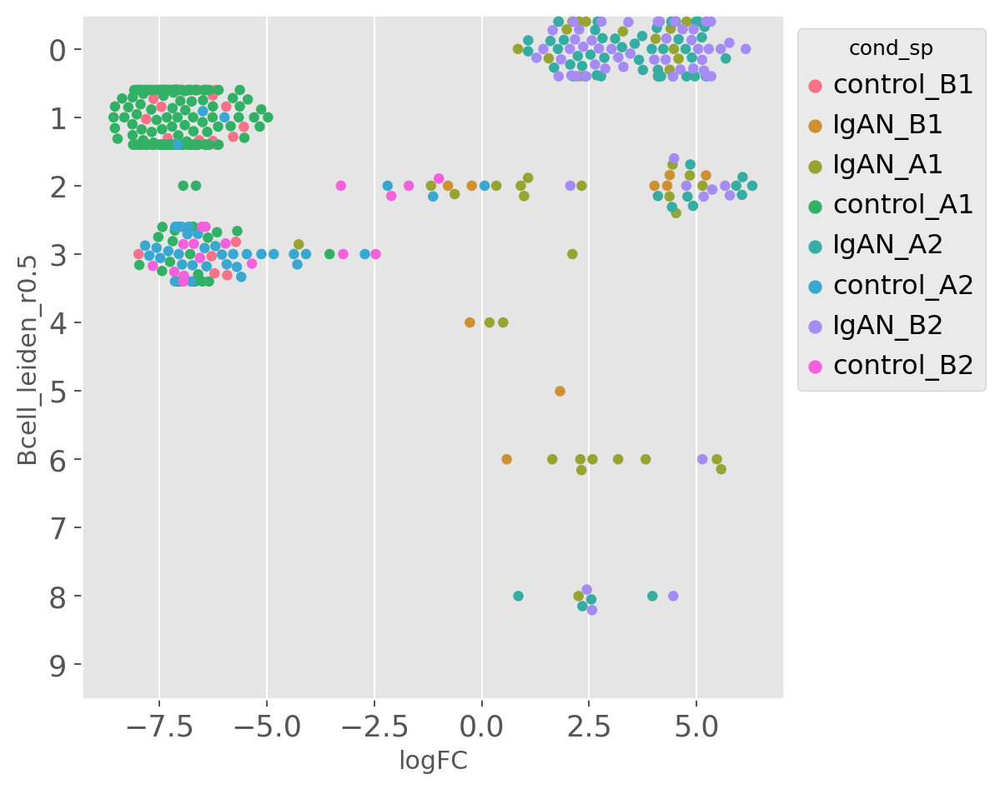

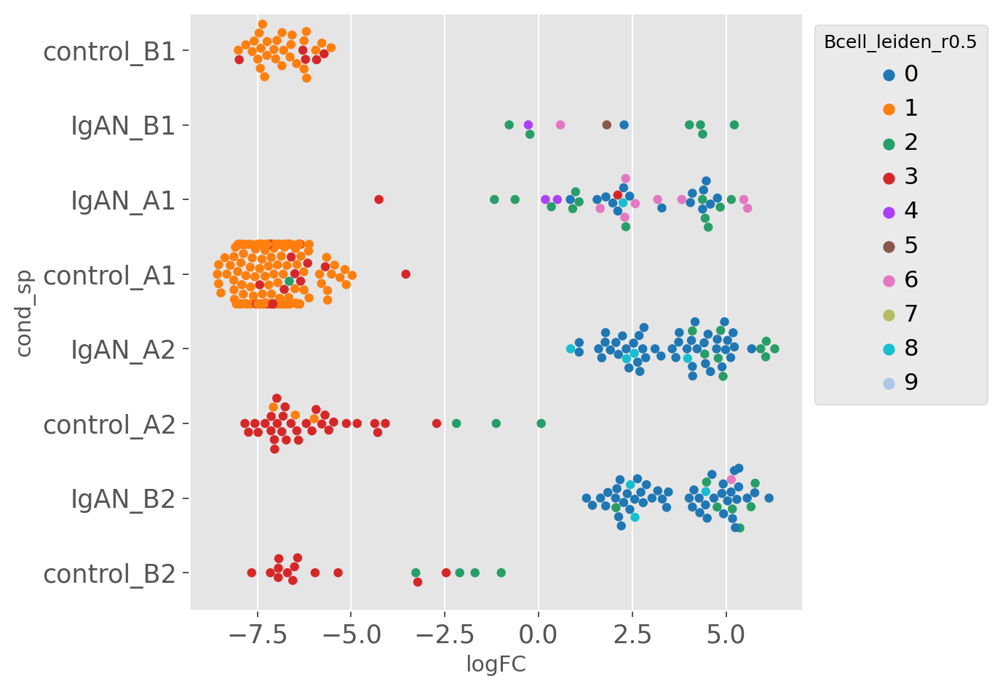

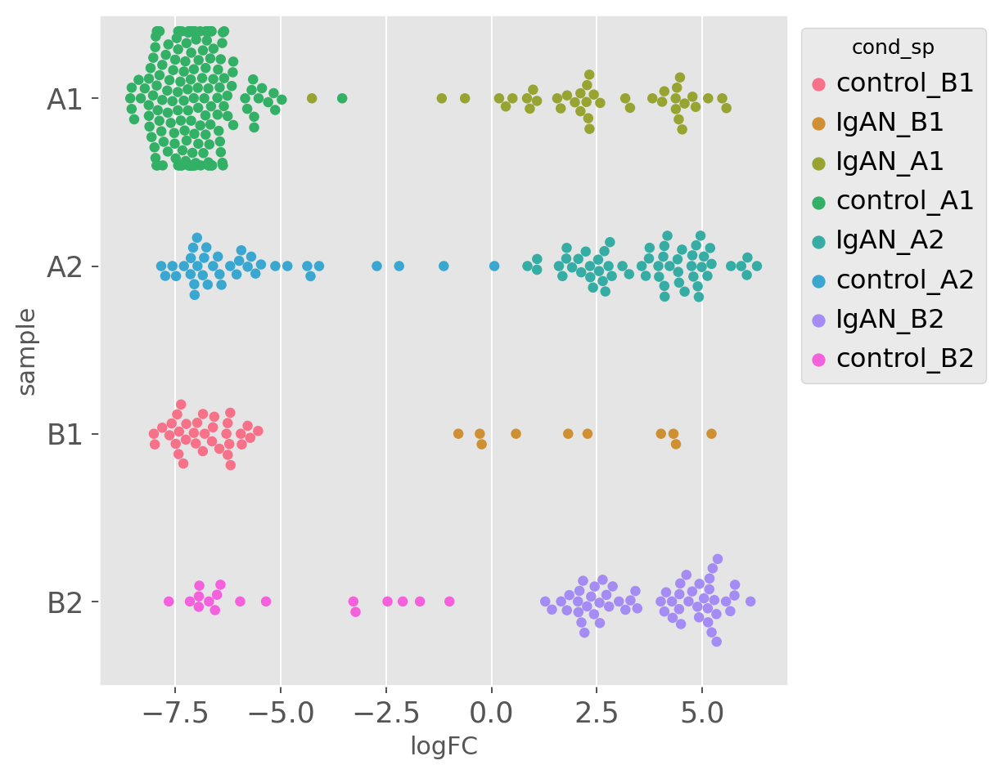

In [607]:
ax = sb.swarmplot(data=milo_res, x="logFC", y="Bcell_leiden_r0.5",hue='cond_sp')
sb.move_legend(ax, "upper left", bbox_to_anchor=(1, 1))

plt.figure()
color = sc.pl.palettes.default_20[:10]
# color = list(sb.color_palette().as_hex())
ax = sb.swarmplot(data=milo_res, x="logFC", y="cond_sp",hue='Bcell_leiden_r0.5',palette=color)
sb.move_legend(ax, "upper left", bbox_to_anchor=(1, 1))

plt.figure()
ax = sb.swarmplot(data=milo_res, x="logFC", y="sample",hue='cond_sp')
sb.move_legend(ax, "upper left", bbox_to_anchor=(1, 1))